<a href="https://colab.research.google.com/github/innovateDotAI/outlier_system/blob/main/2DCNN-AE_for-snap.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# In this notebook we will directly use TS data  to detect anamolies in given snapshot using 2DCNN-AE

# 1. Load the Library

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
np.set_printoptions(precision=3, suppress=True)

# 2. Load the data and One Hot Encoding

In [ ]:
def rawDataload_TWF():
# Load data from UCI and retrun TS as pandas and list of indexes where failure happends in mfList
  #Data loading and keeping one type of failure
  #First download and import the dataset using pandas:
  import pandas as pd
  url = 'https://archive.ics.uci.edu/ml/machine-learning-databases/00601/ai4i2020.csv'
  #column_names = ['MPG', 'Cylinders', 'Displacement', 'Horsepower', 'Weight',
                  #'Acceleration', 'Model Year', 'Origin']
  col_name = ['UID','PID','Type','airTemp','processTemp','rotationalSpeed','torque','toolwear','machineFailure','TWF','HDF','PWF','OSF','RNF']
  raw_dataset = pd.read_csv(url, names=col_name,
                            na_values='?', comment='\t',
                            sep=',', skipinitialspace=True,header=0)
  #Drop those rows which will not be part of feature vector:
  rawData = raw_dataset.copy()
  # Create Inliear dataset without any kind of failure
  rawDataInlier = raw_dataset.copy()
  rawDataInlier = rawDataInlier[rawDataInlier["machineFailure"] == 0]
  rawDataInlier.drop(['UID','PID','machineFailure','HDF','OSF','PWF','RNF','TWF'], axis = 1, inplace = True)
  rawDataInlier_oneHot = pd.get_dummies(rawDataInlier, columns=["Type"], prefix=["Type_is"] )

  # Create outlier dataset
  rawDataOutlier = raw_dataset.copy()
  rawDataOutlier = rawDataOutlier[rawDataOutlier["TWF"] == 1]
  rawDataOutlier.drop(['UID','PID','machineFailure','HDF','OSF','PWF','RNF','TWF'], axis = 1, inplace = True)
  rawDataOutlier_oneHot = pd.get_dummies(rawDataOutlier, columns=["Type"], prefix=["Type_is"] )
  return rawDataInlier_oneHot,rawDataOutlier_oneHot,raw_dataset

In [ ]:
def rawDataload_TWF_win():
# Load data from UCI and retrun TS as pandas and list of indexes where failure happends in mfList
  #Data loading and keeping one type of failure
  #First download and import the dataset using pandas:
  import pandas as pd
  url = 'https://archive.ics.uci.edu/ml/machine-learning-databases/00601/ai4i2020.csv'
  #column_names = ['MPG', 'Cylinders', 'Displacement', 'Horsepower', 'Weight',
                  #'Acceleration', 'Model Year', 'Origin']
  col_name = ['UID','PID','Type','airTemp','processTemp','rotationalSpeed','torque','toolwear','machineFailure','TWF','HDF','PWF','OSF','RNF']
  raw_dataset = pd.read_csv(url, names=col_name,
                            na_values='?', comment='\t',
                            sep=',', skipinitialspace=True,header=0)
  #Drop those rows which will not be part of feature vector:
  rawData = raw_dataset.copy()
  # Create raw dataset with only TWF failure and noraml data
  rawData_twf =rawData[(rawData['machineFailure'] == 0) | (rawData['TWF'] == 1)]
  rawData_twf.drop(['UID','PID','machineFailure','HDF','OSF','PWF','RNF'], axis = 1, inplace = True)
  # generate binary values using get_dummies
  raw_dataset_twf_oneHot = pd.get_dummies(rawData_twf, columns=["Type"], prefix=["Type_is"] )
  # Generate failure points:
  rawTS = raw_dataset_twf_oneHot.reset_index(drop=True)
  mfList = rawTS.index[rawTS['TWF'] == 1].tolist()
  return rawTS,mfList

# Train and Test data generation

In [ ]:
def TrainTestData(b1,rawTS,mfList):
  import numpy as np
  raw_np = rawTS.values
  #print("Input shape of rawTS:",raw_np.shape)
  #print("Input mfList values:",mfList)
  X_test = np.empty((0,raw_np.shape[1]), np.float32)
  # Training dataset creation based on windows size
  # initialize outlier data:
  for i in mfList:
    X_test = np.append(X_test, raw_np[i-b1+1:i+1], axis=0)
  #print(X_test.shape)
  X_train = np.copy(raw_np)
  indexList = []
  for i in mfList:
    #print("Index value i:",i)
    tmp = [i for i in range(i-b1+1,i+1)]
    X= [indexList.append(j) for j in tmp]
  
  #print("Index List:",indexList)
  X_train = np.delete(X_train, indexList, axis=0)
  #print("Shape of X_train after deletion:",X_train.shape)
  #Split features from labels
  #The pop() method removes the specified column from the DataFrame. The pop() method returns the removed columns as a Pandas Series object.
  Y_train = np.copy(X_train)
  Y_test = np.copy(X_test)
  XPopIndex = [5] # Lable value which needs to remove from matrix to generate feature 
  YPopIndex = [0,1,2,3,4,6,7,8] # All featrues index value which needs to be removed.
  X_train = np.delete(X_train, XPopIndex, axis=1)
  X_test = np.delete(X_test, XPopIndex, axis=1)
  Y_train = np.delete(Y_train, YPopIndex, axis=1) # Removing label from Traning_set data
  Y_test = np.delete(Y_test, YPopIndex, axis=1)
  return X_train ,Y_train, X_test,Y_test

In [ ]:
import numpy as np
def TS_window(b,n,TS_C):
  # Function Module to convet TS into Sliding wondows based TS
  # b = window size
  #n = number of features in given TS data
  # TS_C = Normalized TS data

  i = 0
  TS_G = np.empty((0,b,n), np.float32)  
  for w in range(0,len(TS_C),int(b)):
    #count+=1
    #print("windows")  
    win = np.empty((0,n), np.float32)
    for i in range(b):
      try:
      #print("feature vector",w+i,"Values are:",X_train_scaled[w+i])
        win = np.append(win, np.array([TS_C[w+i]]), axis=0)
      except:
        continue
    if win.shape[0] == b:
      TS_G = np.append(TS_G, np.array([win]), axis=0)
  return TS_G

# 2DCNN_AE Model

In [ ]:
def m2_2dcnnae_single_conv(train,e):
  # single layerd CNN AE
  import tensorflow as tf
  from tensorflow import keras
  from keras import layers
  from tensorflow.keras import regularizers
  tf.keras.backend.clear_session()
  callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=3)
  input = keras.Input(shape=(train.shape[1],train.shape[2],1),name='Conv_deconv_singleLayer')
  x_enc = layers.Conv2D(32,kernel_size=(1,3),data_format='channels_last',activation = 'relu',use_bias=True)(input)
  x_enc = layers.Conv2D(128,kernel_size=(1,3),data_format='channels_last',activation = 'relu',use_bias=True)(x_enc)
  encoder = layers.Conv2D(256*2,kernel_size=(1,3),data_format='channels_last',activation = 'relu',use_bias=True)(x_enc)
  x_dec = layers.Conv2DTranspose(128,kernel_size=(1,3),data_format='channels_last',activation = 'relu',use_bias=True)(encoder)
  x_dec = layers.Conv2DTranspose(32,kernel_size=(1,3),data_format='channels_last',activation = 'relu',use_bias=True)(x_dec)
  decoder = layers.Conv2DTranspose(1,data_format='channels_last',activation = 'relu',kernel_size=(1,3))(x_dec)
  model = keras.Model(input,decoder)
  model.compile(optimizer='adam',loss='mean_squared_error')
  history = model.fit(train,train,
                    epochs = e,
                    validation_split = 0.2,
                    shuffle=True,
                    verbose=1,
                    callbacks=[callback]
                    )
    
  return model,history

In [ ]:
def m3_2dcnnae_single_conv(train,e):
  # single layerd CNN AE
  import tensorflow as tf
  from tensorflow import keras
  from keras import layers
  from tensorflow.keras import regularizers
  tf.keras.backend.clear_session()
  callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=3)
  input = keras.Input(shape=(train.shape[1],train.shape[2],1),name='Deconv_Conv_AE')
  #x = layers.Conv2DTranspose(16,data_format='channels_last',activation = 'relu',kernel_size=(1,5),kernel_regularizer=regularizers.L2(l2=0.00001))(input)
  x = layers.Conv2DTranspose(1,data_format='channels_last',activation = 'relu',kernel_size=(3,5))(input)
  y = layers.Conv2D(1,kernel_size=(3,5),data_format='channels_last',activation = 'relu',use_bias=True)(x)
  model = keras.Model(input,y)
  model.compile(optimizer='adam',loss='mean_squared_error')
  history = model.fit(train,train,
                    epochs = e,
                    validation_split = 0.2,
                    shuffle=True,
                    verbose=0,
                    callbacks=[callback]
                    )
    
  return model,history

# Model Acurracy Plotting

In [ ]:
def plt_model_accuracy(history):
  # Plot the graphs
  import matplotlib.pyplot as plt
  # Increase size of plot in jupyter

  plt.rcParams["figure.figsize"] = (16,5.5)  
  # list all data in history
  print(history.history.keys())
  # summarize history for accuracy
  #acc = list(history.history.keys())[2]
  #val_acc = list(history.history.keys())[3]
  loss = list(history.history.keys())[0]
  val_loss = list(history.history.keys())[1]
  # plt.plot(history.history[acc])
  # plt.plot(history.history[val_acc])
  # plt.title('recreation accuracy')
  # plt.ylabel('accuracy')
  # plt.xlabel('epoch')
  # plt.legend(['train', 'test'], loc='upper left')
  # plt.show()
  # summarize history for loss
  plt.plot(history.history[loss])
  plt.plot(history.history[val_loss])
  plt.title('recreation loss')
  plt.ylabel('loss')
  plt.xlabel('epoch')
  plt.legend(['train', 'test'], loc='upper left')
  plt.show()

# Model Analysis

In [ ]:
def model_analysis(train_2,X_test_2,MODEL1):
  import matplotlib.pyplot as plt
  data = train_2
  #data = X_test_2
  y_pred = MODEL1.predict(data)
  y_true = data
  loss=tf.keras.losses.MeanSquaredError()
  inlier_lst= []
  for i in range(len(data)):
    max_val = loss(y_true[i], y_pred[i]).numpy()
    inlier_lst.append(max_val)

  print("Intlier max value:",max(inlier_lst),"Index Val:",inlier_lst.index(max(inlier_lst)))
  data = X_test_2
  outlier_lst = []
  y_pred = MODEL1.predict(data)
  y_true = data
  loss=tf.keras.losses.MeanSquaredError()
  for i in range(len(data)):
    max_val = loss(y_true[i], y_pred[i]).numpy()
    outlier_lst.append(max_val)

  print("outlier max value:",max(outlier_lst),"Index Val:",outlier_lst.index(max(outlier_lst)))
  print("outlier min value:",min(outlier_lst),"Index Val:",outlier_lst.index(min(outlier_lst)))
  # plotting
  plt.figure(figsize=(50,10))
  plt.title("Recreation error graph")
  plt.xlabel("X axis")
  plt.ylabel("Y axis")
  plt.plot(np.array(inlier_lst), color ="green")
  plt.plot(np.array(outlier_lst), color ="red")
  plt.show()
  return inlier_lst,outlier_lst

# Confusion matrix generation

In [ ]:
def confusionMatrix(oc,inlier_lst,outlier_lst):
  Inclass_lable = {}
  Outclass_lable = {}
  count = 0
  print("Total member in inlear:",len(inlier_lst))
  y_pred = []
  for i in range(len(inlier_lst)):
    if oc < inlier_lst[i]:
      y_pred.append(1)
      count+=1
    else:
      y_pred.append(0)   
  print("Total False alarm:",count)
  count=0
  print("Total member in Outlier:",len(outlier_lst))
  for i in range(len(outlier_lst)):
    if oc > outlier_lst[i]:
      y_pred.append(0)
      count+=1
    else:
      y_pred.append(1) 
  print("Total missed true alarm:",count)
  y_true = [0]*len(inlier_lst)+[1]*len(outlier_lst)
  #Check the classification model strength
  from sklearn.metrics import classification_report
  target_names = ['0','1'] # Need to automate this step later
  y_true_labled = np.array(y_true)
  y_pred_labled = np.array(y_pred)
  #y_predict_ana = yhat_test.astype('int64')
  #print(classification_report(np.array(test_labels.astype('float32'))), test_predictions, target_names=target_names))
  cm = classification_report(y_true_labled, y_pred_labled, target_names=target_names,output_dict=True)
  print(classification_report(y_true_labled, y_pred_labled, target_names=target_names))
  # Note: Precision: TP/(Total predicted positves) , Recall = TP/(Total Actual positves)
  import matplotlib.pyplot as plt
  import numpy
  from sklearn import metrics
  confusion_matrix = metrics.confusion_matrix(y_true_labled, y_pred_labled)
  cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = [False, True])

  cm_display.plot()
  plt.show()
  return cm

In [ ]:
# def confusionMatrix(oc,inlier_lst,outlier_lst):
#   Inclass_lable = {}
#   Outclass_lable = {}
#   count = 0
#   print("Total member in inlear:",len(inlier_lst))
#   y_pred = []
#   for i in range(len(inlier_lst)):
#     if oc < inlier_lst[i]:
#       y_pred.append(1)
#       count+=1
#     else:
#       y_pred.append(0)   
#   print("Total False alarm:",count)
#   count=0
#   print("Total member in Outlier:",len(outlier_lst))
#   for i in range(len(outlier_lst)):
#     if oc > outlier_lst[i]:
#       y_pred.append(0)
#       count+=1
#     else:
#       y_pred.append(1) 
#   print("Total missed true alarm:",count)
#   y_true = [0]*len(inlier_lst)+[1]*len(outlier_lst)
#   #Check the classification model strength
#   from sklearn.metrics import classification_report
#   target_names = ['0','1'] # Need to automate this step later
#   y_true_labled = np.array(y_true)
#   y_pred_labled = np.array(y_pred)
#   #y_predict_ana = yhat_test.astype('int64')
#   #print(classification_report(np.array(test_labels.astype('float32'))), test_predictions, target_names=target_names))
#   cm = classification_report(y_true_labled, y_pred_labled, target_names=target_names,output_dict=True)
#   print(classification_report(y_true_labled, y_pred_labled, target_names=target_names))
#   # Note: Precision: TP/(Total predicted positves) , Recall = TP/(Total Actual positves)
#   return cm

In [ ]:
import tensorflow as tf
from tensorflow import keras
from keras import layers
from tensorflow.keras import regularizers
import numpy as np
e = 1000
# Load the training and test data
train_inlear_all, test_outlier_all,rd = rawDataload_TWF()
train_inlear = train_inlear_all
test_outlier = test_outlier_all
# amplify the diffrences 
trn = np.power(train_inlear.values, 3)
tst = np.power(test_outlier.values, 3)

# nomalize by dividing max value of train matrix
max_value = np.max(trn)
print(max_value)
trainN = (trn/max_value)*max_value
testN = (tst/max_value)*max_value

# Generate and train the model
train_2 = trainN.reshape(len(trainN),1,8,1)

19573852375.0


# Main python body

## Tool Wear failure(TWF) machine failure analysis usning UnderComplete CNN-AE over snaphot of data

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4913: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


[ 304.5  313.8 2695.    70.   246.     1.     1.     1. ]
Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).
Epoch 1/200
24/24 [==============================] - 3s 89ms/step - loss: 0.1761 - val_loss: 0.0612
Epoch 2/200
24/24 [==============================] - 2s 81ms/step - loss: 0.0306 - val_loss: 0.0061
Epoch 3/200
24/24 [==============================] - 2s 80ms/step - loss: 0.0021 - val_loss: 5.2610e-04
Epoch 4/200
24/24 [==============================] - 2s 84ms/step - loss: 2.9042e-04 - val_loss: 1.6808e-04
Epoch 5/200
24/24 [==============================] - 2s 83ms/step - loss: 1.1663e-04 - val_loss: 1.1245e-04
Epoch 6/200
24/24 [==============================] - 2s 82ms/step - loss: 7.7191e-05 - val_loss: 6.6958e-05
Epoch 7/200
24/24 [==============================] - 2s 83ms/step - loss: 5.6279e-05 - val_loss: 5.4626e-05
Epoch 8/200
24/24 [==============================] - 2s 82ms/step - loss: 4

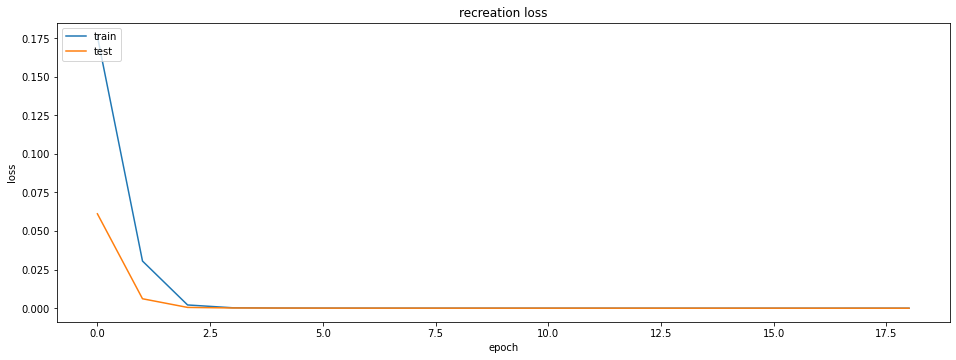

Intlier max value: 4.4738015e-05 Index Val: 56
outlier max value: 5.2251773e-05 Index Val: 24
outlier min value: 6.3307552e-06 Index Val: 7


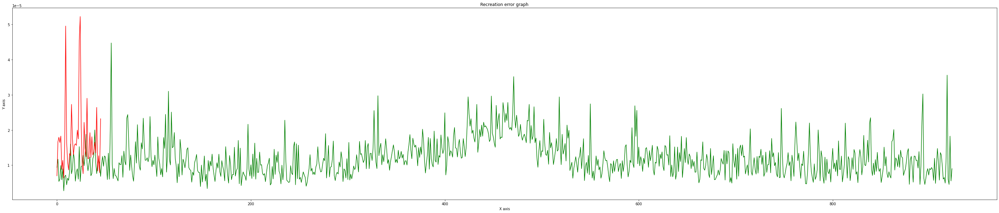

Total member in inlear: 924
Total False alarm: 823
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.99      0.11      0.20       924
           1       0.05      0.98      0.10        46

    accuracy                           0.15       970
   macro avg       0.52      0.54      0.15       970
weighted avg       0.95      0.15      0.19       970



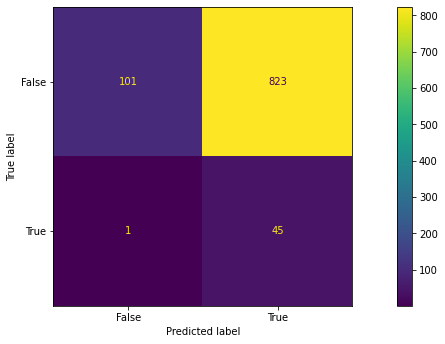

trecall_max: 0.10930735930735931 frecall_max: 0.9782608695652174 Count: 1


INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Outlier_model/cnn_m2_undercomplete/assets


INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Outlier_model/cnn_m2_undercomplete/assets


Epoch 1/200
24/24 [==============================] - 3s 92ms/step - loss: 0.1518 - val_loss: 0.0285
Epoch 2/200
24/24 [==============================] - 2s 85ms/step - loss: 0.0120 - val_loss: 0.0023
Epoch 3/200
24/24 [==============================] - 2s 84ms/step - loss: 9.4177e-04 - val_loss: 3.3005e-04
Epoch 4/200
24/24 [==============================] - 2s 83ms/step - loss: 2.1652e-04 - val_loss: 1.6654e-04
Epoch 5/200
24/24 [==============================] - 2s 86ms/step - loss: 1.2275e-04 - val_loss: 9.4767e-05
Epoch 6/200
24/24 [==============================] - 2s 82ms/step - loss: 8.5629e-05 - val_loss: 7.7339e-05
Epoch 7/200
24/24 [==============================] - 2s 85ms/step - loss: 7.0661e-05 - val_loss: 6.7941e-05
Epoch 8/200
24/24 [==============================] - 2s 83ms/step - loss: 6.2648e-05 - val_loss: 5.7345e-05
Epoch 9/200
24/24 [==============================] - 2s 84ms/step - loss: 6.5635e-05 - val_loss: 7.5626e-05
Epoch 10/200
24/24 [========================

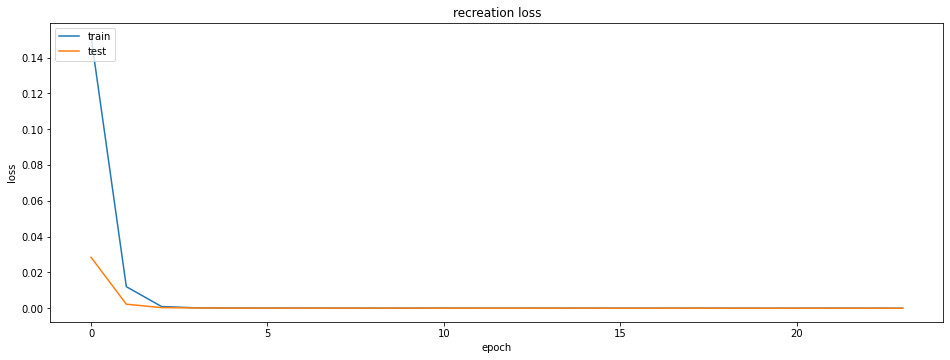

Intlier max value: 7.878155e-05 Index Val: 400
outlier max value: 5.790657e-05 Index Val: 23
outlier min value: 9.144842e-06 Index Val: 1


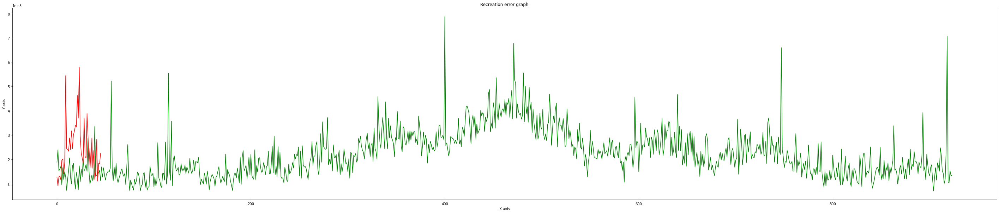

Total member in inlear: 924
Total False alarm: 899
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.96      0.03      0.05       924
           1       0.05      0.98      0.09        46

    accuracy                           0.07       970
   macro avg       0.50      0.50      0.07       970
weighted avg       0.92      0.07      0.05       970



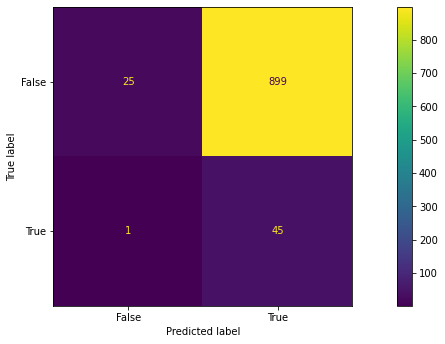

Epoch 1/200
24/24 [==============================] - 3s 92ms/step - loss: 0.1775 - val_loss: 0.0173
Epoch 2/200
24/24 [==============================] - 3s 124ms/step - loss: 0.0070 - val_loss: 0.0016
Epoch 3/200
24/24 [==============================] - 2s 86ms/step - loss: 7.8780e-04 - val_loss: 3.0298e-04
Epoch 4/200
24/24 [==============================] - 2s 84ms/step - loss: 1.8024e-04 - val_loss: 1.2386e-04
Epoch 5/200
24/24 [==============================] - 2s 85ms/step - loss: 8.5515e-05 - val_loss: 6.5649e-05
Epoch 6/200
24/24 [==============================] - 2s 84ms/step - loss: 6.1483e-05 - val_loss: 5.8206e-05
Epoch 7/200
24/24 [==============================] - 2s 85ms/step - loss: 5.2898e-05 - val_loss: 5.8134e-05
Epoch 8/200
24/24 [==============================] - 2s 85ms/step - loss: 4.6860e-05 - val_loss: 4.8778e-05
Epoch 9/200
24/24 [==============================] - 2s 84ms/step - loss: 4.1596e-05 - val_loss: 4.0779e-05
Epoch 10/200
24/24 [=======================

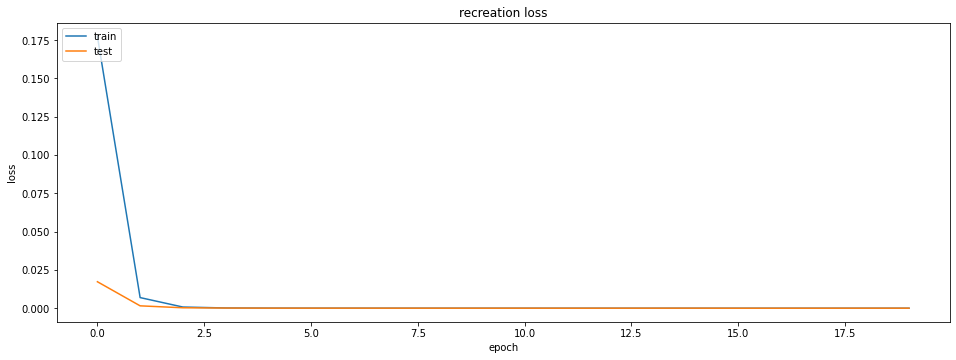

Intlier max value: 0.00011411896 Index Val: 918
outlier max value: 0.000100620535 Index Val: 9
outlier min value: 1.8131841e-05 Index Val: 30


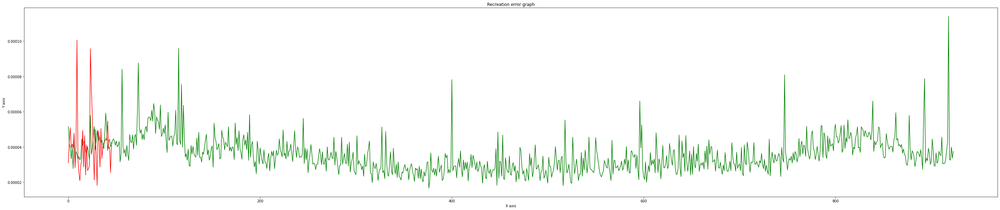

Total member in inlear: 924
Total False alarm: 921
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.75      0.00      0.01       924
           1       0.05      0.98      0.09        46

    accuracy                           0.05       970
   macro avg       0.40      0.49      0.05       970
weighted avg       0.72      0.05      0.01       970



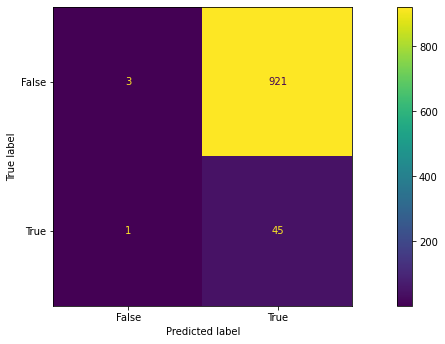

Epoch 1/200
24/24 [==============================] - 3s 96ms/step - loss: 0.1590 - val_loss: 0.0304
Epoch 2/200
24/24 [==============================] - 2s 85ms/step - loss: 0.0144 - val_loss: 0.0039
Epoch 3/200
24/24 [==============================] - 2s 85ms/step - loss: 0.0014 - val_loss: 3.9828e-04
Epoch 4/200
24/24 [==============================] - 2s 86ms/step - loss: 2.4093e-04 - val_loss: 1.5153e-04
Epoch 5/200
24/24 [==============================] - 2s 89ms/step - loss: 1.0461e-04 - val_loss: 7.3341e-05
Epoch 6/200
24/24 [==============================] - 2s 91ms/step - loss: 6.6493e-05 - val_loss: 5.5823e-05
Epoch 7/200
24/24 [==============================] - 2s 89ms/step - loss: 4.8645e-05 - val_loss: 4.3978e-05
Epoch 8/200
24/24 [==============================] - 2s 88ms/step - loss: 4.1711e-05 - val_loss: 4.1142e-05
Epoch 9/200
24/24 [==============================] - 2s 89ms/step - loss: 3.4505e-05 - val_loss: 3.4235e-05
Epoch 10/200
24/24 [============================

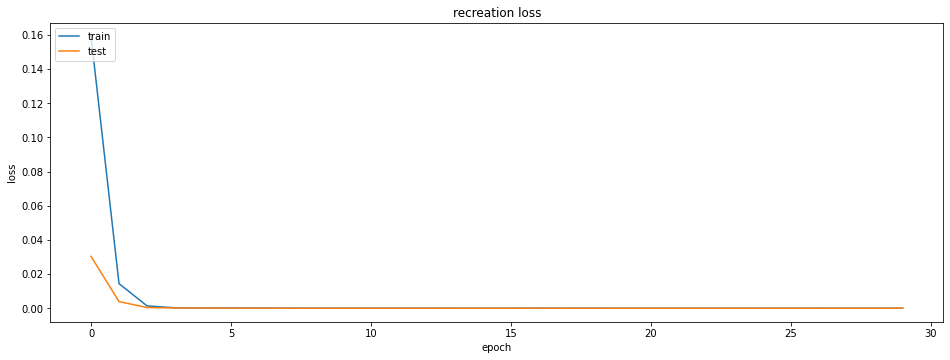

Intlier max value: 5.9637416e-05 Index Val: 400
outlier max value: 4.611651e-05 Index Val: 9
outlier min value: 1.0998547e-05 Index Val: 20


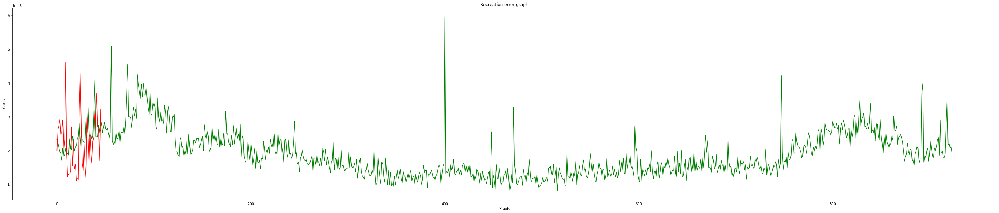

Total member in inlear: 924
Total False alarm: 869
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.98      0.06      0.11       924
           1       0.05      0.98      0.09        46

    accuracy                           0.10       970
   macro avg       0.52      0.52      0.10       970
weighted avg       0.94      0.10      0.11       970



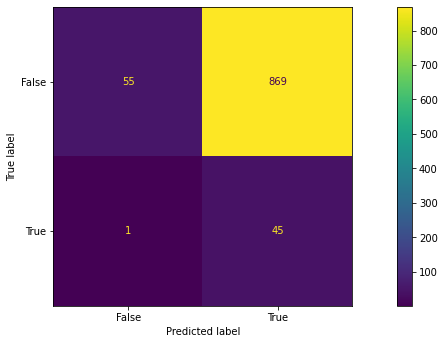

Epoch 1/200
24/24 [==============================] - 3s 96ms/step - loss: 0.2030 - val_loss: 0.0186
Epoch 2/200
24/24 [==============================] - 2s 91ms/step - loss: 0.0089 - val_loss: 0.0026
Epoch 3/200
24/24 [==============================] - 2s 90ms/step - loss: 0.0013 - val_loss: 4.3495e-04
Epoch 4/200
24/24 [==============================] - 2s 90ms/step - loss: 2.6890e-04 - val_loss: 1.5303e-04
Epoch 5/200
24/24 [==============================] - 2s 92ms/step - loss: 1.1992e-04 - val_loss: 9.4093e-05
Epoch 6/200
24/24 [==============================] - 2s 92ms/step - loss: 8.2527e-05 - val_loss: 7.0991e-05
Epoch 7/200
24/24 [==============================] - 2s 91ms/step - loss: 6.7606e-05 - val_loss: 7.0478e-05
Epoch 8/200
24/24 [==============================] - 2s 92ms/step - loss: 5.7112e-05 - val_loss: 5.1067e-05
Epoch 9/200
24/24 [==============================] - 2s 90ms/step - loss: 5.0538e-05 - val_loss: 6.5141e-05
Epoch 10/200
24/24 [============================

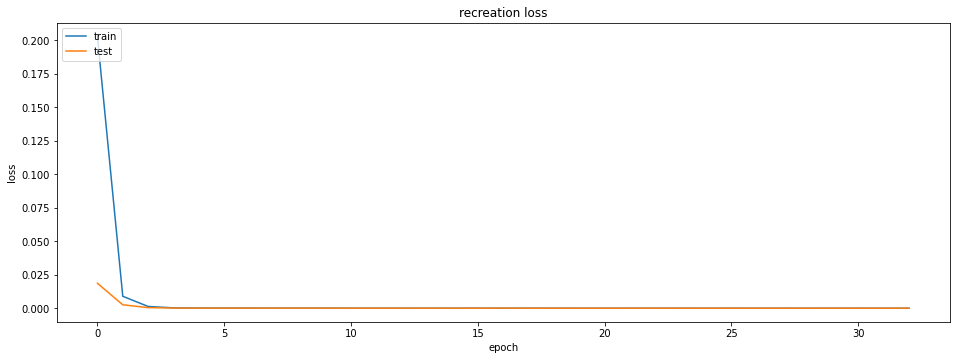

Intlier max value: 9.0674424e-05 Index Val: 56
outlier max value: 6.665955e-05 Index Val: 9
outlier min value: 1.2458144e-05 Index Val: 30


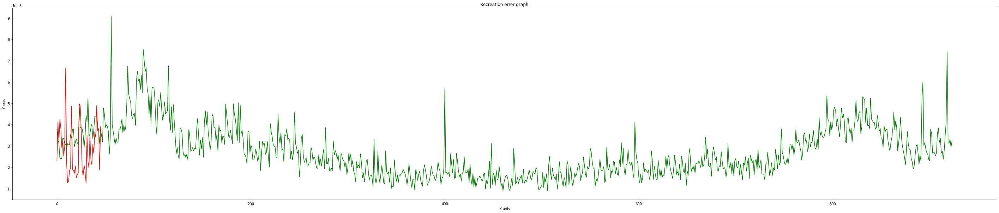

Total member in inlear: 924
Total False alarm: 875
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.98      0.05      0.10       924
           1       0.05      0.98      0.09        46

    accuracy                           0.10       970
   macro avg       0.51      0.52      0.10       970
weighted avg       0.94      0.10      0.10       970



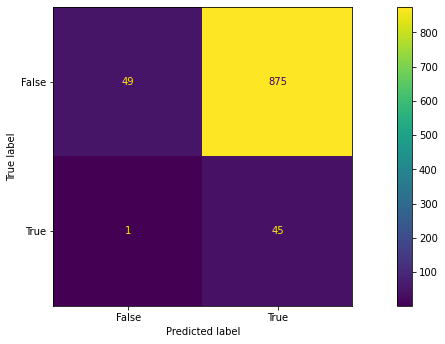

Epoch 1/200
24/24 [==============================] - 3s 103ms/step - loss: 0.2275 - val_loss: 0.0515
Epoch 2/200
24/24 [==============================] - 2s 94ms/step - loss: 0.0190 - val_loss: 0.0029
Epoch 3/200
24/24 [==============================] - 3s 111ms/step - loss: 0.0012 - val_loss: 3.6947e-04
Epoch 4/200
24/24 [==============================] - 3s 135ms/step - loss: 2.1382e-04 - val_loss: 1.3292e-04
Epoch 5/200
24/24 [==============================] - 2s 93ms/step - loss: 1.1175e-04 - val_loss: 8.9688e-05
Epoch 6/200
24/24 [==============================] - 2s 93ms/step - loss: 8.1025e-05 - val_loss: 7.2166e-05
Epoch 7/200
24/24 [==============================] - 2s 94ms/step - loss: 6.2974e-05 - val_loss: 6.5217e-05
Epoch 8/200
24/24 [==============================] - 2s 95ms/step - loss: 5.2710e-05 - val_loss: 4.8688e-05
Epoch 9/200
24/24 [==============================] - 2s 93ms/step - loss: 4.2628e-05 - val_loss: 4.7019e-05
Epoch 10/200
24/24 [=========================

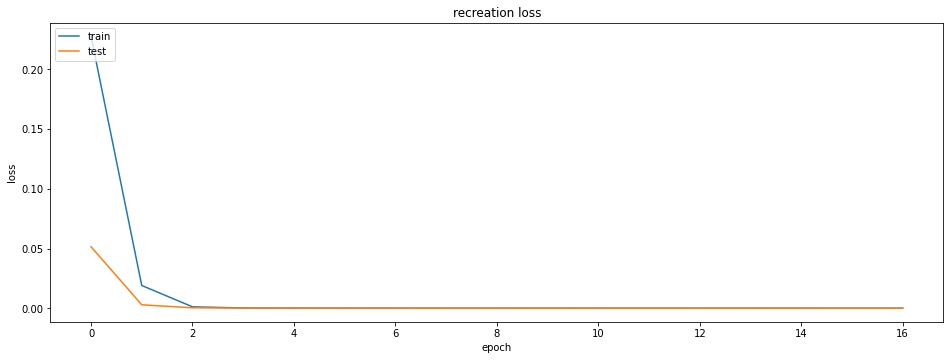

Intlier max value: 0.000115146395 Index Val: 747
outlier max value: 7.89294e-05 Index Val: 9
outlier min value: 2.0616038e-05 Index Val: 1


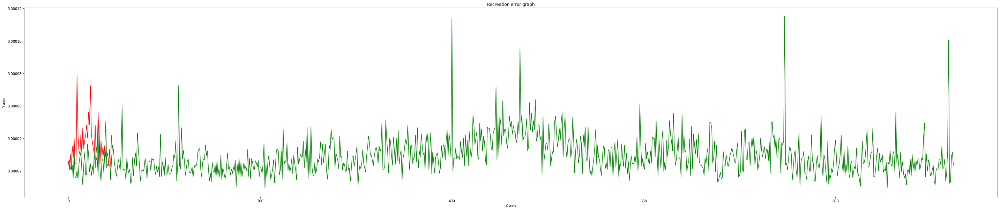

Total member in inlear: 924
Total False alarm: 705
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       1.00      0.24      0.38       924
           1       0.06      0.98      0.11        46

    accuracy                           0.27       970
   macro avg       0.53      0.61      0.25       970
weighted avg       0.95      0.27      0.37       970



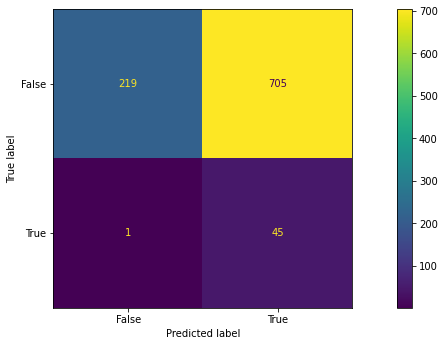

trecall_max: 0.237012987012987 frecall_max: 0.9782608695652174 Count: 2


INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Outlier_model/cnn_m2_undercomplete/assets


INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Outlier_model/cnn_m2_undercomplete/assets


Epoch 1/200
24/24 [==============================] - 3s 100ms/step - loss: 0.1618 - val_loss: 0.0230
Epoch 2/200
24/24 [==============================] - 2s 93ms/step - loss: 0.0092 - val_loss: 0.0016
Epoch 3/200
24/24 [==============================] - 2s 91ms/step - loss: 7.6821e-04 - val_loss: 2.8364e-04
Epoch 4/200
24/24 [==============================] - 2s 93ms/step - loss: 1.9023e-04 - val_loss: 1.3377e-04
Epoch 5/200
24/24 [==============================] - 2s 93ms/step - loss: 1.0810e-04 - val_loss: 9.5121e-05
Epoch 6/200
24/24 [==============================] - 2s 93ms/step - loss: 7.5880e-05 - val_loss: 7.3872e-05
Epoch 7/200
24/24 [==============================] - 2s 91ms/step - loss: 5.6415e-05 - val_loss: 4.8334e-05
Epoch 8/200
24/24 [==============================] - 2s 93ms/step - loss: 4.3272e-05 - val_loss: 4.4147e-05
Epoch 9/200
24/24 [==============================] - 2s 92ms/step - loss: 4.0979e-05 - val_loss: 4.0561e-05
Epoch 10/200
24/24 [=======================

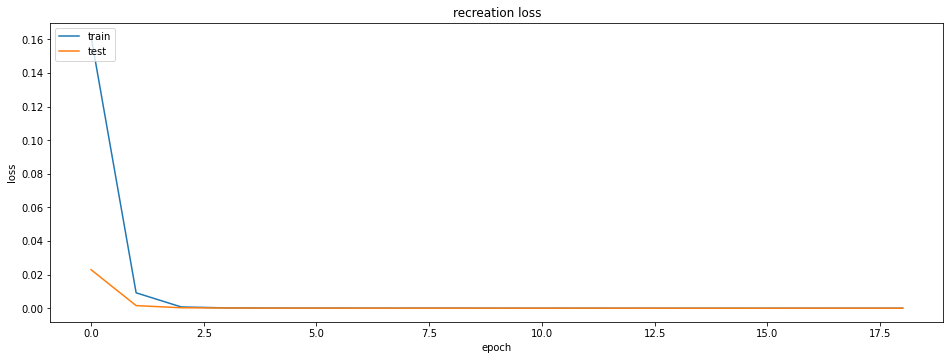

Intlier max value: 7.603229e-05 Index Val: 918
outlier max value: 0.00010267369 Index Val: 9
outlier min value: 1.0466511e-05 Index Val: 27


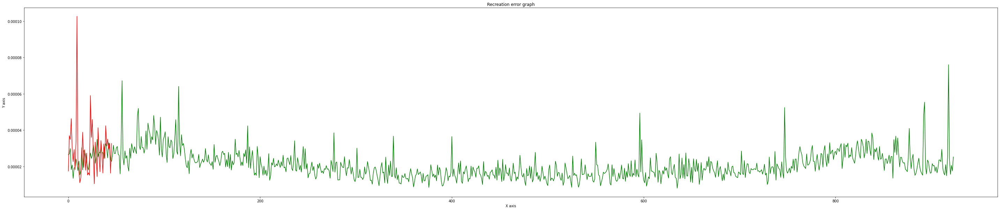

Total member in inlear: 924
Total False alarm: 903
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.95      0.02      0.04       924
           1       0.05      0.98      0.09        46

    accuracy                           0.07       970
   macro avg       0.50      0.50      0.07       970
weighted avg       0.91      0.07      0.05       970



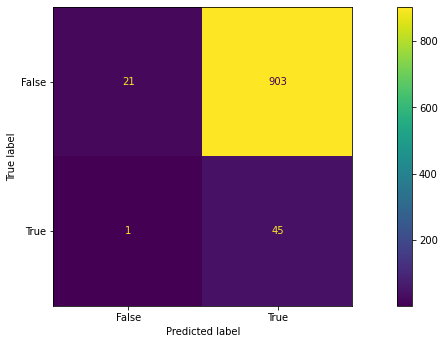

Epoch 1/200
24/24 [==============================] - 3s 101ms/step - loss: 0.2233 - val_loss: 0.1341
Epoch 2/200
24/24 [==============================] - 2s 93ms/step - loss: 0.1223 - val_loss: 0.1138
Epoch 3/200
24/24 [==============================] - 2s 95ms/step - loss: 0.1138 - val_loss: 0.1114
Epoch 4/200
24/24 [==============================] - 2s 94ms/step - loss: 0.1128 - val_loss: 0.1113
Epoch 5/200
24/24 [==============================] - 2s 93ms/step - loss: 0.1128 - val_loss: 0.1112
Epoch 6/200
24/24 [==============================] - 2s 95ms/step - loss: 0.1127 - val_loss: 0.1112
Epoch 7/200
24/24 [==============================] - 2s 93ms/step - loss: 0.1127 - val_loss: 0.1112
Epoch 8/200
24/24 [==============================] - 2s 95ms/step - loss: 0.1127 - val_loss: 0.1112
Epoch 9/200
24/24 [==============================] - 2s 95ms/step - loss: 0.1127 - val_loss: 0.1112
Epoch 10/200
24/24 [==============================] - 2s 95ms/step - loss: 0.1127 - val_loss: 0.111

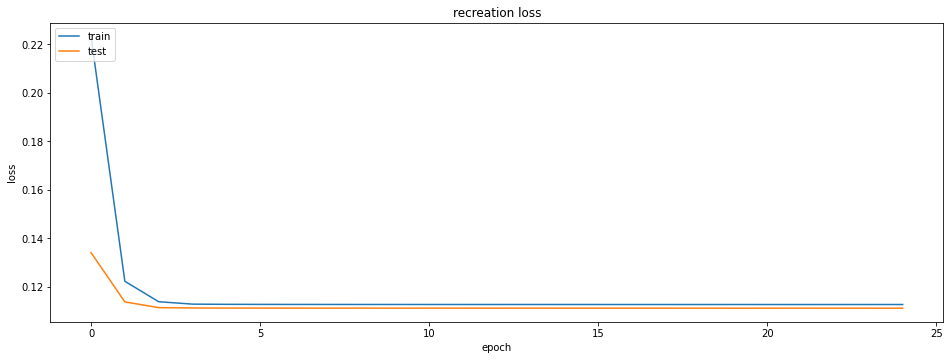

Intlier max value: 0.12502523 Index Val: 487
outlier max value: 0.12501813 Index Val: 21
outlier min value: 0.08751228 Index Val: 29


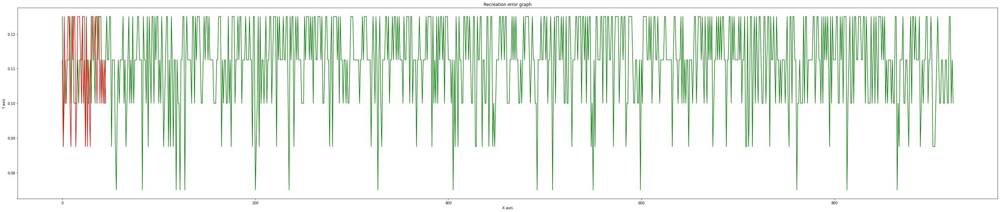

Total member in inlear: 924
Total False alarm: 855
Total member in Outlier: 46
Total missed true alarm: 6
              precision    recall  f1-score   support

           0       0.92      0.07      0.14       924
           1       0.04      0.87      0.09        46

    accuracy                           0.11       970
   macro avg       0.48      0.47      0.11       970
weighted avg       0.88      0.11      0.14       970



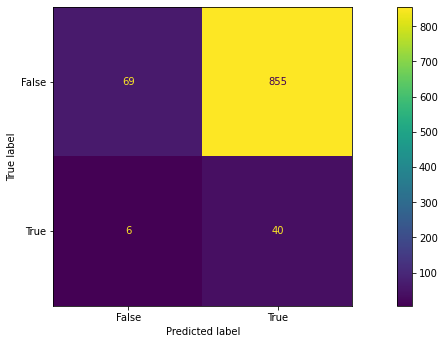

Epoch 1/200
24/24 [==============================] - 3s 105ms/step - loss: 0.1500 - val_loss: 0.0277
Epoch 2/200
24/24 [==============================] - 2s 97ms/step - loss: 0.0110 - val_loss: 0.0024
Epoch 3/200
24/24 [==============================] - 2s 99ms/step - loss: 0.0011 - val_loss: 3.2985e-04
Epoch 4/200
24/24 [==============================] - 2s 99ms/step - loss: 1.9018e-04 - val_loss: 1.3977e-04
Epoch 5/200
24/24 [==============================] - 3s 123ms/step - loss: 9.4796e-05 - val_loss: 7.5020e-05
Epoch 6/200
24/24 [==============================] - 3s 138ms/step - loss: 6.8427e-05 - val_loss: 6.1932e-05
Epoch 7/200
24/24 [==============================] - 2s 99ms/step - loss: 5.2829e-05 - val_loss: 5.0021e-05
Epoch 8/200
24/24 [==============================] - 2s 97ms/step - loss: 4.7823e-05 - val_loss: 4.0996e-05
Epoch 9/200
24/24 [==============================] - 2s 96ms/step - loss: 4.2474e-05 - val_loss: 3.9349e-05
Epoch 10/200
24/24 [=========================

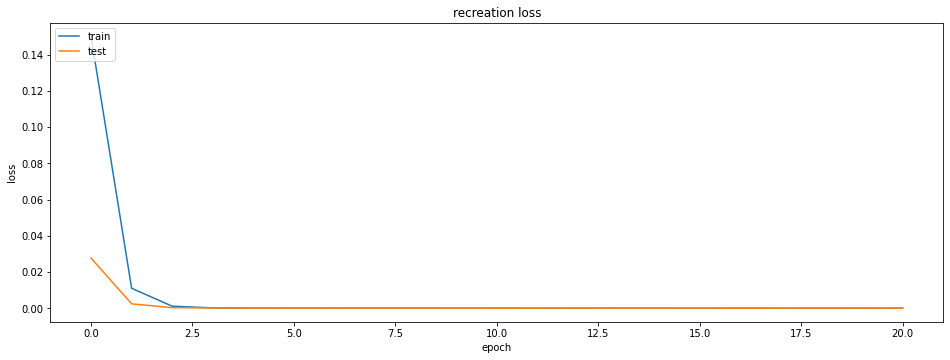

Intlier max value: 8.657711e-05 Index Val: 918
outlier max value: 7.240721e-05 Index Val: 9
outlier min value: 1.4680869e-05 Index Val: 12


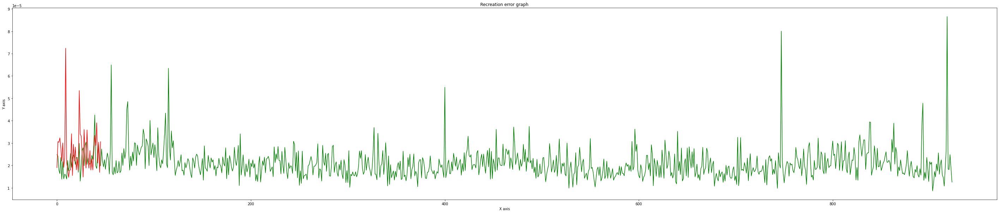

Total member in inlear: 924
Total False alarm: 818
Total member in Outlier: 46
Total missed true alarm: 2
              precision    recall  f1-score   support

           0       0.98      0.11      0.21       924
           1       0.05      0.96      0.10        46

    accuracy                           0.15       970
   macro avg       0.52      0.54      0.15       970
weighted avg       0.94      0.15      0.20       970



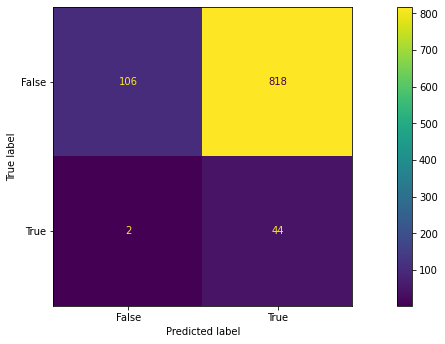

Epoch 1/200
24/24 [==============================] - 3s 106ms/step - loss: 0.1798 - val_loss: 0.0494
Epoch 2/200
24/24 [==============================] - 2s 99ms/step - loss: 0.0218 - val_loss: 0.0045
Epoch 3/200
24/24 [==============================] - 2s 99ms/step - loss: 0.0025 - val_loss: 7.4005e-04
Epoch 4/200
24/24 [==============================] - 2s 98ms/step - loss: 3.2901e-04 - val_loss: 1.4818e-04
Epoch 5/200
24/24 [==============================] - 2s 99ms/step - loss: 1.1786e-04 - val_loss: 9.9667e-05
Epoch 6/200
24/24 [==============================] - 2s 98ms/step - loss: 7.3970e-05 - val_loss: 6.2361e-05
Epoch 7/200
24/24 [==============================] - 2s 100ms/step - loss: 5.4334e-05 - val_loss: 4.4404e-05
Epoch 8/200
24/24 [==============================] - 2s 99ms/step - loss: 4.0768e-05 - val_loss: 4.3392e-05
Epoch 9/200
24/24 [==============================] - 2s 100ms/step - loss: 3.7646e-05 - val_loss: 3.7743e-05
Epoch 10/200
24/24 [=========================

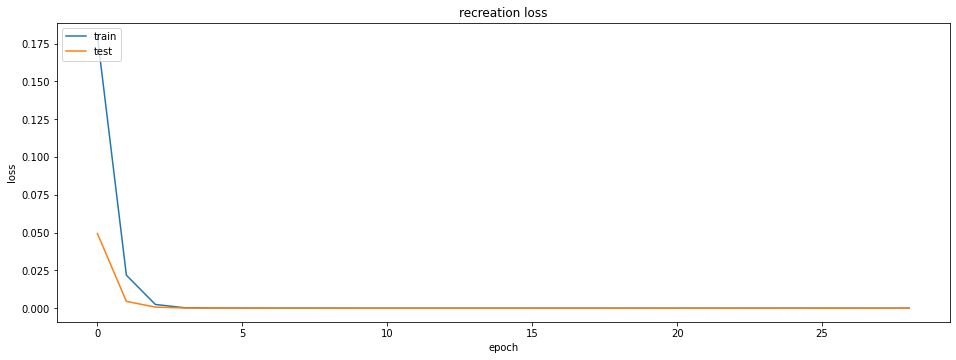

Intlier max value: 9.0324414e-05 Index Val: 747
outlier max value: 7.4556425e-05 Index Val: 9
outlier min value: 1.871974e-05 Index Val: 5


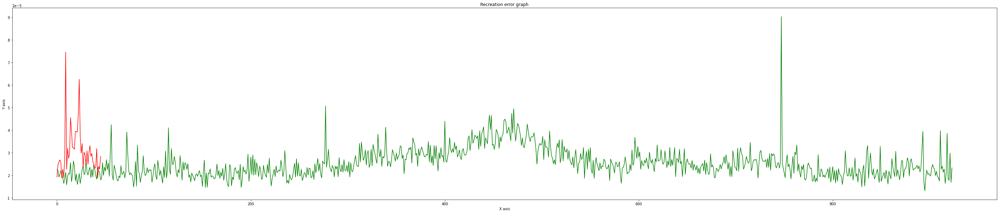

Total member in inlear: 924
Total False alarm: 823
Total member in Outlier: 46
Total missed true alarm: 2
              precision    recall  f1-score   support

           0       0.98      0.11      0.20       924
           1       0.05      0.96      0.10        46

    accuracy                           0.15       970
   macro avg       0.52      0.53      0.15       970
weighted avg       0.94      0.15      0.19       970



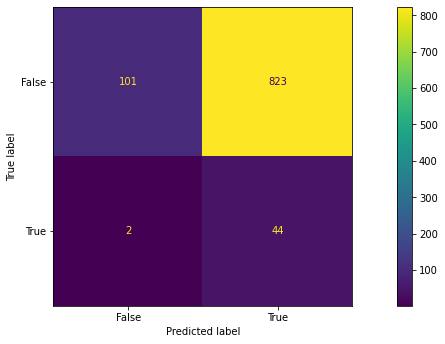

Epoch 1/200
24/24 [==============================] - 3s 107ms/step - loss: 0.1658 - val_loss: 0.0245
Epoch 2/200
24/24 [==============================] - 2s 102ms/step - loss: 0.0118 - val_loss: 0.0026
Epoch 3/200
24/24 [==============================] - 2s 100ms/step - loss: 0.0013 - val_loss: 3.3703e-04
Epoch 4/200
24/24 [==============================] - 2s 100ms/step - loss: 2.2259e-04 - val_loss: 1.2503e-04
Epoch 5/200
24/24 [==============================] - 2s 101ms/step - loss: 9.8382e-05 - val_loss: 7.7729e-05
Epoch 6/200
24/24 [==============================] - 2s 100ms/step - loss: 6.9805e-05 - val_loss: 5.9899e-05
Epoch 7/200
24/24 [==============================] - 2s 103ms/step - loss: 5.2441e-05 - val_loss: 4.6096e-05
Epoch 8/200
24/24 [==============================] - 2s 100ms/step - loss: 4.0363e-05 - val_loss: 3.7347e-05
Epoch 9/200
24/24 [==============================] - 2s 101ms/step - loss: 3.5130e-05 - val_loss: 3.6947e-05
Epoch 10/200
24/24 [===================

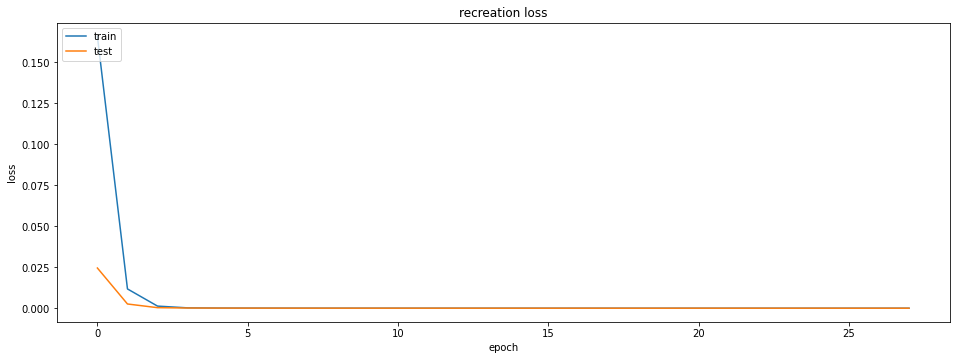

Intlier max value: 4.099151e-05 Index Val: 747
outlier max value: 3.549357e-05 Index Val: 9
outlier min value: 2.6065177e-06 Index Val: 7


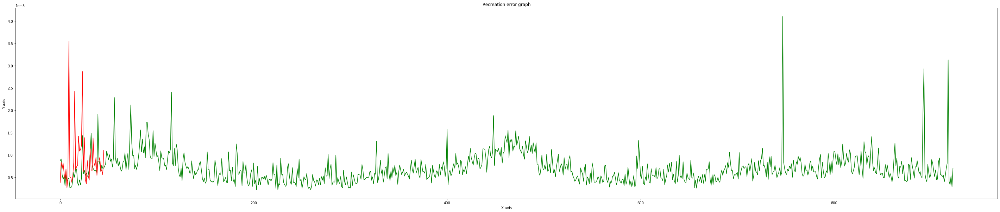

Total member in inlear: 924
Total False alarm: 913
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.92      0.01      0.02       924
           1       0.05      0.98      0.09        46

    accuracy                           0.06       970
   macro avg       0.48      0.50      0.06       970
weighted avg       0.88      0.06      0.03       970



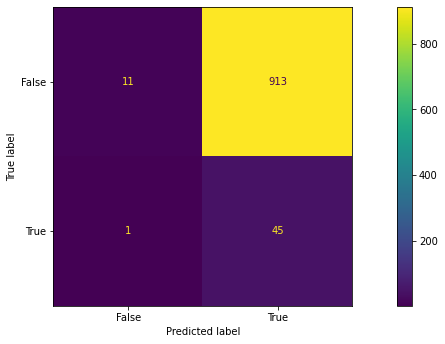

Epoch 1/200
24/24 [==============================] - 4s 107ms/step - loss: 0.1852 - val_loss: 0.0588
Epoch 2/200
24/24 [==============================] - 2s 101ms/step - loss: 0.0248 - val_loss: 0.0048
Epoch 3/200
24/24 [==============================] - 2s 102ms/step - loss: 0.0022 - val_loss: 5.1540e-04
Epoch 4/200
24/24 [==============================] - 3s 136ms/step - loss: 2.7984e-04 - val_loss: 1.5419e-04
Epoch 5/200
24/24 [==============================] - 3s 128ms/step - loss: 1.1554e-04 - val_loss: 9.2671e-05
Epoch 6/200
24/24 [==============================] - 2s 101ms/step - loss: 7.2969e-05 - val_loss: 6.2073e-05
Epoch 7/200
24/24 [==============================] - 2s 101ms/step - loss: 5.2121e-05 - val_loss: 4.7888e-05
Epoch 8/200
24/24 [==============================] - 2s 102ms/step - loss: 3.8710e-05 - val_loss: 5.2437e-05
Epoch 9/200
24/24 [==============================] - 2s 101ms/step - loss: 3.3732e-05 - val_loss: 4.2925e-05
Epoch 10/200
24/24 [===================

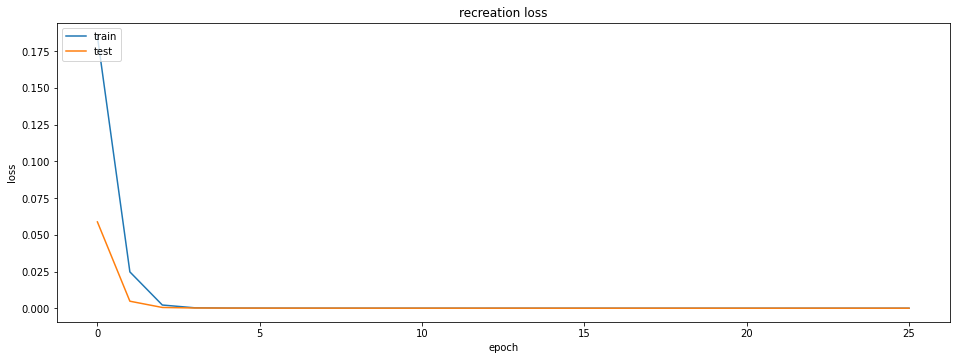

Intlier max value: 4.9335737e-05 Index Val: 747
outlier max value: 4.729043e-05 Index Val: 23
outlier min value: 5.441301e-06 Index Val: 1


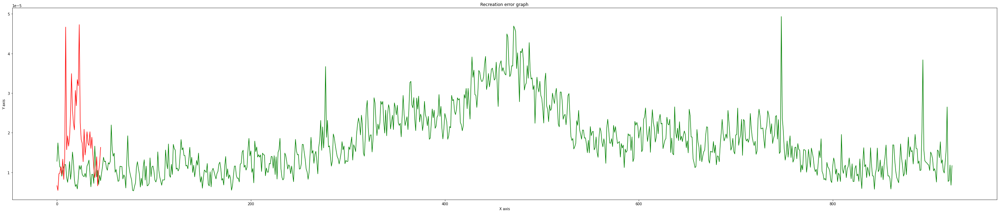

Total member in inlear: 924
Total False alarm: 922
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.67      0.00      0.00       924
           1       0.05      0.98      0.09        46

    accuracy                           0.05       970
   macro avg       0.36      0.49      0.05       970
weighted avg       0.64      0.05      0.01       970



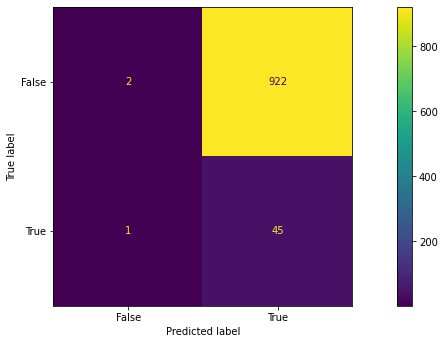

Epoch 1/200
24/24 [==============================] - 3s 109ms/step - loss: 0.1840 - val_loss: 0.0478
Epoch 2/200
24/24 [==============================] - 2s 100ms/step - loss: 0.0224 - val_loss: 0.0042
Epoch 3/200
24/24 [==============================] - 2s 103ms/step - loss: 0.0014 - val_loss: 3.9256e-04
Epoch 4/200
24/24 [==============================] - 2s 101ms/step - loss: 2.4892e-04 - val_loss: 1.3805e-04
Epoch 5/200
24/24 [==============================] - 2s 103ms/step - loss: 1.1330e-04 - val_loss: 9.6113e-05
Epoch 6/200
24/24 [==============================] - 2s 102ms/step - loss: 8.0336e-05 - val_loss: 8.3011e-05
Epoch 7/200
24/24 [==============================] - 2s 103ms/step - loss: 6.1538e-05 - val_loss: 5.3796e-05
Epoch 8/200
24/24 [==============================] - 3s 104ms/step - loss: 4.7204e-05 - val_loss: 4.4578e-05
Epoch 9/200
24/24 [==============================] - 2s 102ms/step - loss: 3.8381e-05 - val_loss: 4.6392e-05
Epoch 10/200
24/24 [===================

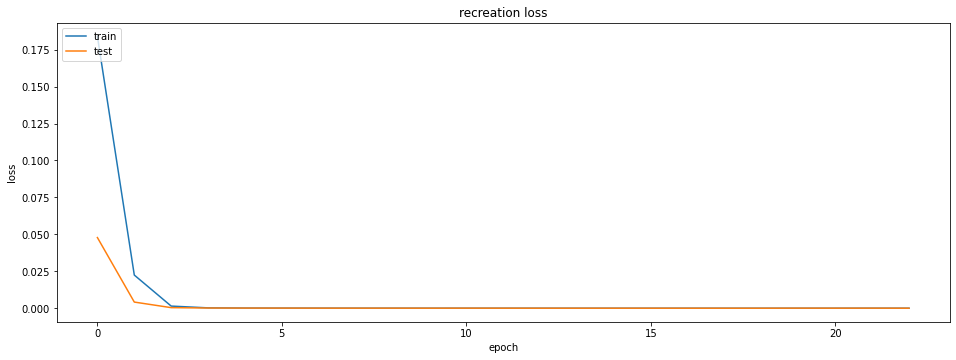

Intlier max value: 8.3557934e-05 Index Val: 747
outlier max value: 6.152001e-05 Index Val: 9
outlier min value: 4.1353255e-06 Index Val: 7


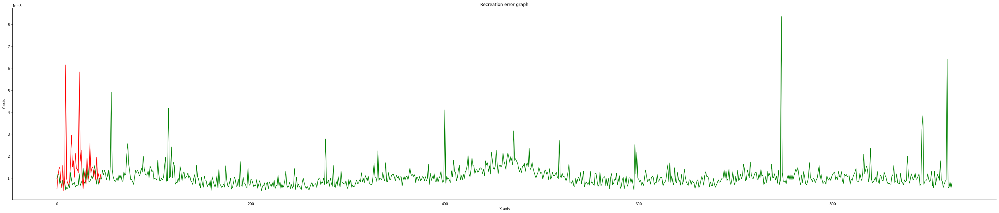

Total member in inlear: 924
Total False alarm: 924
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       924
           1       0.05      0.98      0.09        46

    accuracy                           0.05       970
   macro avg       0.02      0.49      0.04       970
weighted avg       0.00      0.05      0.00       970



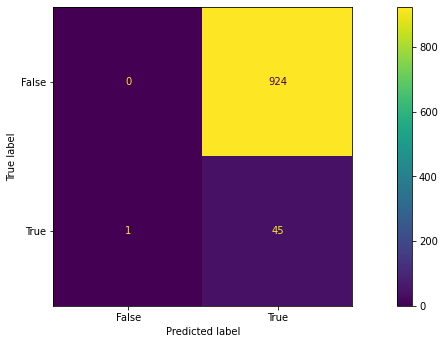

Epoch 1/200
24/24 [==============================] - 3s 111ms/step - loss: 0.1549 - val_loss: 0.0229
Epoch 2/200
24/24 [==============================] - 3s 104ms/step - loss: 0.0100 - val_loss: 0.0016
Epoch 3/200
24/24 [==============================] - 3s 105ms/step - loss: 8.1519e-04 - val_loss: 2.9981e-04
Epoch 4/200
24/24 [==============================] - 3s 104ms/step - loss: 1.9096e-04 - val_loss: 1.2605e-04
Epoch 5/200
24/24 [==============================] - 3s 104ms/step - loss: 1.0130e-04 - val_loss: 9.3797e-05
Epoch 6/200
24/24 [==============================] - 3s 104ms/step - loss: 7.4087e-05 - val_loss: 6.7081e-05
Epoch 7/200
24/24 [==============================] - 3s 104ms/step - loss: 5.8981e-05 - val_loss: 5.5700e-05
Epoch 8/200
24/24 [==============================] - 3s 104ms/step - loss: 5.0027e-05 - val_loss: 4.9197e-05
Epoch 9/200
24/24 [==============================] - 2s 103ms/step - loss: 4.4287e-05 - val_loss: 4.5771e-05
Epoch 10/200
24/24 [===============

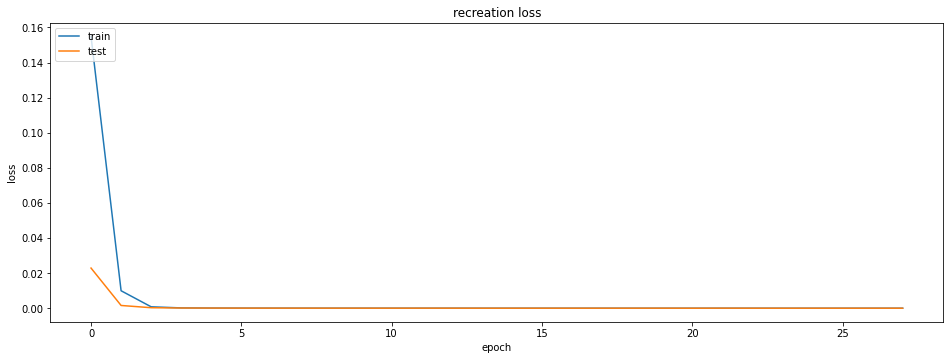

Intlier max value: 6.84059e-05 Index Val: 471
outlier max value: 3.860687e-05 Index Val: 23
outlier min value: 8.5193315e-06 Index Val: 0


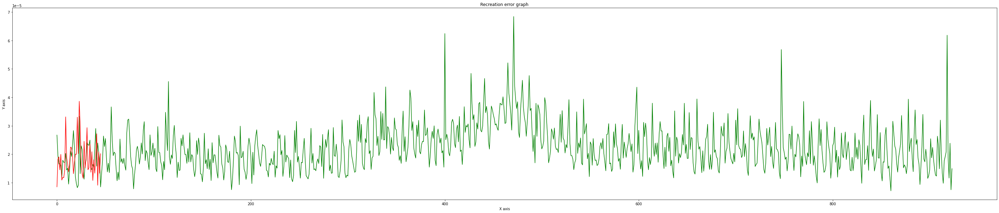

Total member in inlear: 924
Total False alarm: 918
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.86      0.01      0.01       924
           1       0.05      0.98      0.09        46

    accuracy                           0.05       970
   macro avg       0.45      0.49      0.05       970
weighted avg       0.82      0.05      0.02       970



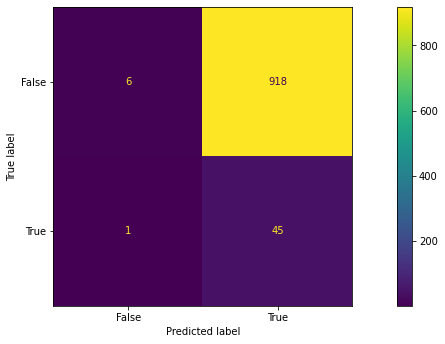

Epoch 1/200
24/24 [==============================] - 3s 115ms/step - loss: 0.2564 - val_loss: 0.1311
Epoch 2/200
24/24 [==============================] - 3s 108ms/step - loss: 0.0830 - val_loss: 0.0166
Epoch 3/200
24/24 [==============================] - 3s 107ms/step - loss: 0.0085 - val_loss: 0.0023
Epoch 4/200
24/24 [==============================] - 3s 107ms/step - loss: 0.0016 - val_loss: 6.8562e-04
Epoch 5/200
24/24 [==============================] - 3s 108ms/step - loss: 3.7906e-04 - val_loss: 1.7225e-04
Epoch 6/200
24/24 [==============================] - 3s 108ms/step - loss: 1.3024e-04 - val_loss: 9.8278e-05
Epoch 7/200
24/24 [==============================] - 3s 107ms/step - loss: 8.7901e-05 - val_loss: 7.8854e-05
Epoch 8/200
24/24 [==============================] - 3s 107ms/step - loss: 6.8210e-05 - val_loss: 6.0080e-05
Epoch 9/200
24/24 [==============================] - 3s 105ms/step - loss: 5.6049e-05 - val_loss: 4.9958e-05
Epoch 10/200
24/24 [===========================

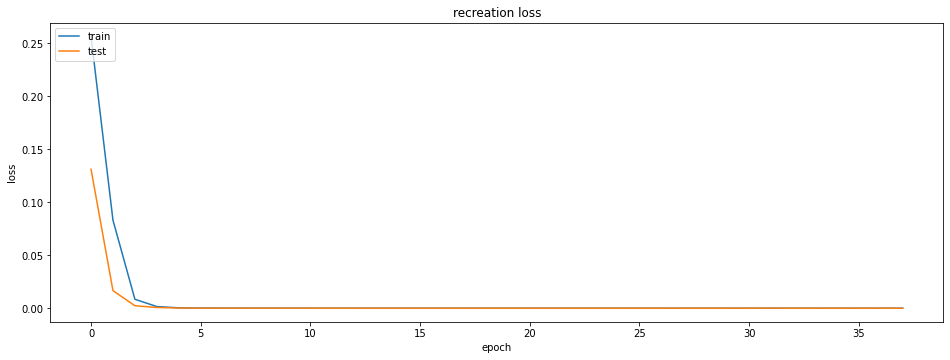

Intlier max value: 5.0472376e-05 Index Val: 56
outlier max value: 4.80503e-05 Index Val: 9
outlier min value: 2.5521201e-06 Index Val: 27


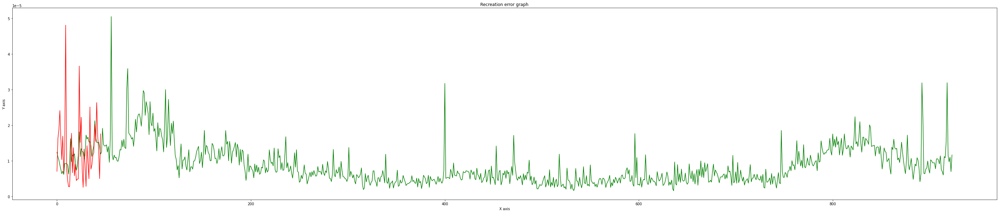

Total member in inlear: 924
Total False alarm: 902
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.96      0.02      0.05       924
           1       0.05      0.98      0.09        46

    accuracy                           0.07       970
   macro avg       0.50      0.50      0.07       970
weighted avg       0.91      0.07      0.05       970



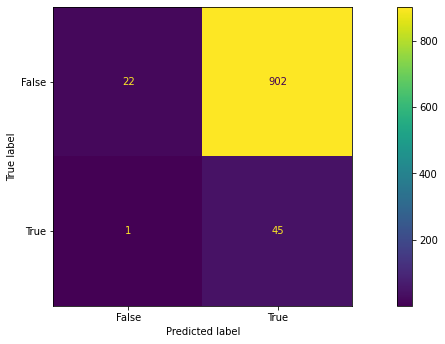

Epoch 1/200
24/24 [==============================] - 3s 115ms/step - loss: 0.1545 - val_loss: 0.0399
Epoch 2/200
24/24 [==============================] - 3s 112ms/step - loss: 0.0142 - val_loss: 0.0023
Epoch 3/200
24/24 [==============================] - 3s 109ms/step - loss: 0.0011 - val_loss: 4.0053e-04
Epoch 4/200
24/24 [==============================] - 3s 109ms/step - loss: 2.4172e-04 - val_loss: 1.5639e-04
Epoch 5/200
24/24 [==============================] - 3s 108ms/step - loss: 1.2553e-04 - val_loss: 1.0397e-04
Epoch 6/200
24/24 [==============================] - 3s 110ms/step - loss: 8.8735e-05 - val_loss: 8.6913e-05
Epoch 7/200
24/24 [==============================] - 3s 110ms/step - loss: 7.7972e-05 - val_loss: 6.9147e-05
Epoch 8/200
24/24 [==============================] - 3s 110ms/step - loss: 6.1716e-05 - val_loss: 6.1695e-05
Epoch 9/200
24/24 [==============================] - 3s 110ms/step - loss: 5.5817e-05 - val_loss: 5.7688e-05
Epoch 10/200
24/24 [===================

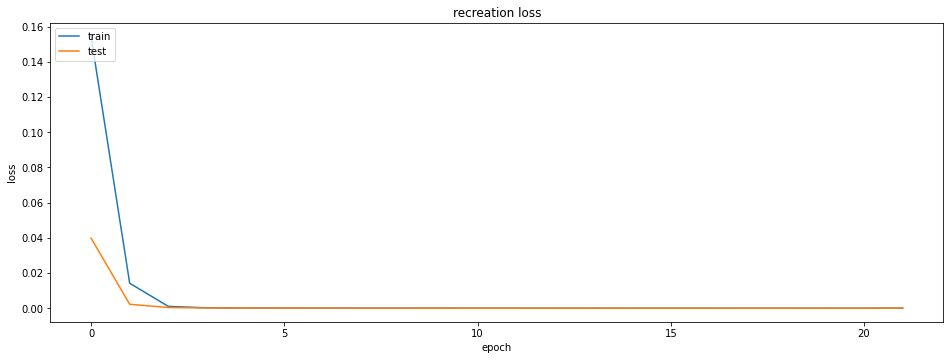

Intlier max value: 0.00016108467 Index Val: 918
outlier max value: 0.00013404418 Index Val: 9
outlier min value: 8.5801155e-05 Index Val: 14


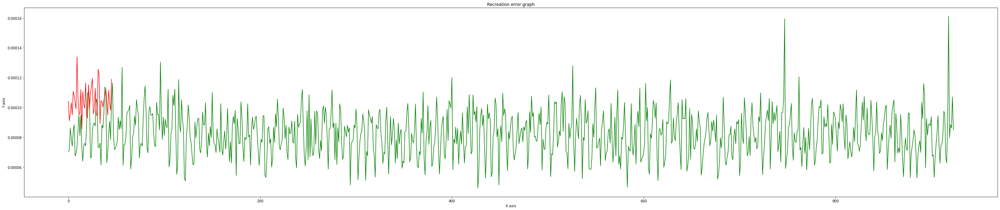

Total member in inlear: 924
Total False alarm: 366
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       1.00      0.60      0.75       924
           1       0.11      0.98      0.20        46

    accuracy                           0.62       970
   macro avg       0.55      0.79      0.47       970
weighted avg       0.96      0.62      0.73       970



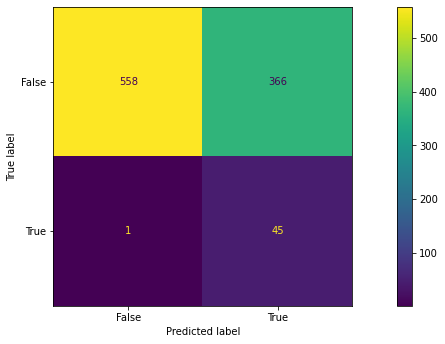

trecall_max: 0.6038961038961039 frecall_max: 0.9782608695652174 Count: 3


INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Outlier_model/cnn_m2_undercomplete/assets


INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Outlier_model/cnn_m2_undercomplete/assets


Epoch 1/200
24/24 [==============================] - 3s 115ms/step - loss: 0.1812 - val_loss: 0.0434
Epoch 2/200
24/24 [==============================] - 3s 110ms/step - loss: 0.0222 - val_loss: 0.0065
Epoch 3/200
24/24 [==============================] - 3s 108ms/step - loss: 0.0024 - val_loss: 4.8988e-04
Epoch 4/200
24/24 [==============================] - 3s 109ms/step - loss: 2.9814e-04 - val_loss: 1.6496e-04
Epoch 5/200
24/24 [==============================] - 3s 109ms/step - loss: 1.2937e-04 - val_loss: 1.0276e-04
Epoch 6/200
24/24 [==============================] - 3s 110ms/step - loss: 8.2391e-05 - val_loss: 7.6954e-05
Epoch 7/200
24/24 [==============================] - 3s 110ms/step - loss: 6.2529e-05 - val_loss: 5.5642e-05
Epoch 8/200
24/24 [==============================] - 3s 111ms/step - loss: 5.1565e-05 - val_loss: 5.5829e-05
Epoch 9/200
24/24 [==============================] - 3s 110ms/step - loss: 5.3046e-05 - val_loss: 5.5043e-05
Epoch 10/200
24/24 [===================

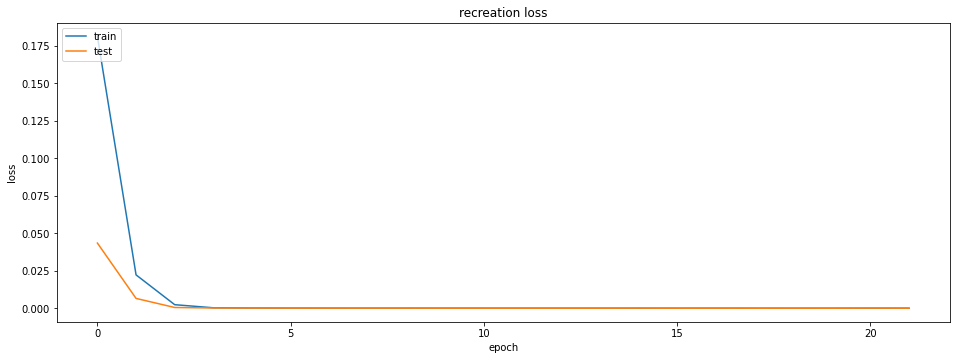

Intlier max value: 9.332308e-05 Index Val: 918
outlier max value: 9.6656804e-05 Index Val: 9
outlier min value: 1.4655018e-05 Index Val: 42


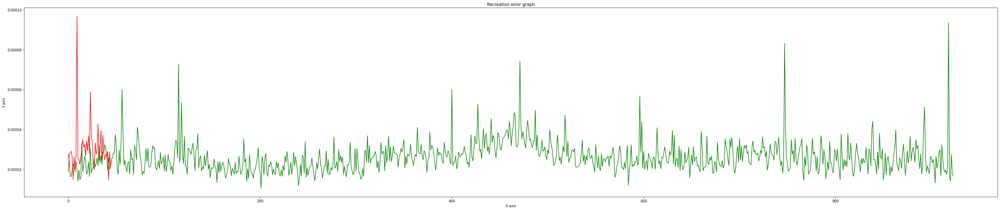

Total member in inlear: 924
Total False alarm: 914
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.91      0.01      0.02       924
           1       0.05      0.98      0.09        46

    accuracy                           0.06       970
   macro avg       0.48      0.49      0.06       970
weighted avg       0.87      0.06      0.02       970



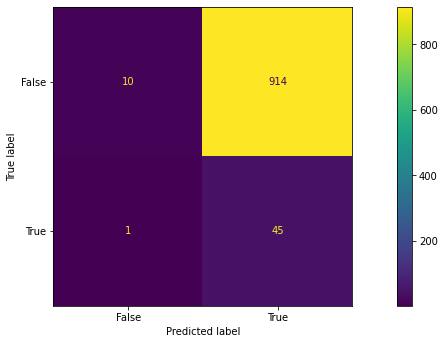

Epoch 1/200
24/24 [==============================] - 3s 116ms/step - loss: 0.1823 - val_loss: 0.0190
Epoch 2/200
24/24 [==============================] - 3s 112ms/step - loss: 0.0092 - val_loss: 0.0029
Epoch 3/200
24/24 [==============================] - 3s 116ms/step - loss: 0.0012 - val_loss: 2.9113e-04
Epoch 4/200
24/24 [==============================] - 4s 149ms/step - loss: 1.8183e-04 - val_loss: 1.1825e-04
Epoch 5/200
24/24 [==============================] - 3s 134ms/step - loss: 9.1476e-05 - val_loss: 7.1053e-05
Epoch 6/200
24/24 [==============================] - 3s 111ms/step - loss: 6.2424e-05 - val_loss: 5.2016e-05
Epoch 7/200
24/24 [==============================] - 3s 111ms/step - loss: 4.4498e-05 - val_loss: 3.6878e-05
Epoch 8/200
24/24 [==============================] - 3s 110ms/step - loss: 3.9148e-05 - val_loss: 4.9732e-05
Epoch 9/200
24/24 [==============================] - 3s 110ms/step - loss: 3.9024e-05 - val_loss: 3.2442e-05
Epoch 10/200
24/24 [===================

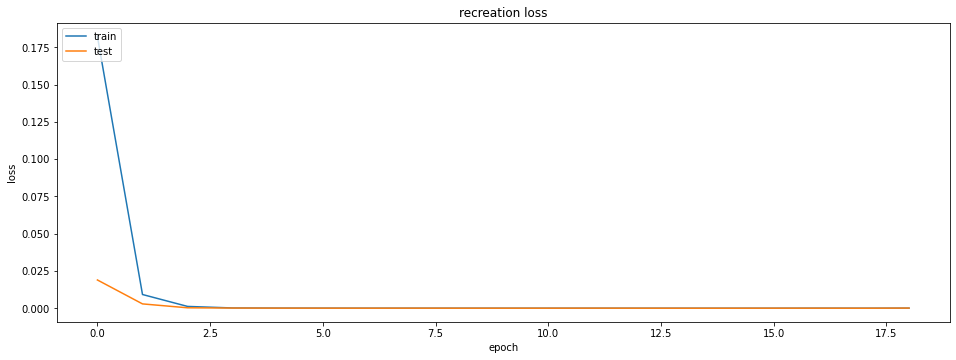

Intlier max value: 0.00019190279 Index Val: 477
outlier max value: 0.00018787773 Index Val: 21
outlier min value: 8.971603e-05 Index Val: 3


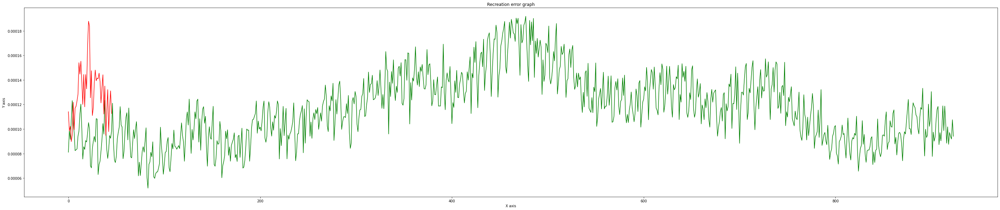

Total member in inlear: 924
Total False alarm: 754
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.99      0.18      0.31       924
           1       0.06      0.98      0.11        46

    accuracy                           0.22       970
   macro avg       0.53      0.58      0.21       970
weighted avg       0.95      0.22      0.30       970



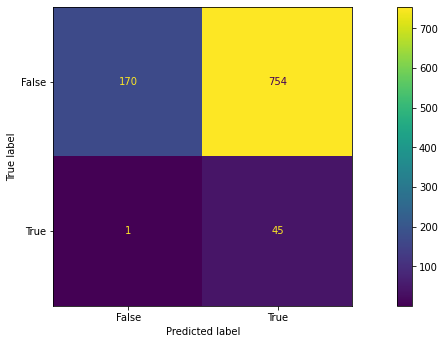

Epoch 1/200
24/24 [==============================] - 3s 120ms/step - loss: 0.1958 - val_loss: 0.1198
Epoch 2/200
24/24 [==============================] - 3s 114ms/step - loss: 0.0973 - val_loss: 0.0469
Epoch 3/200
24/24 [==============================] - 3s 113ms/step - loss: 0.0230 - val_loss: 0.0039
Epoch 4/200
24/24 [==============================] - 3s 114ms/step - loss: 0.0010 - val_loss: 3.0014e-04
Epoch 5/200
24/24 [==============================] - 3s 114ms/step - loss: 1.9120e-04 - val_loss: 1.1713e-04
Epoch 6/200
24/24 [==============================] - 3s 113ms/step - loss: 9.1584e-05 - val_loss: 7.9152e-05
Epoch 7/200
24/24 [==============================] - 3s 114ms/step - loss: 6.2367e-05 - val_loss: 8.6897e-05
Epoch 8/200
24/24 [==============================] - 3s 112ms/step - loss: 5.4728e-05 - val_loss: 4.3852e-05
Epoch 9/200
24/24 [==============================] - 3s 112ms/step - loss: 4.1666e-05 - val_loss: 4.6412e-05
Epoch 10/200
24/24 [===========================

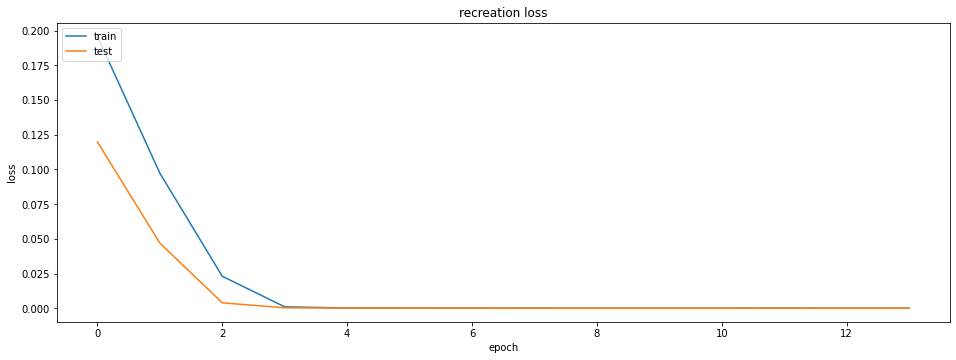

Intlier max value: 0.00013901576 Index Val: 747
outlier max value: 9.220776e-05 Index Val: 9
outlier min value: 1.29791315e-05 Index Val: 27


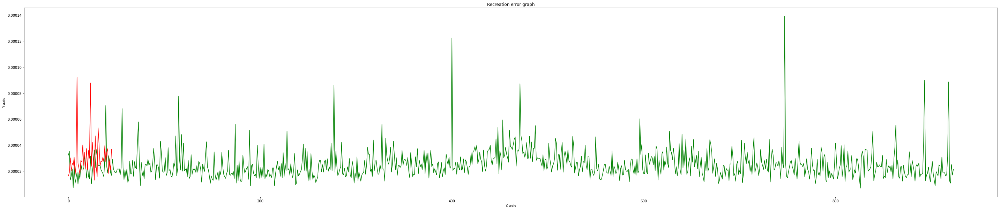

Total member in inlear: 924
Total False alarm: 876
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.98      0.05      0.10       924
           1       0.05      0.98      0.09        46

    accuracy                           0.10       970
   macro avg       0.51      0.52      0.10       970
weighted avg       0.94      0.10      0.10       970



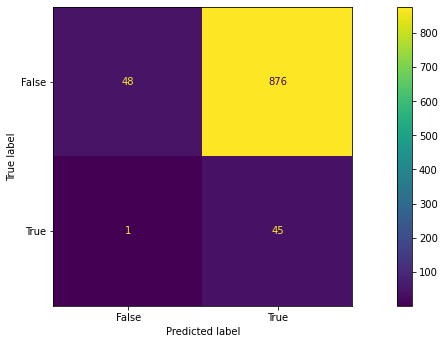

Epoch 1/200
24/24 [==============================] - 4s 123ms/step - loss: 0.1775 - val_loss: 0.0354
Epoch 2/200
24/24 [==============================] - 3s 116ms/step - loss: 0.0179 - val_loss: 0.0042
Epoch 3/200
24/24 [==============================] - 3s 114ms/step - loss: 0.0014 - val_loss: 2.7111e-04
Epoch 4/200
24/24 [==============================] - 3s 114ms/step - loss: 1.9629e-04 - val_loss: 1.1737e-04
Epoch 5/200
24/24 [==============================] - 3s 116ms/step - loss: 9.1385e-05 - val_loss: 7.1453e-05
Epoch 6/200
24/24 [==============================] - 3s 115ms/step - loss: 6.1814e-05 - val_loss: 5.1224e-05
Epoch 7/200
24/24 [==============================] - 3s 126ms/step - loss: 4.9160e-05 - val_loss: 4.2998e-05
Epoch 8/200
24/24 [==============================] - 4s 155ms/step - loss: 4.2123e-05 - val_loss: 4.3658e-05
Epoch 9/200
24/24 [==============================] - 3s 130ms/step - loss: 4.1859e-05 - val_loss: 4.6232e-05
Epoch 10/200
24/24 [===================

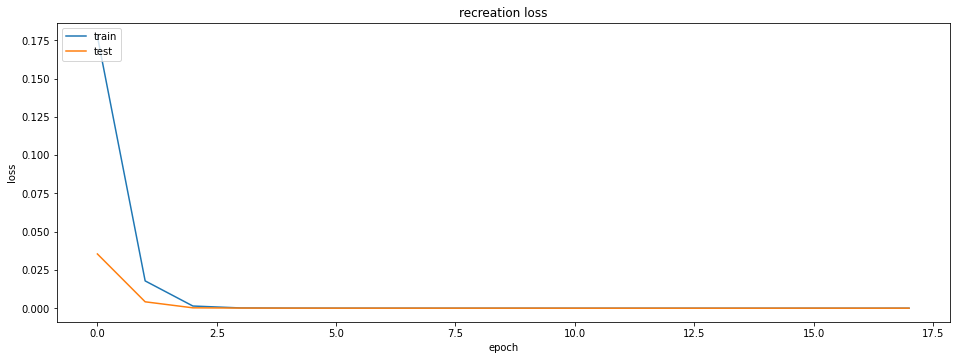

Intlier max value: 0.0001326274 Index Val: 56
outlier max value: 0.00012383115 Index Val: 9
outlier min value: 1.9334053e-05 Index Val: 21


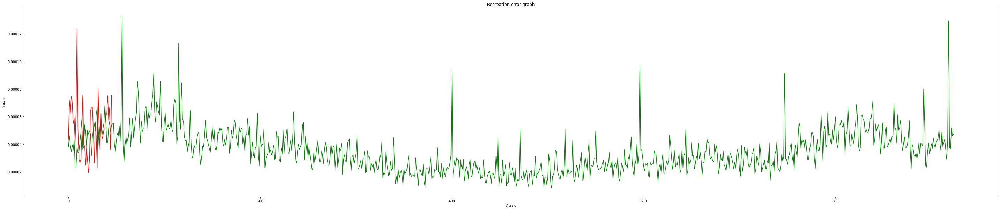

Total member in inlear: 924
Total False alarm: 793
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.99      0.14      0.25       924
           1       0.05      0.98      0.10        46

    accuracy                           0.18       970
   macro avg       0.52      0.56      0.17       970
weighted avg       0.95      0.18      0.24       970



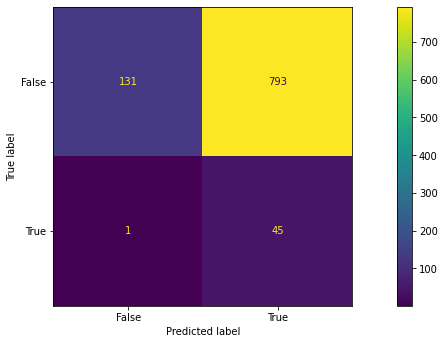

Epoch 1/200
24/24 [==============================] - 4s 124ms/step - loss: 0.1981 - val_loss: 0.0337
Epoch 2/200
24/24 [==============================] - 3s 121ms/step - loss: 0.0141 - val_loss: 0.0030
Epoch 3/200
24/24 [==============================] - 3s 120ms/step - loss: 0.0014 - val_loss: 3.8887e-04
Epoch 4/200
24/24 [==============================] - 3s 122ms/step - loss: 2.3033e-04 - val_loss: 1.3826e-04
Epoch 5/200
24/24 [==============================] - 3s 122ms/step - loss: 1.2861e-04 - val_loss: 9.3120e-05
Epoch 6/200
24/24 [==============================] - 3s 121ms/step - loss: 8.2262e-05 - val_loss: 7.6311e-05
Epoch 7/200
24/24 [==============================] - 3s 123ms/step - loss: 6.5797e-05 - val_loss: 5.6053e-05
Epoch 8/200
24/24 [==============================] - 3s 123ms/step - loss: 5.2748e-05 - val_loss: 5.3482e-05
Epoch 9/200
24/24 [==============================] - 3s 122ms/step - loss: 4.4505e-05 - val_loss: 3.9665e-05
Epoch 10/200
24/24 [===================

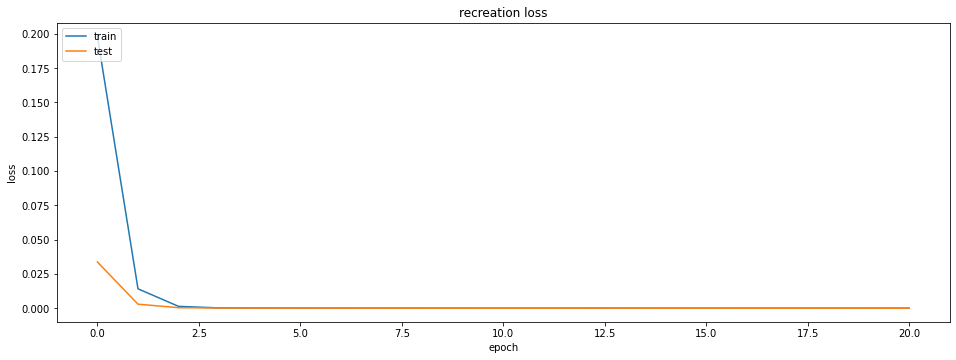

Intlier max value: 5.7516503e-05 Index Val: 400
outlier max value: 4.4896537e-05 Index Val: 9
outlier min value: 5.631483e-06 Index Val: 44


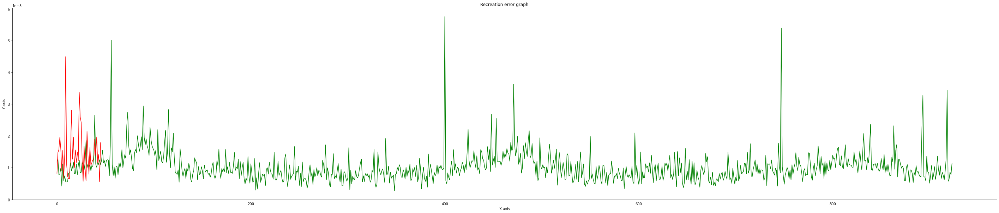

Total member in inlear: 924
Total False alarm: 840
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.99      0.09      0.17       924
           1       0.05      0.98      0.10        46

    accuracy                           0.13       970
   macro avg       0.52      0.53      0.13       970
weighted avg       0.94      0.13      0.16       970



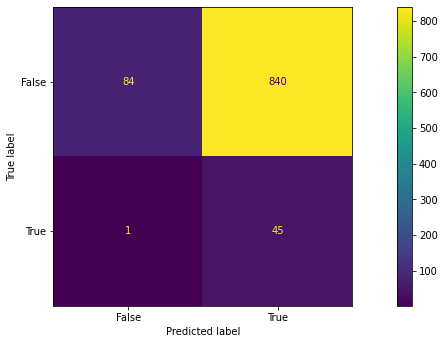

Epoch 1/200
24/24 [==============================] - 4s 130ms/step - loss: 0.1559 - val_loss: 0.0284
Epoch 2/200
24/24 [==============================] - 3s 136ms/step - loss: 0.0147 - val_loss: 0.0029
Epoch 3/200
24/24 [==============================] - 3s 127ms/step - loss: 0.0014 - val_loss: 4.4932e-04
Epoch 4/200
24/24 [==============================] - 3s 120ms/step - loss: 2.7660e-04 - val_loss: 1.5685e-04
Epoch 5/200
24/24 [==============================] - 3s 122ms/step - loss: 1.2091e-04 - val_loss: 9.8475e-05
Epoch 6/200
24/24 [==============================] - 3s 120ms/step - loss: 8.0742e-05 - val_loss: 7.2643e-05
Epoch 7/200
24/24 [==============================] - 3s 120ms/step - loss: 6.4458e-05 - val_loss: 6.3072e-05
Epoch 8/200
24/24 [==============================] - 3s 122ms/step - loss: 5.7300e-05 - val_loss: 6.5016e-05
Epoch 9/200
24/24 [==============================] - 3s 122ms/step - loss: 5.2169e-05 - val_loss: 4.8987e-05
Epoch 10/200
24/24 [===================

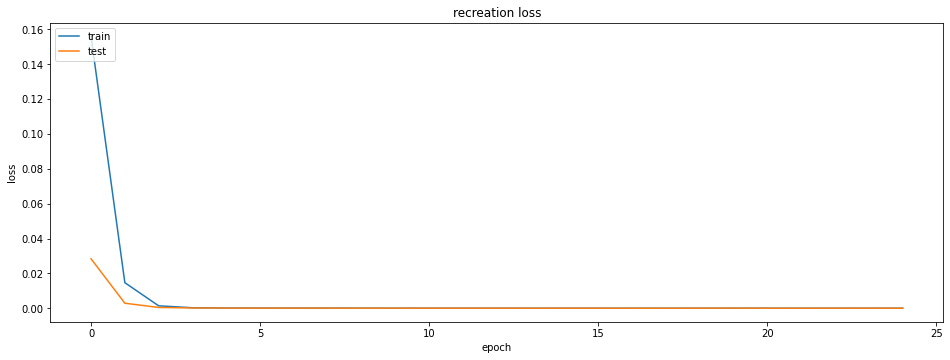

Intlier max value: 0.00014883101 Index Val: 747
outlier max value: 8.930792e-05 Index Val: 9
outlier min value: 1.8962675e-05 Index Val: 21


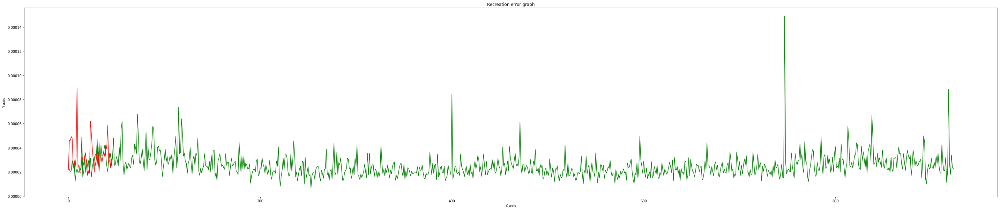

Total member in inlear: 924
Total False alarm: 700
Total member in Outlier: 46
Total missed true alarm: 2
              precision    recall  f1-score   support

           0       0.99      0.24      0.39       924
           1       0.06      0.96      0.11        46

    accuracy                           0.28       970
   macro avg       0.53      0.60      0.25       970
weighted avg       0.95      0.28      0.38       970



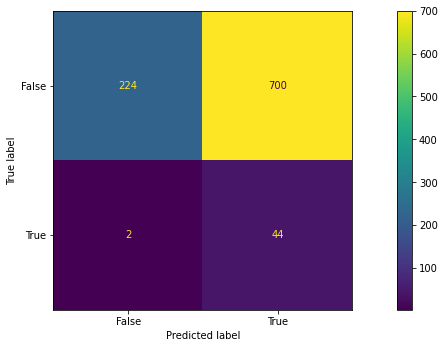

Epoch 1/200
24/24 [==============================] - 4s 127ms/step - loss: 0.1772 - val_loss: 0.0352
Epoch 2/200
24/24 [==============================] - 3s 121ms/step - loss: 0.0171 - val_loss: 0.0035
Epoch 3/200
24/24 [==============================] - 3s 120ms/step - loss: 0.0014 - val_loss: 4.3083e-04
Epoch 4/200
24/24 [==============================] - 3s 123ms/step - loss: 2.4851e-04 - val_loss: 1.3083e-04
Epoch 5/200
24/24 [==============================] - 3s 121ms/step - loss: 1.0760e-04 - val_loss: 9.6883e-05
Epoch 6/200
24/24 [==============================] - 3s 123ms/step - loss: 7.3992e-05 - val_loss: 6.9249e-05
Epoch 7/200
24/24 [==============================] - 3s 122ms/step - loss: 5.7998e-05 - val_loss: 6.3224e-05
Epoch 8/200
24/24 [==============================] - 3s 120ms/step - loss: 5.1282e-05 - val_loss: 5.9761e-05
Epoch 9/200
24/24 [==============================] - 3s 142ms/step - loss: 4.2086e-05 - val_loss: 4.0177e-05
Epoch 10/200
24/24 [===================

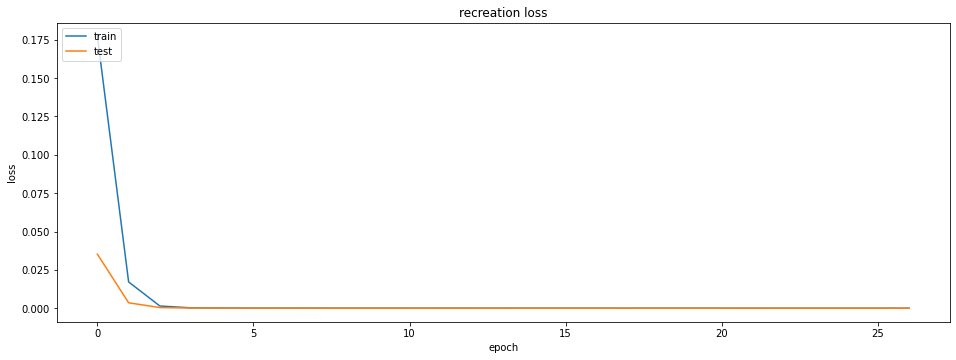

Intlier max value: 4.2811193e-05 Index Val: 56
outlier max value: 5.736661e-05 Index Val: 9
outlier min value: 3.5911314e-06 Index Val: 0


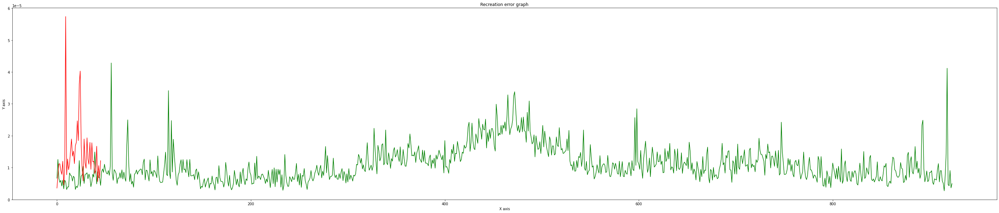

Total member in inlear: 924
Total False alarm: 914
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.91      0.01      0.02       924
           1       0.05      0.98      0.09        46

    accuracy                           0.06       970
   macro avg       0.48      0.49      0.06       970
weighted avg       0.87      0.06      0.02       970



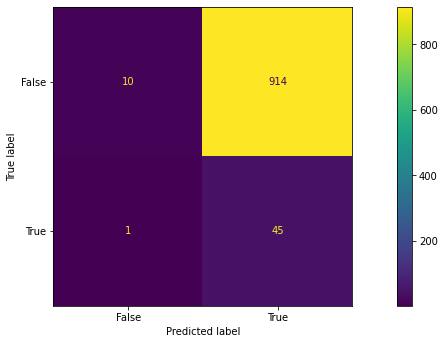

Epoch 1/200
24/24 [==============================] - 4s 132ms/step - loss: 0.2122 - val_loss: 0.0679
Epoch 2/200
24/24 [==============================] - 3s 126ms/step - loss: 0.0539 - val_loss: 0.0450
Epoch 3/200
24/24 [==============================] - 3s 122ms/step - loss: 0.0437 - val_loss: 0.0430
Epoch 4/200
24/24 [==============================] - 3s 123ms/step - loss: 0.0428 - val_loss: 0.0428
Epoch 5/200
24/24 [==============================] - 3s 122ms/step - loss: 0.0426 - val_loss: 0.0426
Epoch 6/200
24/24 [==============================] - 3s 124ms/step - loss: 0.0133 - val_loss: 0.0032
Epoch 7/200
24/24 [==============================] - 3s 124ms/step - loss: 9.9616e-04 - val_loss: 4.1698e-04
Epoch 8/200
24/24 [==============================] - 3s 123ms/step - loss: 2.0199e-04 - val_loss: 1.2788e-04
Epoch 9/200
24/24 [==============================] - 3s 125ms/step - loss: 1.0104e-04 - val_loss: 8.3612e-05
Epoch 10/200
24/24 [==============================] - 3s 125ms/step

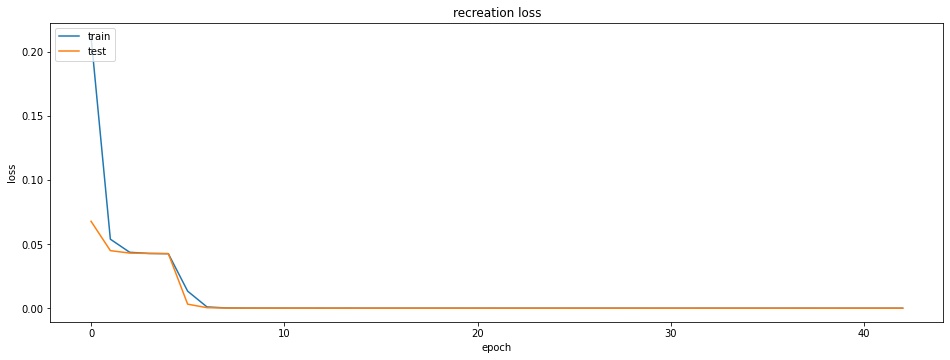

Intlier max value: 7.7915945e-05 Index Val: 747
outlier max value: 3.1074018e-05 Index Val: 23
outlier min value: 3.142713e-06 Index Val: 1


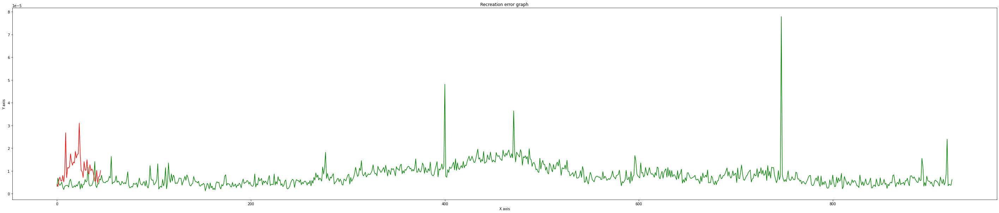

Total member in inlear: 924
Total False alarm: 875
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.98      0.05      0.10       924
           1       0.05      0.98      0.09        46

    accuracy                           0.10       970
   macro avg       0.51      0.52      0.10       970
weighted avg       0.94      0.10      0.10       970



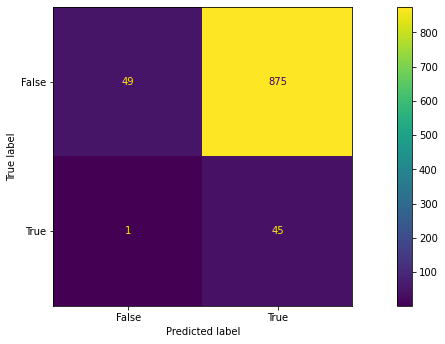

Epoch 1/200
24/24 [==============================] - 4s 132ms/step - loss: 0.2081 - val_loss: 0.0825
Epoch 2/200
24/24 [==============================] - 3s 126ms/step - loss: 0.0517 - val_loss: 0.0166
Epoch 3/200
24/24 [==============================] - 3s 126ms/step - loss: 0.0064 - val_loss: 9.4935e-04
Epoch 4/200
24/24 [==============================] - 3s 127ms/step - loss: 5.2748e-04 - val_loss: 2.5893e-04
Epoch 5/200
24/24 [==============================] - 3s 126ms/step - loss: 1.7161e-04 - val_loss: 1.2168e-04
Epoch 6/200
24/24 [==============================] - 3s 125ms/step - loss: 9.5539e-05 - val_loss: 6.9487e-05
Epoch 7/200
24/24 [==============================] - 4s 161ms/step - loss: 6.1060e-05 - val_loss: 6.3721e-05
Epoch 8/200
24/24 [==============================] - 3s 143ms/step - loss: 4.6855e-05 - val_loss: 4.2498e-05
Epoch 9/200
24/24 [==============================] - 3s 134ms/step - loss: 3.4312e-05 - val_loss: 3.3786e-05
Epoch 10/200
24/24 [===================

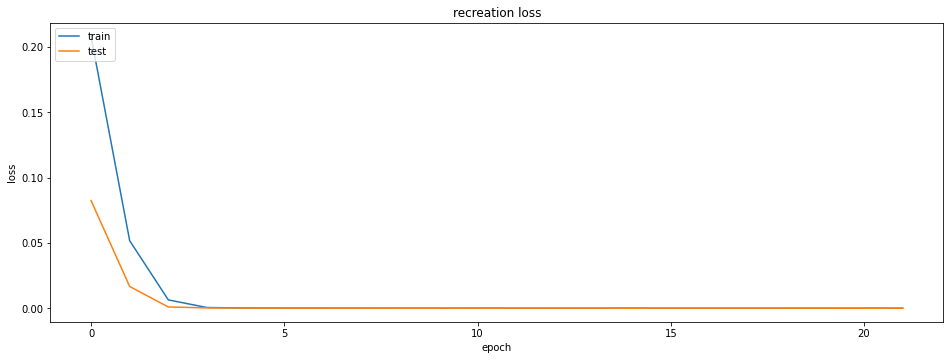

Intlier max value: 6.5619126e-05 Index Val: 472
outlier max value: 5.7551333e-05 Index Val: 21
outlier min value: 1.1295138e-05 Index Val: 1


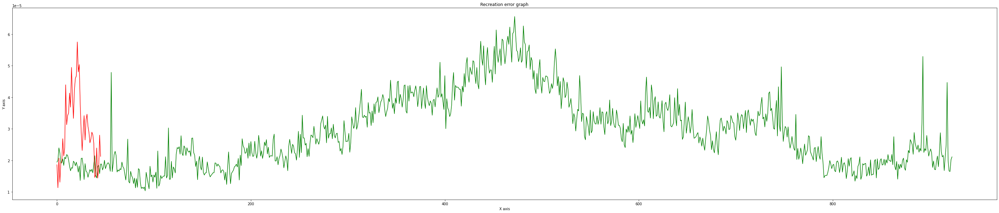

Total member in inlear: 924
Total False alarm: 918
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.86      0.01      0.01       924
           1       0.05      0.98      0.09        46

    accuracy                           0.05       970
   macro avg       0.45      0.49      0.05       970
weighted avg       0.82      0.05      0.02       970



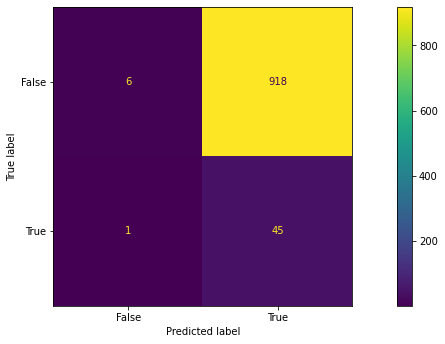

Epoch 1/200
24/24 [==============================] - 4s 132ms/step - loss: 0.1979 - val_loss: 0.0495
Epoch 2/200
24/24 [==============================] - 3s 126ms/step - loss: 0.0203 - val_loss: 0.0045
Epoch 3/200
24/24 [==============================] - 3s 128ms/step - loss: 0.0018 - val_loss: 4.0549e-04
Epoch 4/200
24/24 [==============================] - 3s 127ms/step - loss: 2.2630e-04 - val_loss: 1.3858e-04
Epoch 5/200
24/24 [==============================] - 3s 130ms/step - loss: 1.0817e-04 - val_loss: 8.6304e-05
Epoch 6/200
24/24 [==============================] - 3s 126ms/step - loss: 7.9990e-05 - val_loss: 7.4311e-05
Epoch 7/200
24/24 [==============================] - 3s 127ms/step - loss: 6.4426e-05 - val_loss: 7.0169e-05
Epoch 8/200
24/24 [==============================] - 3s 126ms/step - loss: 5.6754e-05 - val_loss: 5.2774e-05
Epoch 9/200
24/24 [==============================] - 3s 128ms/step - loss: 4.5415e-05 - val_loss: 3.9653e-05
Epoch 10/200
24/24 [===================

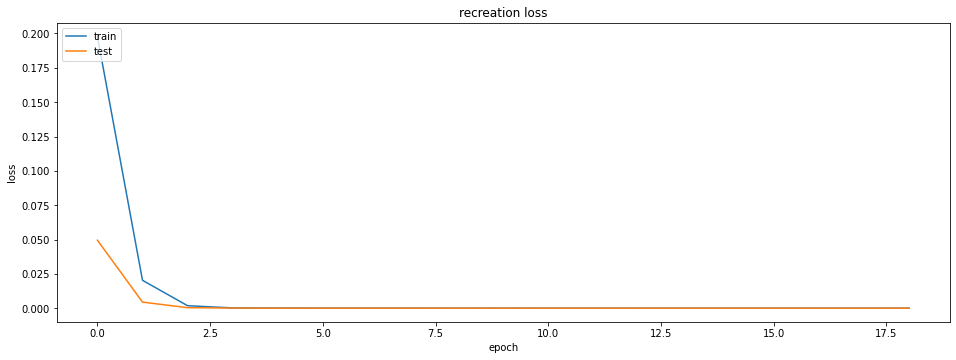

Intlier max value: 6.591484e-05 Index Val: 56
outlier max value: 8.7642286e-05 Index Val: 9
outlier min value: 1.1977e-05 Index Val: 30


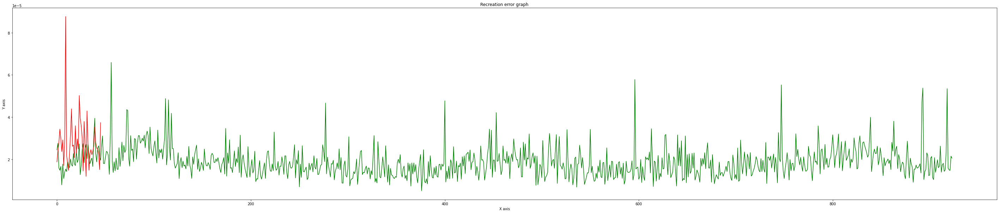

Total member in inlear: 924
Total False alarm: 778
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.99      0.16      0.27       924
           1       0.05      0.98      0.10        46

    accuracy                           0.20       970
   macro avg       0.52      0.57      0.19       970
weighted avg       0.95      0.20      0.26       970



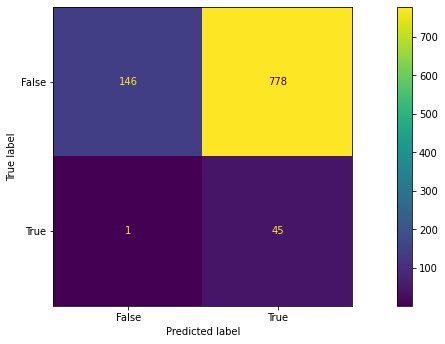

Epoch 1/200
24/24 [==============================] - 4s 134ms/step - loss: 0.1762 - val_loss: 0.0227
Epoch 2/200
24/24 [==============================] - 3s 129ms/step - loss: 0.0100 - val_loss: 0.0023
Epoch 3/200
24/24 [==============================] - 3s 129ms/step - loss: 0.0014 - val_loss: 3.5656e-04
Epoch 4/200
24/24 [==============================] - 3s 130ms/step - loss: 2.4429e-04 - val_loss: 1.5000e-04
Epoch 5/200
24/24 [==============================] - 3s 130ms/step - loss: 1.2549e-04 - val_loss: 1.1274e-04
Epoch 6/200
24/24 [==============================] - 3s 132ms/step - loss: 9.2232e-05 - val_loss: 7.7308e-05
Epoch 7/200
24/24 [==============================] - 3s 129ms/step - loss: 7.6819e-05 - val_loss: 6.8241e-05
Epoch 8/200
24/24 [==============================] - 3s 128ms/step - loss: 6.5934e-05 - val_loss: 6.2685e-05
Epoch 9/200
24/24 [==============================] - 3s 126ms/step - loss: 5.7984e-05 - val_loss: 6.1392e-05
Epoch 10/200
24/24 [===================

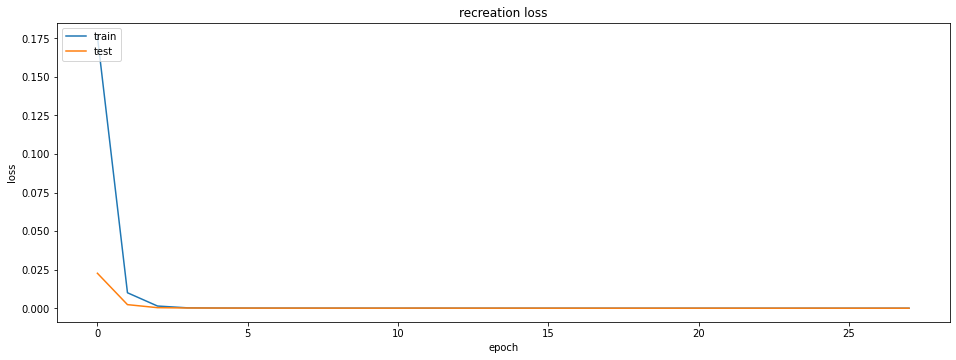

Intlier max value: 6.1614635e-05 Index Val: 400
outlier max value: 2.7994258e-05 Index Val: 24
outlier min value: 2.5108966e-06 Index Val: 27


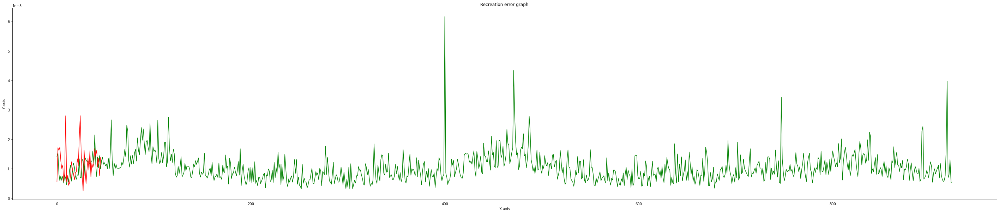

Total member in inlear: 924
Total False alarm: 924
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       924
           1       0.05      0.98      0.09        46

    accuracy                           0.05       970
   macro avg       0.02      0.49      0.04       970
weighted avg       0.00      0.05      0.00       970



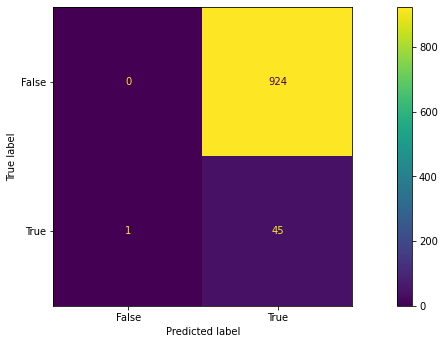

Epoch 1/200
24/24 [==============================] - 4s 132ms/step - loss: 0.2139 - val_loss: 0.0489
Epoch 2/200
24/24 [==============================] - 3s 127ms/step - loss: 0.0201 - val_loss: 0.0044
Epoch 3/200
24/24 [==============================] - 3s 127ms/step - loss: 0.0022 - val_loss: 5.0145e-04
Epoch 4/200
24/24 [==============================] - 3s 127ms/step - loss: 3.0643e-04 - val_loss: 1.6582e-04
Epoch 5/200
24/24 [==============================] - 3s 129ms/step - loss: 1.2901e-04 - val_loss: 1.0351e-04
Epoch 6/200
24/24 [==============================] - 3s 126ms/step - loss: 8.8475e-05 - val_loss: 7.2262e-05
Epoch 7/200
24/24 [==============================] - 3s 127ms/step - loss: 6.8600e-05 - val_loss: 6.1890e-05
Epoch 8/200
24/24 [==============================] - 3s 127ms/step - loss: 5.4548e-05 - val_loss: 5.5242e-05
Epoch 9/200
24/24 [==============================] - 3s 128ms/step - loss: 4.7017e-05 - val_loss: 5.4698e-05
Epoch 10/200
24/24 [===================

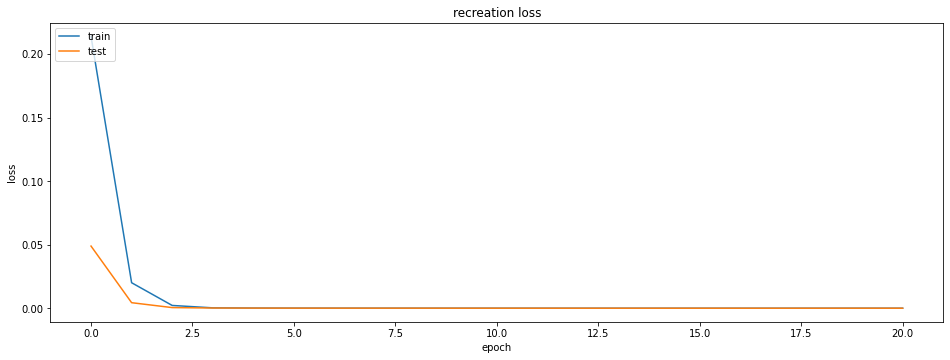

Intlier max value: 7.2206756e-05 Index Val: 918
outlier max value: 6.858376e-05 Index Val: 9
outlier min value: 9.860397e-06 Index Val: 27


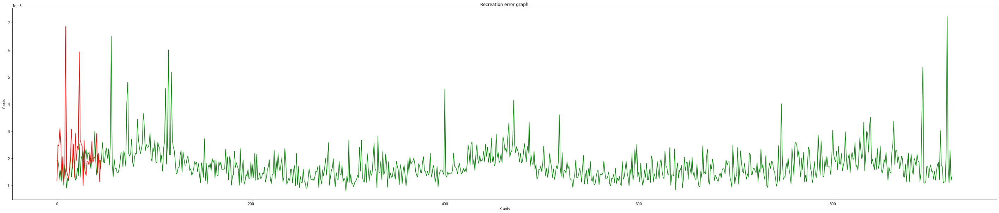

Total member in inlear: 924
Total False alarm: 900
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.96      0.03      0.05       924
           1       0.05      0.98      0.09        46

    accuracy                           0.07       970
   macro avg       0.50      0.50      0.07       970
weighted avg       0.92      0.07      0.05       970



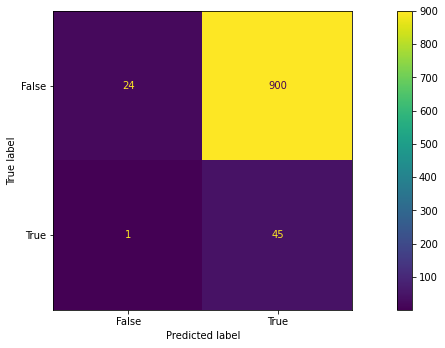

Epoch 1/200
24/24 [==============================] - 4s 135ms/step - loss: 0.1713 - val_loss: 0.0366
Epoch 2/200
24/24 [==============================] - 3s 132ms/step - loss: 0.0167 - val_loss: 0.0027
Epoch 3/200
24/24 [==============================] - 3s 129ms/step - loss: 0.0011 - val_loss: 3.1682e-04
Epoch 4/200
24/24 [==============================] - 3s 129ms/step - loss: 1.8688e-04 - val_loss: 1.2183e-04
Epoch 5/200
24/24 [==============================] - 3s 130ms/step - loss: 9.9181e-05 - val_loss: 9.8212e-05
Epoch 6/200
24/24 [==============================] - 3s 130ms/step - loss: 7.1059e-05 - val_loss: 5.8752e-05
Epoch 7/200
24/24 [==============================] - 3s 130ms/step - loss: 5.2202e-05 - val_loss: 5.4206e-05
Epoch 8/200
24/24 [==============================] - 3s 130ms/step - loss: 4.2809e-05 - val_loss: 5.5313e-05
Epoch 9/200
24/24 [==============================] - 3s 129ms/step - loss: 3.7024e-05 - val_loss: 2.7400e-05
Epoch 10/200
24/24 [===================

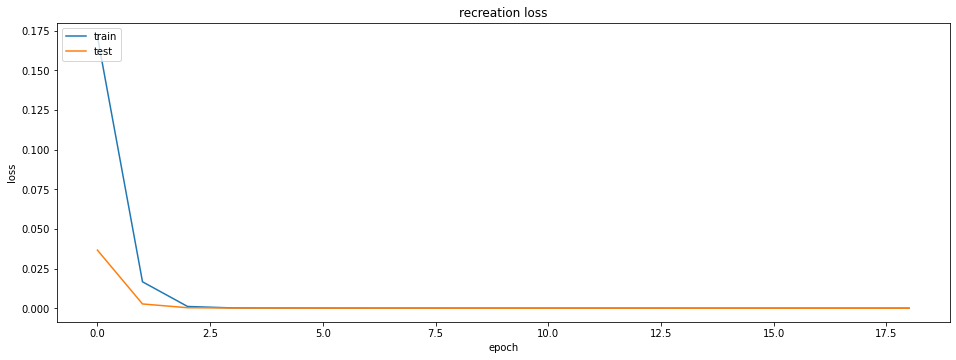

Intlier max value: 8.696986e-05 Index Val: 56
outlier max value: 8.811373e-05 Index Val: 9
outlier min value: 6.723877e-06 Index Val: 21


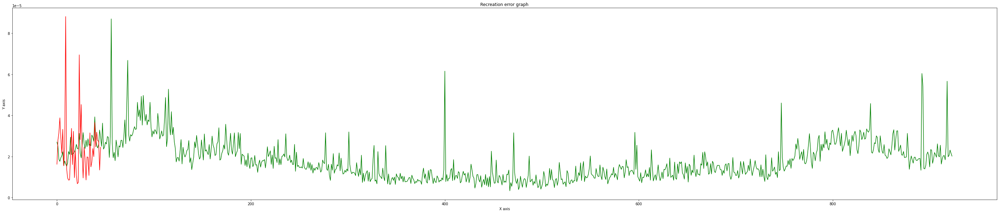

Total member in inlear: 924
Total False alarm: 888
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.97      0.04      0.07       924
           1       0.05      0.98      0.09        46

    accuracy                           0.08       970
   macro avg       0.51      0.51      0.08       970
weighted avg       0.93      0.08      0.08       970



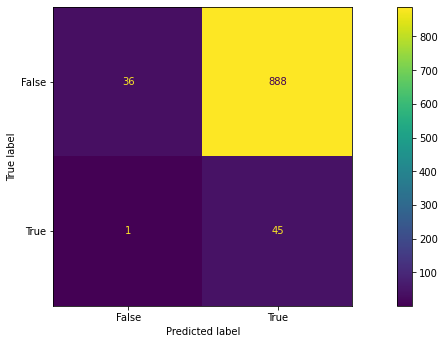

Epoch 1/200
24/24 [==============================] - 4s 138ms/step - loss: 0.2330 - val_loss: 0.0229
Epoch 2/200
24/24 [==============================] - 3s 146ms/step - loss: 0.0088 - val_loss: 0.0025
Epoch 3/200
24/24 [==============================] - 4s 153ms/step - loss: 0.0011 - val_loss: 2.4835e-04
Epoch 4/200
24/24 [==============================] - 3s 136ms/step - loss: 1.6567e-04 - val_loss: 1.0655e-04
Epoch 5/200
24/24 [==============================] - 3s 134ms/step - loss: 8.7308e-05 - val_loss: 8.1561e-05
Epoch 6/200
24/24 [==============================] - 3s 138ms/step - loss: 7.1922e-05 - val_loss: 5.9821e-05
Epoch 7/200
24/24 [==============================] - 3s 131ms/step - loss: 5.7384e-05 - val_loss: 5.1204e-05
Epoch 8/200
24/24 [==============================] - 3s 136ms/step - loss: 4.8707e-05 - val_loss: 4.9962e-05
Epoch 9/200
24/24 [==============================] - 3s 136ms/step - loss: 3.9807e-05 - val_loss: 3.5731e-05
Epoch 10/200
24/24 [===================

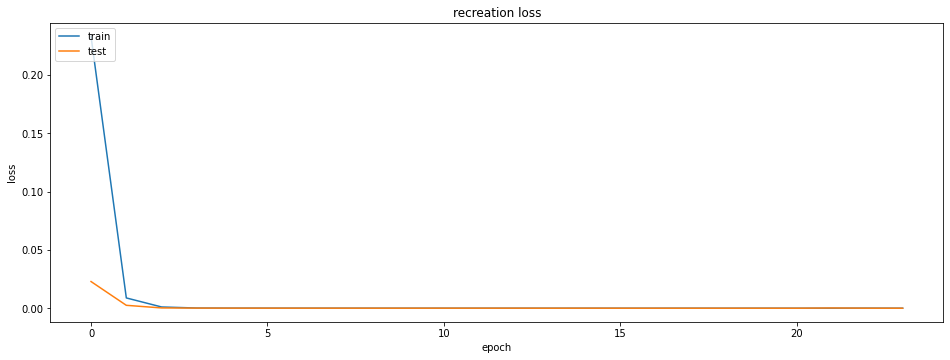

Intlier max value: 0.00012060825 Index Val: 747
outlier max value: 4.5538338e-05 Index Val: 22
outlier min value: 1.2041656e-05 Index Val: 1


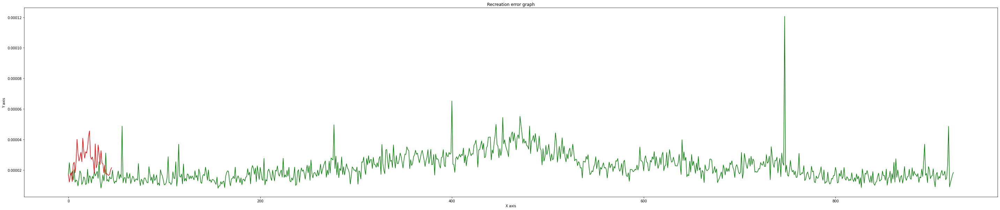

Total member in inlear: 924
Total False alarm: 842
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.99      0.09      0.16       924
           1       0.05      0.98      0.10        46

    accuracy                           0.13       970
   macro avg       0.52      0.53      0.13       970
weighted avg       0.94      0.13      0.16       970



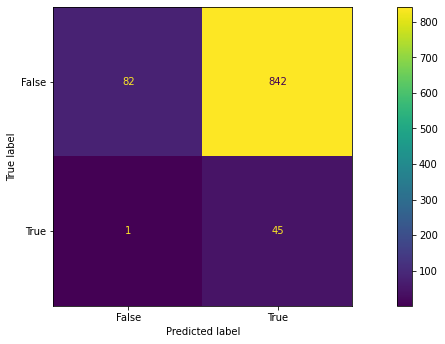

Epoch 1/200
24/24 [==============================] - 4s 138ms/step - loss: 0.2500 - val_loss: 0.0750
Epoch 2/200
24/24 [==============================] - 3s 135ms/step - loss: 0.0438 - val_loss: 0.0137
Epoch 3/200
24/24 [==============================] - 3s 132ms/step - loss: 0.0053 - val_loss: 0.0010
Epoch 4/200
24/24 [==============================] - 3s 134ms/step - loss: 5.5894e-04 - val_loss: 2.5931e-04
Epoch 5/200
24/24 [==============================] - 3s 134ms/step - loss: 1.8055e-04 - val_loss: 1.1851e-04
Epoch 6/200
24/24 [==============================] - 3s 134ms/step - loss: 9.8165e-05 - val_loss: 7.6734e-05
Epoch 7/200
24/24 [==============================] - 3s 137ms/step - loss: 6.8909e-05 - val_loss: 6.4028e-05
Epoch 8/200
24/24 [==============================] - 3s 133ms/step - loss: 5.4770e-05 - val_loss: 5.0560e-05
Epoch 9/200
24/24 [==============================] - 3s 134ms/step - loss: 4.5160e-05 - val_loss: 4.9096e-05
Epoch 10/200
24/24 [=======================

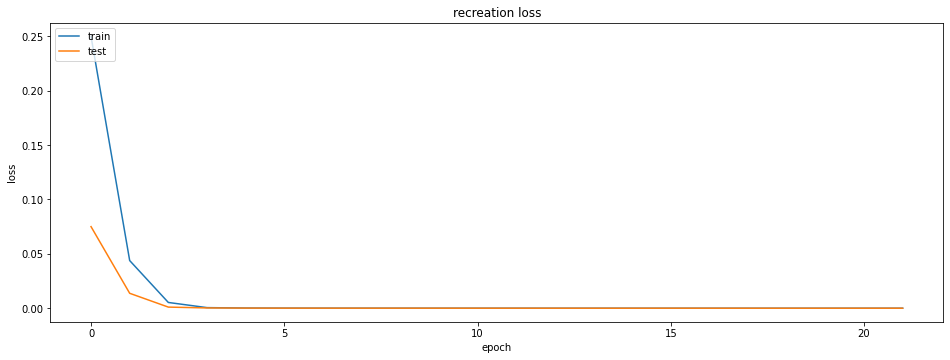

Intlier max value: 8.228617e-05 Index Val: 453
outlier max value: 7.016819e-05 Index Val: 21
outlier min value: 1.3084657e-05 Index Val: 1


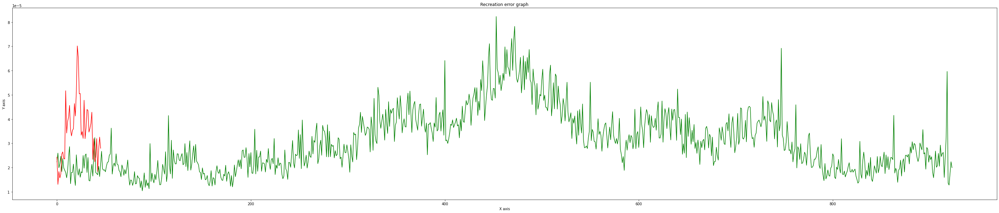

Total member in inlear: 924
Total False alarm: 908
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.94      0.02      0.03       924
           1       0.05      0.98      0.09        46

    accuracy                           0.06       970
   macro avg       0.49      0.50      0.06       970
weighted avg       0.90      0.06      0.04       970



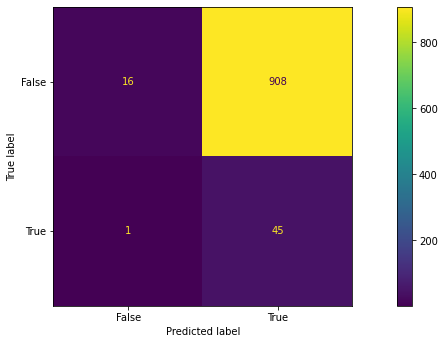

Epoch 1/200
24/24 [==============================] - 4s 139ms/step - loss: 0.1511 - val_loss: 0.0214
Epoch 2/200
24/24 [==============================] - 3s 134ms/step - loss: 0.0081 - val_loss: 0.0016
Epoch 3/200
24/24 [==============================] - 3s 133ms/step - loss: 7.3772e-04 - val_loss: 2.9446e-04
Epoch 4/200
24/24 [==============================] - 3s 131ms/step - loss: 2.0717e-04 - val_loss: 1.4289e-04
Epoch 5/200
24/24 [==============================] - 3s 136ms/step - loss: 1.1394e-04 - val_loss: 1.0525e-04
Epoch 6/200
24/24 [==============================] - 3s 135ms/step - loss: 8.1293e-05 - val_loss: 6.8204e-05
Epoch 7/200
24/24 [==============================] - 3s 134ms/step - loss: 6.1489e-05 - val_loss: 5.5198e-05
Epoch 8/200
24/24 [==============================] - 3s 133ms/step - loss: 5.0106e-05 - val_loss: 5.0635e-05
Epoch 9/200
24/24 [==============================] - 3s 134ms/step - loss: 4.1740e-05 - val_loss: 3.9649e-05
Epoch 10/200
24/24 [===============

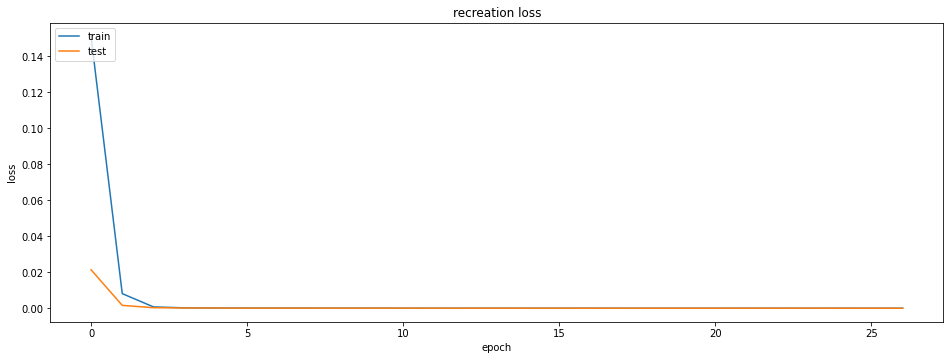

Intlier max value: 6.4850254e-05 Index Val: 400
outlier max value: 7.76453e-05 Index Val: 9
outlier min value: 1.0477417e-05 Index Val: 22


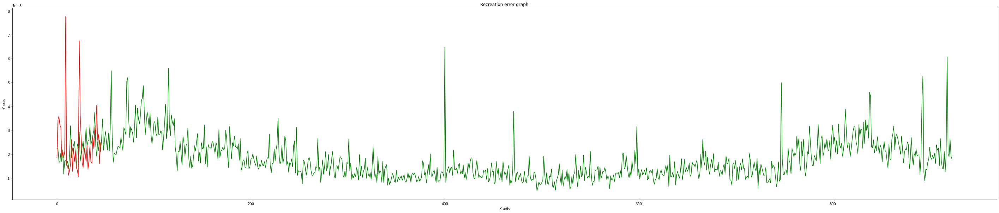

Total member in inlear: 924
Total False alarm: 762
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.99      0.18      0.30       924
           1       0.06      0.98      0.11        46

    accuracy                           0.21       970
   macro avg       0.52      0.58      0.20       970
weighted avg       0.95      0.21      0.29       970



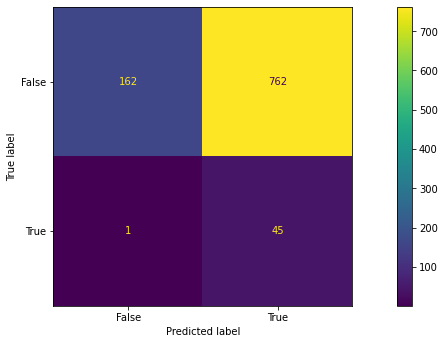

Epoch 1/200
24/24 [==============================] - 4s 139ms/step - loss: 0.1811 - val_loss: 0.0426
Epoch 2/200
24/24 [==============================] - 3s 133ms/step - loss: 0.0200 - val_loss: 0.0046
Epoch 3/200
24/24 [==============================] - 3s 133ms/step - loss: 0.0016 - val_loss: 3.6645e-04
Epoch 4/200
24/24 [==============================] - 3s 133ms/step - loss: 2.1599e-04 - val_loss: 1.4880e-04
Epoch 5/200
24/24 [==============================] - 3s 134ms/step - loss: 1.0230e-04 - val_loss: 8.1604e-05
Epoch 6/200
24/24 [==============================] - 3s 138ms/step - loss: 6.7070e-05 - val_loss: 7.3057e-05
Epoch 7/200
24/24 [==============================] - 3s 130ms/step - loss: 5.8979e-05 - val_loss: 6.3762e-05
Epoch 8/200
24/24 [==============================] - 3s 129ms/step - loss: 4.3471e-05 - val_loss: 4.9509e-05
Epoch 9/200
24/24 [==============================] - 3s 141ms/step - loss: 3.6252e-05 - val_loss: 4.0270e-05
Epoch 10/200
24/24 [===================

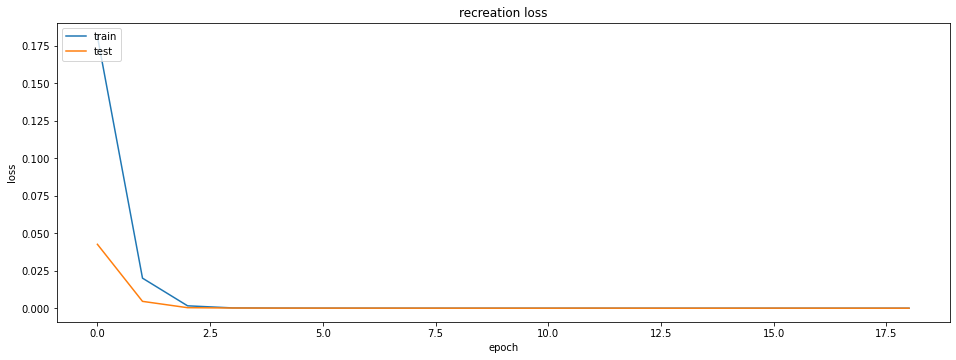

Intlier max value: 8.401459e-05 Index Val: 747
outlier max value: 7.215141e-05 Index Val: 9
outlier min value: 1.8976752e-05 Index Val: 42


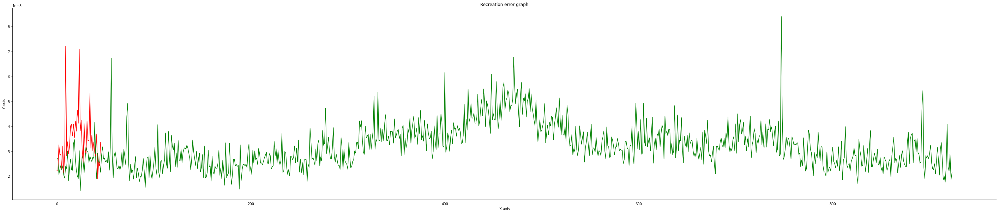

Total member in inlear: 924
Total False alarm: 902
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.96      0.02      0.05       924
           1       0.05      0.98      0.09        46

    accuracy                           0.07       970
   macro avg       0.50      0.50      0.07       970
weighted avg       0.91      0.07      0.05       970



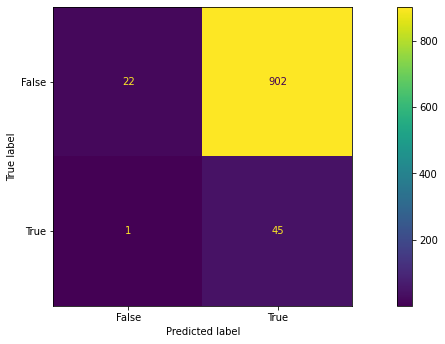

Epoch 1/200
24/24 [==============================] - 4s 142ms/step - loss: 0.2023 - val_loss: 0.0548
Epoch 2/200
24/24 [==============================] - 3s 135ms/step - loss: 0.0211 - val_loss: 0.0046
Epoch 3/200
24/24 [==============================] - 3s 132ms/step - loss: 0.0022 - val_loss: 7.4630e-04
Epoch 4/200
24/24 [==============================] - 3s 134ms/step - loss: 4.0252e-04 - val_loss: 1.8865e-04
Epoch 5/200
24/24 [==============================] - 3s 130ms/step - loss: 1.4828e-04 - val_loss: 1.0279e-04
Epoch 6/200
24/24 [==============================] - 3s 133ms/step - loss: 9.2741e-05 - val_loss: 9.1190e-05
Epoch 7/200
24/24 [==============================] - 3s 136ms/step - loss: 6.9401e-05 - val_loss: 7.3463e-05
Epoch 8/200
24/24 [==============================] - 3s 134ms/step - loss: 5.4337e-05 - val_loss: 5.2790e-05
Epoch 9/200
24/24 [==============================] - 3s 133ms/step - loss: 4.4940e-05 - val_loss: 4.2487e-05
Epoch 10/200
24/24 [===================

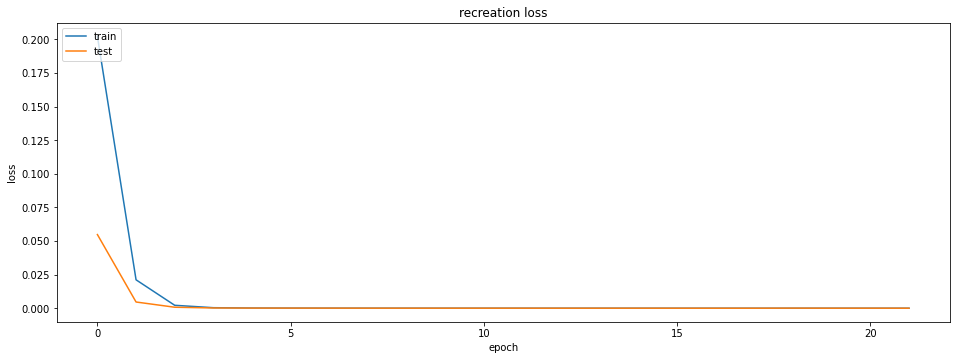

Intlier max value: 8.3896295e-05 Index Val: 918
outlier max value: 5.250614e-05 Index Val: 23
outlier min value: 4.9040345e-06 Index Val: 27


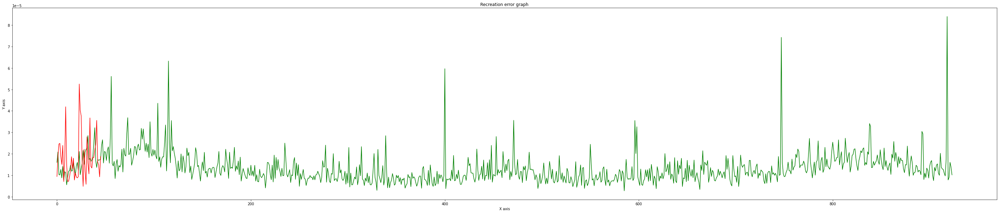

Total member in inlear: 924
Total False alarm: 904
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.95      0.02      0.04       924
           1       0.05      0.98      0.09        46

    accuracy                           0.07       970
   macro avg       0.50      0.50      0.07       970
weighted avg       0.91      0.07      0.04       970



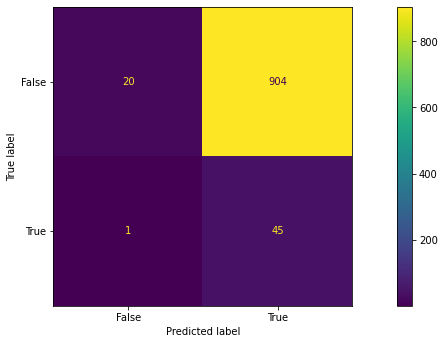

Epoch 1/200
24/24 [==============================] - 4s 142ms/step - loss: 0.2959 - val_loss: 0.0930
Epoch 2/200
24/24 [==============================] - 3s 136ms/step - loss: 0.0197 - val_loss: 0.0027
Epoch 3/200
24/24 [==============================] - 3s 133ms/step - loss: 0.0015 - val_loss: 4.7780e-04
Epoch 4/200
24/24 [==============================] - 3s 138ms/step - loss: 3.0474e-04 - val_loss: 1.7741e-04
Epoch 5/200
24/24 [==============================] - 3s 134ms/step - loss: 1.3761e-04 - val_loss: 1.0190e-04
Epoch 6/200
24/24 [==============================] - 3s 133ms/step - loss: 8.6114e-05 - val_loss: 7.2552e-05
Epoch 7/200
24/24 [==============================] - 3s 133ms/step - loss: 6.5873e-05 - val_loss: 6.4344e-05
Epoch 8/200
24/24 [==============================] - 3s 130ms/step - loss: 6.1561e-05 - val_loss: 9.0495e-05
Epoch 9/200
24/24 [==============================] - 3s 135ms/step - loss: 5.4861e-05 - val_loss: 7.0641e-05
Epoch 10/200
24/24 [===================

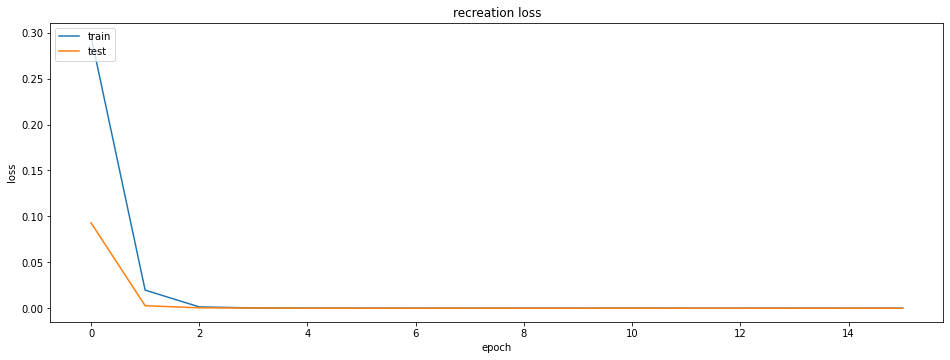

Intlier max value: 0.00024054977 Index Val: 400
outlier max value: 0.0001649395 Index Val: 24
outlier min value: 8.493064e-05 Index Val: 42


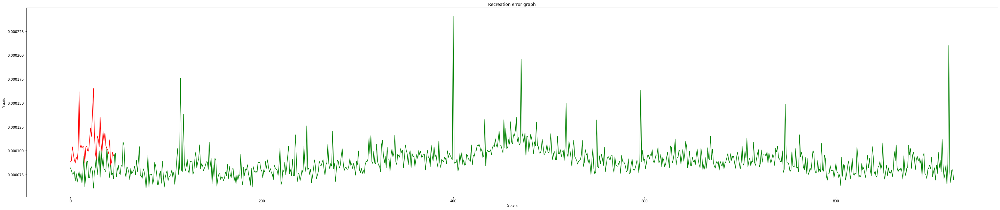

Total member in inlear: 924
Total False alarm: 493
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       1.00      0.47      0.64       924
           1       0.08      0.98      0.15        46

    accuracy                           0.49       970
   macro avg       0.54      0.72      0.39       970
weighted avg       0.95      0.49      0.61       970



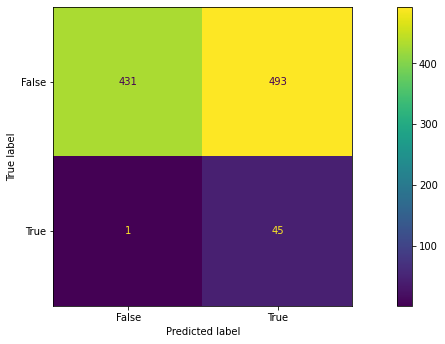

Epoch 1/200
24/24 [==============================] - 5s 171ms/step - loss: 0.1565 - val_loss: 0.0471
Epoch 2/200
24/24 [==============================] - 4s 153ms/step - loss: 0.0225 - val_loss: 0.0048
Epoch 3/200
24/24 [==============================] - 3s 134ms/step - loss: 0.0019 - val_loss: 4.2456e-04
Epoch 4/200
24/24 [==============================] - 3s 139ms/step - loss: 2.5791e-04 - val_loss: 1.6243e-04
Epoch 5/200
24/24 [==============================] - 3s 135ms/step - loss: 1.3073e-04 - val_loss: 1.0139e-04
Epoch 6/200
24/24 [==============================] - 3s 136ms/step - loss: 8.8216e-05 - val_loss: 7.1423e-05
Epoch 7/200
24/24 [==============================] - 3s 135ms/step - loss: 6.4095e-05 - val_loss: 6.8089e-05
Epoch 8/200
24/24 [==============================] - 3s 137ms/step - loss: 5.8961e-05 - val_loss: 4.7358e-05
Epoch 9/200
24/24 [==============================] - 3s 141ms/step - loss: 4.4121e-05 - val_loss: 4.0493e-05
Epoch 10/200
24/24 [===================

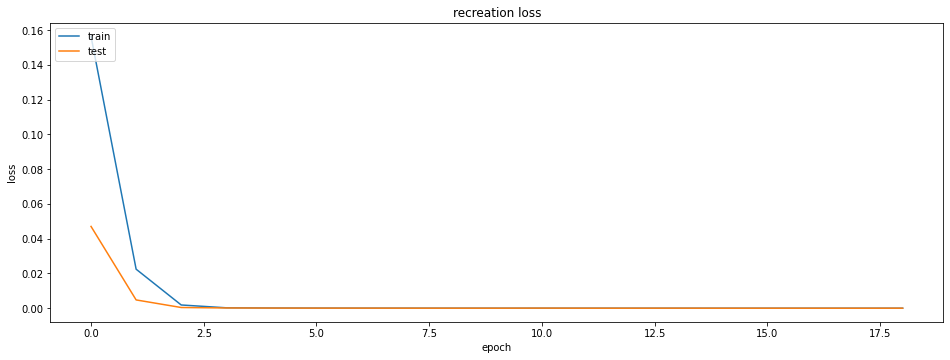

Intlier max value: 0.00014482942 Index Val: 56
outlier max value: 0.00017352 Index Val: 9
outlier min value: 2.3357388e-05 Index Val: 27


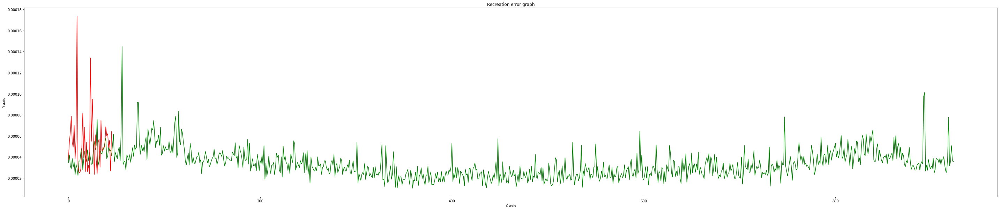

Total member in inlear: 924
Total False alarm: 703
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       1.00      0.24      0.39       924
           1       0.06      0.98      0.11        46

    accuracy                           0.27       970
   macro avg       0.53      0.61      0.25       970
weighted avg       0.95      0.27      0.37       970



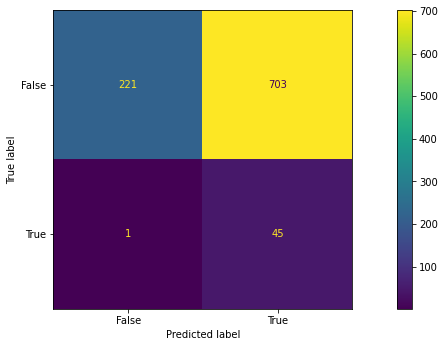

Epoch 1/200
24/24 [==============================] - 4s 147ms/step - loss: 0.2736 - val_loss: 0.1507
Epoch 2/200
24/24 [==============================] - 3s 136ms/step - loss: 0.1287 - val_loss: 0.0977
Epoch 3/200
24/24 [==============================] - 3s 137ms/step - loss: 0.0639 - val_loss: 0.0256
Epoch 4/200
24/24 [==============================] - 3s 135ms/step - loss: 0.0101 - val_loss: 9.2452e-04
Epoch 5/200
24/24 [==============================] - 3s 132ms/step - loss: 4.9322e-04 - val_loss: 3.0192e-04
Epoch 6/200
24/24 [==============================] - 3s 134ms/step - loss: 1.7665e-04 - val_loss: 1.3403e-04
Epoch 7/200
24/24 [==============================] - 3s 136ms/step - loss: 9.3387e-05 - val_loss: 7.7738e-05
Epoch 8/200
24/24 [==============================] - 3s 137ms/step - loss: 6.1306e-05 - val_loss: 6.1604e-05
Epoch 9/200
24/24 [==============================] - 3s 136ms/step - loss: 4.8540e-05 - val_loss: 4.6969e-05
Epoch 10/200
24/24 [===========================

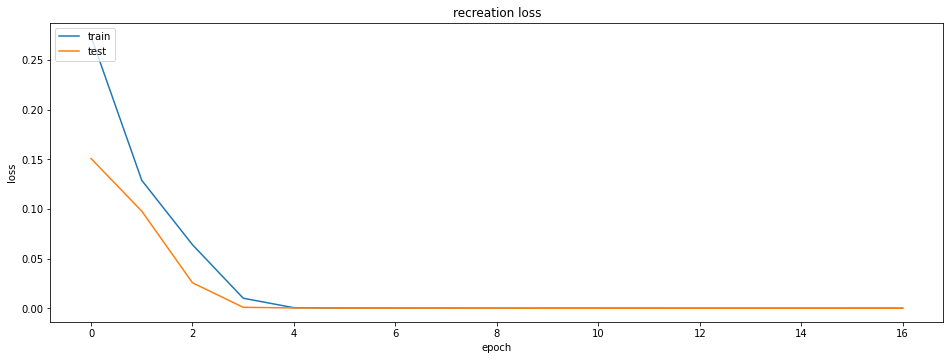

Intlier max value: 7.654036e-05 Index Val: 918
outlier max value: 0.00010352407 Index Val: 9
outlier min value: 1.0022886e-05 Index Val: 7


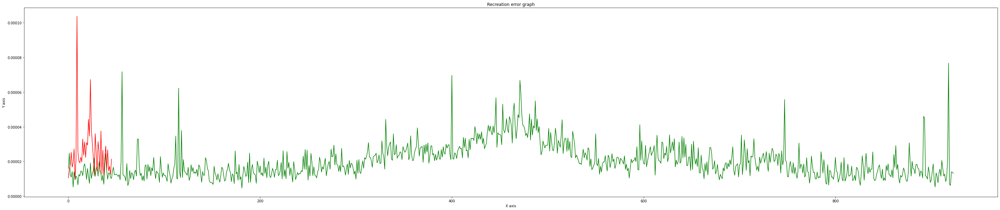

Total member in inlear: 924
Total False alarm: 841
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.99      0.09      0.16       924
           1       0.05      0.98      0.10        46

    accuracy                           0.13       970
   macro avg       0.52      0.53      0.13       970
weighted avg       0.94      0.13      0.16       970



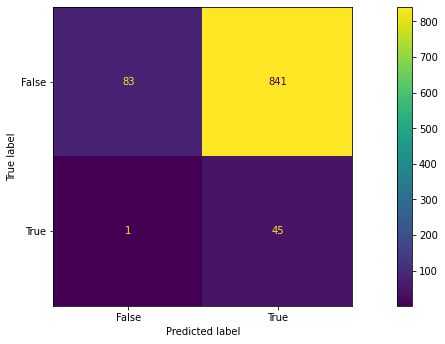

Epoch 1/200
24/24 [==============================] - 4s 149ms/step - loss: 0.1645 - val_loss: 0.0233
Epoch 2/200
24/24 [==============================] - 3s 136ms/step - loss: 0.0097 - val_loss: 0.0023
Epoch 3/200
24/24 [==============================] - 3s 136ms/step - loss: 0.0011 - val_loss: 3.8614e-04
Epoch 4/200
24/24 [==============================] - 3s 137ms/step - loss: 2.7431e-04 - val_loss: 1.6694e-04
Epoch 5/200
24/24 [==============================] - 3s 132ms/step - loss: 1.2610e-04 - val_loss: 1.0068e-04
Epoch 6/200
24/24 [==============================] - 3s 137ms/step - loss: 7.5324e-05 - val_loss: 6.0527e-05
Epoch 7/200
24/24 [==============================] - 3s 131ms/step - loss: 4.8713e-05 - val_loss: 5.4722e-05
Epoch 8/200
24/24 [==============================] - 3s 135ms/step - loss: 3.7996e-05 - val_loss: 3.1526e-05
Epoch 9/200
24/24 [==============================] - 3s 136ms/step - loss: 3.1949e-05 - val_loss: 3.4535e-05
Epoch 10/200
24/24 [===================

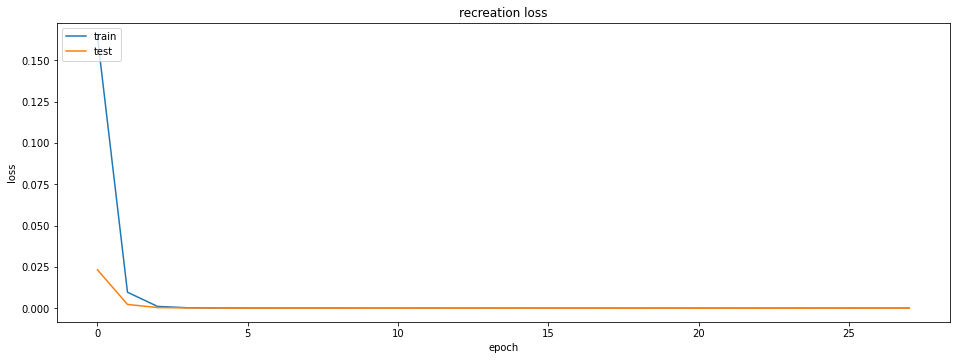

Intlier max value: 5.9568265e-05 Index Val: 56
outlier max value: 7.424461e-05 Index Val: 9
outlier min value: 1.1379845e-05 Index Val: 30


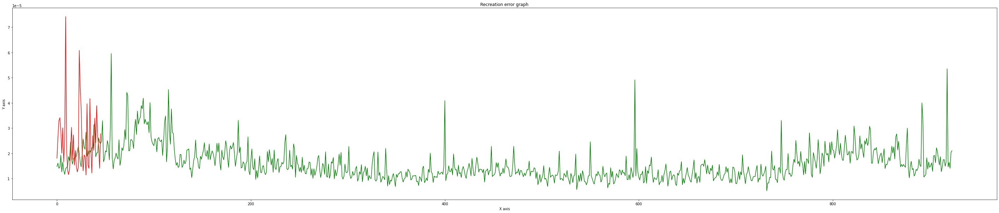

Total member in inlear: 924
Total False alarm: 674
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       1.00      0.27      0.43       924
           1       0.06      0.98      0.12        46

    accuracy                           0.30       970
   macro avg       0.53      0.62      0.27       970
weighted avg       0.95      0.30      0.41       970



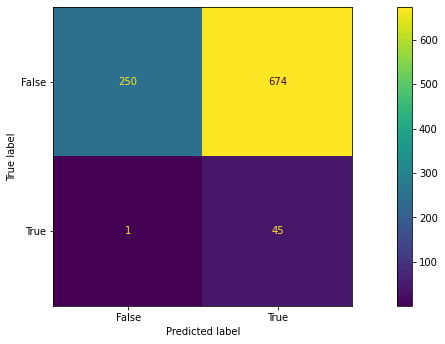

Epoch 1/200
24/24 [==============================] - 4s 149ms/step - loss: 0.1513 - val_loss: 0.0408
Epoch 2/200
24/24 [==============================] - 3s 134ms/step - loss: 0.0176 - val_loss: 0.0043
Epoch 3/200
24/24 [==============================] - 3s 136ms/step - loss: 0.0016 - val_loss: 3.7154e-04
Epoch 4/200
24/24 [==============================] - 3s 137ms/step - loss: 2.1276e-04 - val_loss: 1.1934e-04
Epoch 5/200
24/24 [==============================] - 3s 139ms/step - loss: 9.2463e-05 - val_loss: 6.8437e-05
Epoch 6/200
24/24 [==============================] - 3s 138ms/step - loss: 5.5226e-05 - val_loss: 4.8149e-05
Epoch 7/200
24/24 [==============================] - 3s 138ms/step - loss: 4.1533e-05 - val_loss: 4.1239e-05
Epoch 8/200
24/24 [==============================] - 3s 141ms/step - loss: 3.7318e-05 - val_loss: 4.5144e-05
Epoch 9/200
24/24 [==============================] - 3s 139ms/step - loss: 3.4790e-05 - val_loss: 4.0606e-05
Epoch 10/200
24/24 [===================

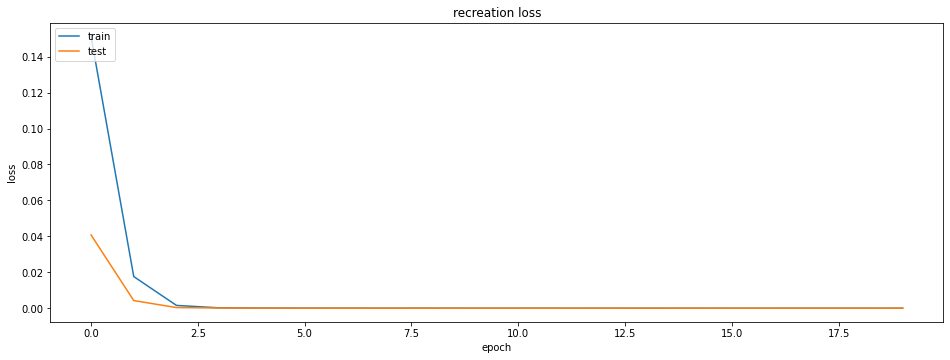

Intlier max value: 7.4967786e-05 Index Val: 56
outlier max value: 6.141927e-05 Index Val: 9
outlier min value: 5.780929e-06 Index Val: 20


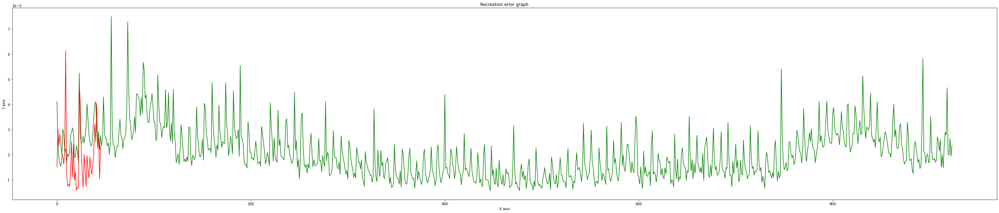

Total member in inlear: 924
Total False alarm: 921
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.75      0.00      0.01       924
           1       0.05      0.98      0.09        46

    accuracy                           0.05       970
   macro avg       0.40      0.49      0.05       970
weighted avg       0.72      0.05      0.01       970



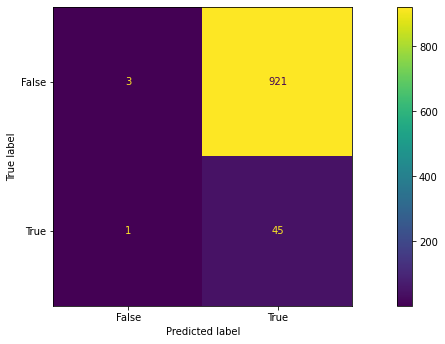

Epoch 1/200
24/24 [==============================] - 4s 145ms/step - loss: 0.1706 - val_loss: 0.0223
Epoch 2/200
24/24 [==============================] - 3s 136ms/step - loss: 0.0084 - val_loss: 0.0021
Epoch 3/200
24/24 [==============================] - 3s 136ms/step - loss: 9.4398e-04 - val_loss: 2.6140e-04
Epoch 4/200
24/24 [==============================] - 3s 136ms/step - loss: 1.8478e-04 - val_loss: 1.1349e-04
Epoch 5/200
24/24 [==============================] - 3s 137ms/step - loss: 9.6707e-05 - val_loss: 7.5606e-05
Epoch 6/200
24/24 [==============================] - 3s 138ms/step - loss: 7.0127e-05 - val_loss: 6.5752e-05
Epoch 7/200
24/24 [==============================] - 3s 135ms/step - loss: 5.9016e-05 - val_loss: 4.9503e-05
Epoch 8/200
24/24 [==============================] - 3s 139ms/step - loss: 4.8562e-05 - val_loss: 4.1592e-05
Epoch 9/200
24/24 [==============================] - 3s 138ms/step - loss: 4.4055e-05 - val_loss: 4.5369e-05
Epoch 10/200
24/24 [===============

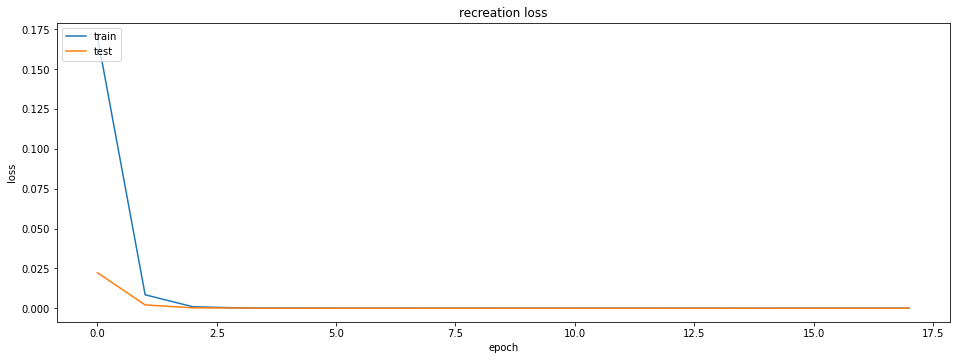

Intlier max value: 0.0001072251 Index Val: 56
outlier max value: 0.00011529517 Index Val: 9
outlier min value: 1.3477891e-05 Index Val: 30


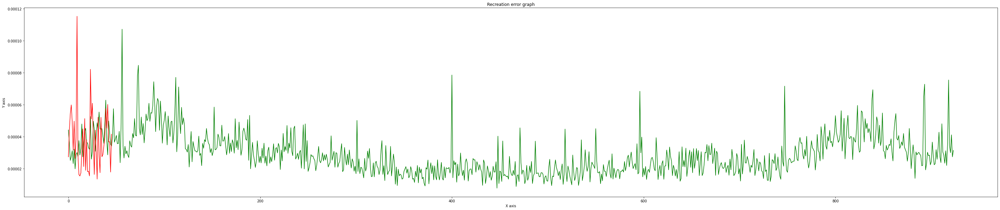

Total member in inlear: 924
Total False alarm: 868
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.98      0.06      0.11       924
           1       0.05      0.98      0.09        46

    accuracy                           0.10       970
   macro avg       0.52      0.52      0.10       970
weighted avg       0.94      0.10      0.11       970



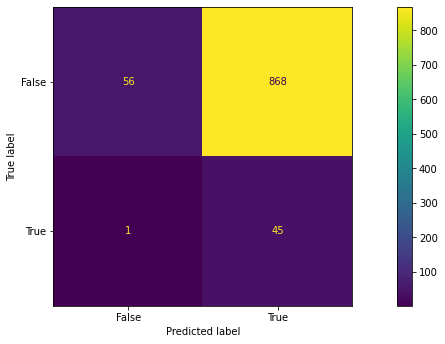

Epoch 1/200
24/24 [==============================] - 5s 156ms/step - loss: 0.1938 - val_loss: 0.0296
Epoch 2/200
24/24 [==============================] - 3s 138ms/step - loss: 0.0126 - val_loss: 0.0022
Epoch 3/200
24/24 [==============================] - 3s 136ms/step - loss: 0.0010 - val_loss: 3.6236e-04
Epoch 4/200
24/24 [==============================] - 3s 136ms/step - loss: 2.1953e-04 - val_loss: 1.3757e-04
Epoch 5/200
24/24 [==============================] - 3s 137ms/step - loss: 1.0272e-04 - val_loss: 8.4852e-05
Epoch 6/200
24/24 [==============================] - 3s 135ms/step - loss: 7.3833e-05 - val_loss: 5.7876e-05
Epoch 7/200
24/24 [==============================] - 3s 137ms/step - loss: 5.1445e-05 - val_loss: 6.3981e-05
Epoch 8/200
24/24 [==============================] - 3s 139ms/step - loss: 4.5562e-05 - val_loss: 4.0780e-05
Epoch 9/200
24/24 [==============================] - 3s 145ms/step - loss: 3.5996e-05 - val_loss: 4.3802e-05
Epoch 10/200
24/24 [===================

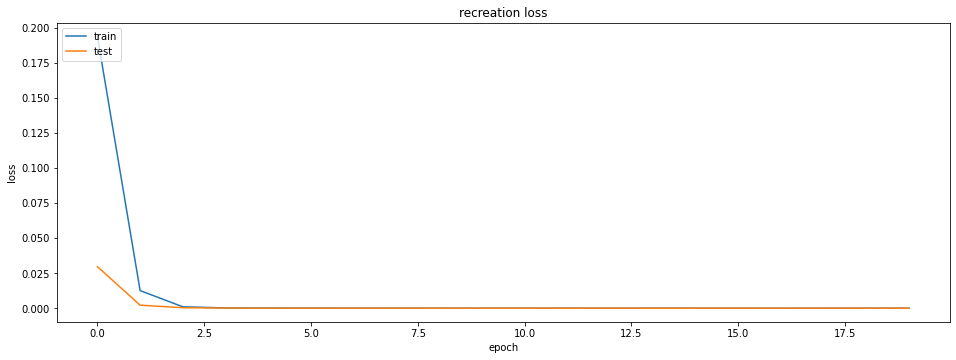

Intlier max value: 7.3649935e-05 Index Val: 747
outlier max value: 7.800376e-05 Index Val: 9
outlier min value: 6.885878e-06 Index Val: 7


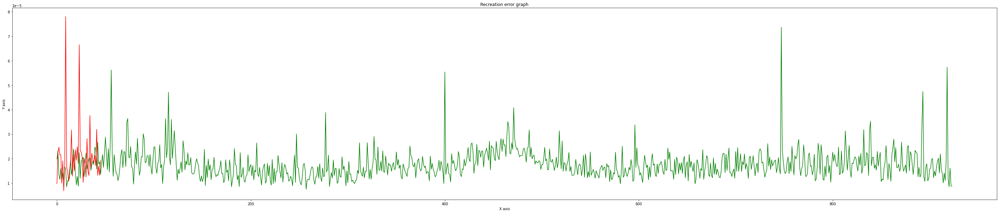

Total member in inlear: 924
Total False alarm: 924
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       924
           1       0.05      0.98      0.09        46

    accuracy                           0.05       970
   macro avg       0.02      0.49      0.04       970
weighted avg       0.00      0.05      0.00       970



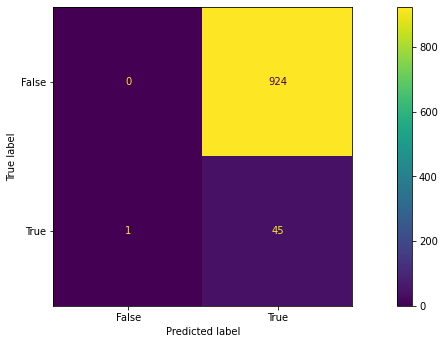

Epoch 1/200
24/24 [==============================] - 4s 147ms/step - loss: 0.1807 - val_loss: 0.0286
Epoch 2/200
24/24 [==============================] - 3s 136ms/step - loss: 0.0115 - val_loss: 0.0029
Epoch 3/200
24/24 [==============================] - 3s 137ms/step - loss: 0.0014 - val_loss: 4.4050e-04
Epoch 4/200
24/24 [==============================] - 3s 137ms/step - loss: 2.8858e-04 - val_loss: 1.7758e-04
Epoch 5/200
24/24 [==============================] - 3s 137ms/step - loss: 1.4480e-04 - val_loss: 1.3022e-04
Epoch 6/200
24/24 [==============================] - 3s 135ms/step - loss: 1.0251e-04 - val_loss: 8.3749e-05
Epoch 7/200
24/24 [==============================] - 3s 134ms/step - loss: 7.4881e-05 - val_loss: 6.6438e-05
Epoch 8/200
24/24 [==============================] - 3s 142ms/step - loss: 6.0183e-05 - val_loss: 5.9834e-05
Epoch 9/200
24/24 [==============================] - 4s 158ms/step - loss: 4.9093e-05 - val_loss: 5.1933e-05
Epoch 10/200
24/24 [===================

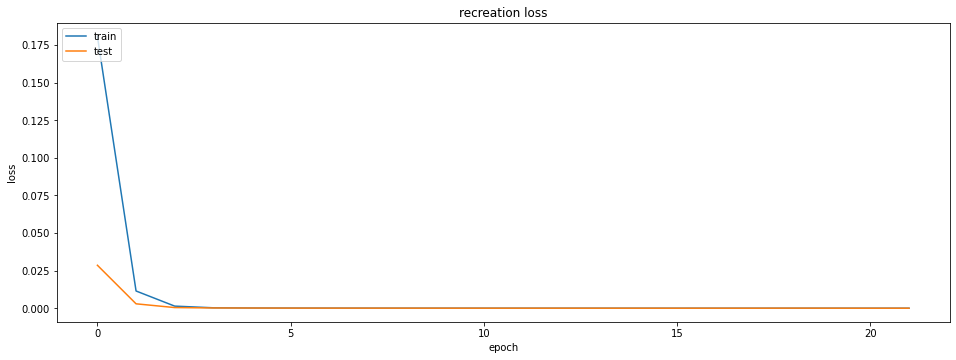

Intlier max value: 5.346061e-05 Index Val: 56
outlier max value: 5.0919094e-05 Index Val: 9
outlier min value: 9.1586835e-06 Index Val: 27


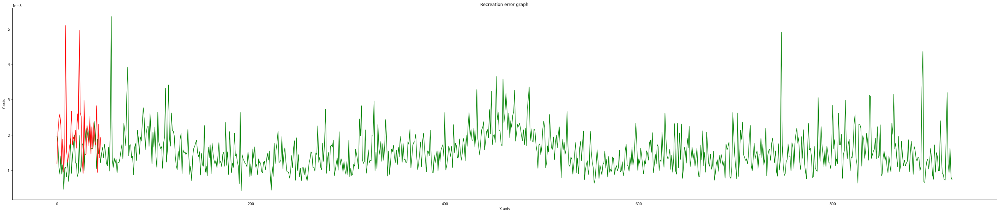

Total member in inlear: 924
Total False alarm: 838
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.99      0.09      0.17       924
           1       0.05      0.98      0.10        46

    accuracy                           0.14       970
   macro avg       0.52      0.54      0.13       970
weighted avg       0.94      0.14      0.17       970



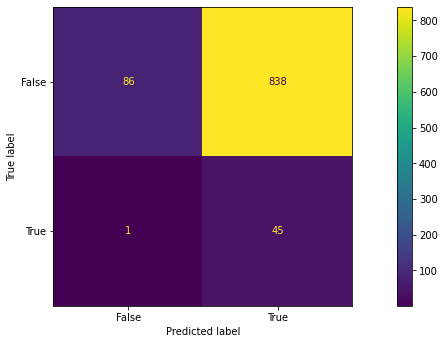

Epoch 1/200
24/24 [==============================] - 4s 146ms/step - loss: 0.1315 - val_loss: 0.0209
Epoch 2/200
24/24 [==============================] - 3s 137ms/step - loss: 0.0075 - val_loss: 0.0015
Epoch 3/200
24/24 [==============================] - 3s 135ms/step - loss: 6.7431e-04 - val_loss: 2.3788e-04
Epoch 4/200
24/24 [==============================] - 3s 136ms/step - loss: 1.5979e-04 - val_loss: 1.2647e-04
Epoch 5/200
24/24 [==============================] - 4s 155ms/step - loss: 9.0821e-05 - val_loss: 7.1823e-05
Epoch 6/200
24/24 [==============================] - 3s 133ms/step - loss: 6.7726e-05 - val_loss: 6.2124e-05
Epoch 7/200
24/24 [==============================] - 3s 136ms/step - loss: 5.8111e-05 - val_loss: 5.3382e-05
Epoch 8/200
24/24 [==============================] - 3s 136ms/step - loss: 4.8832e-05 - val_loss: 4.3714e-05
Epoch 9/200
24/24 [==============================] - 3s 137ms/step - loss: 4.3589e-05 - val_loss: 4.8787e-05
Epoch 10/200
24/24 [===============

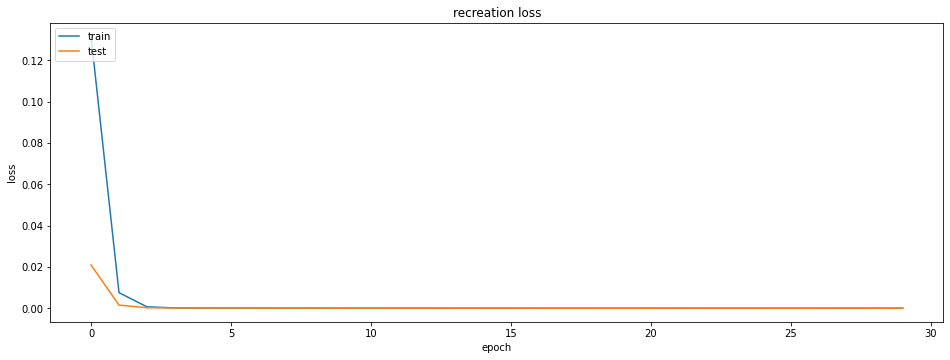

Intlier max value: 6.6971035e-05 Index Val: 472
outlier max value: 5.56571e-05 Index Val: 21
outlier min value: 9.763322e-06 Index Val: 1


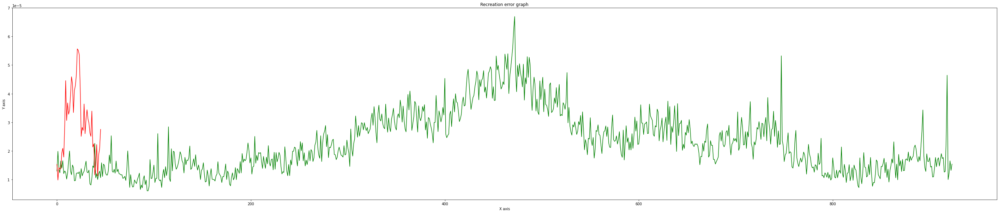

Total member in inlear: 924
Total False alarm: 880
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.98      0.05      0.09       924
           1       0.05      0.98      0.09        46

    accuracy                           0.09       970
   macro avg       0.51      0.51      0.09       970
weighted avg       0.93      0.09      0.09       970



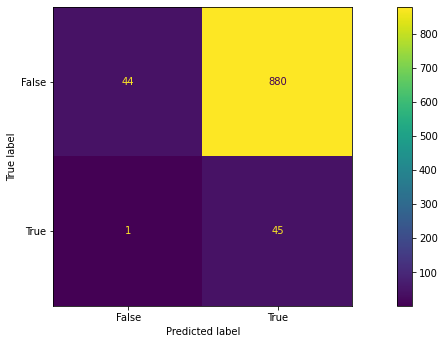

Epoch 1/200
24/24 [==============================] - 4s 143ms/step - loss: 0.1622 - val_loss: 0.0272
Epoch 2/200
24/24 [==============================] - 3s 139ms/step - loss: 0.0120 - val_loss: 0.0034
Epoch 3/200
24/24 [==============================] - 3s 135ms/step - loss: 0.0019 - val_loss: 6.2346e-04
Epoch 4/200
24/24 [==============================] - 3s 134ms/step - loss: 3.4118e-04 - val_loss: 2.2861e-04
Epoch 5/200
24/24 [==============================] - 3s 137ms/step - loss: 1.4473e-04 - val_loss: 1.1248e-04
Epoch 6/200
24/24 [==============================] - 3s 133ms/step - loss: 8.9410e-05 - val_loss: 7.5856e-05
Epoch 7/200
24/24 [==============================] - 3s 135ms/step - loss: 7.5207e-05 - val_loss: 6.1292e-05
Epoch 8/200
24/24 [==============================] - 3s 134ms/step - loss: 6.1613e-05 - val_loss: 5.5790e-05
Epoch 9/200
24/24 [==============================] - 4s 151ms/step - loss: 5.1347e-05 - val_loss: 7.0684e-05
Epoch 10/200
24/24 [===================

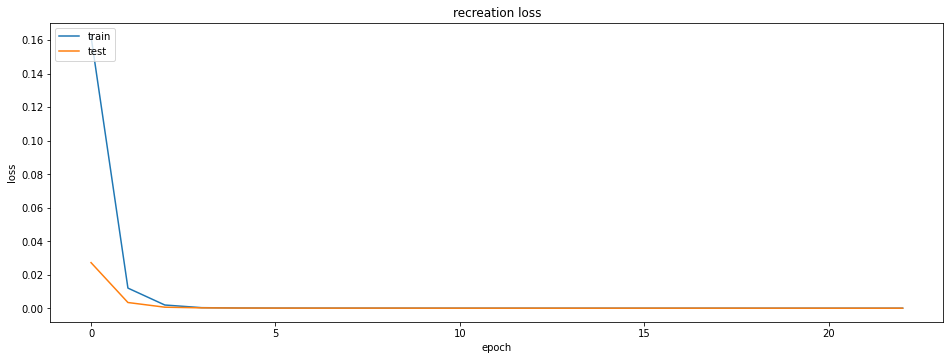

Intlier max value: 8.386281e-05 Index Val: 56
outlier max value: 9.871592e-05 Index Val: 9
outlier min value: 2.5561792e-05 Index Val: 12


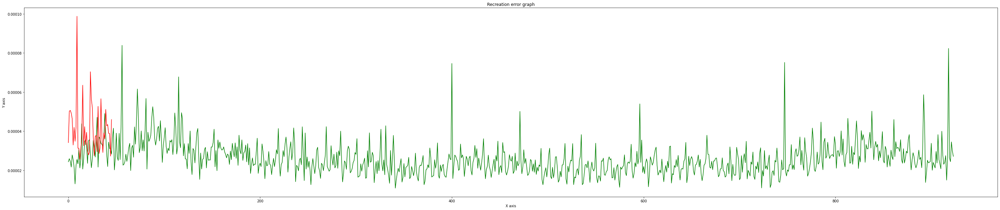

Total member in inlear: 924
Total False alarm: 394
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       1.00      0.57      0.73       924
           1       0.10      0.98      0.19        46

    accuracy                           0.59       970
   macro avg       0.55      0.78      0.46       970
weighted avg       0.96      0.59      0.70       970



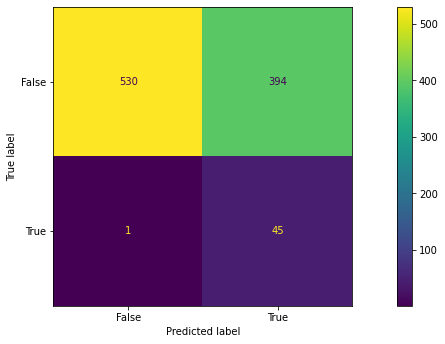

Epoch 1/200
24/24 [==============================] - 4s 143ms/step - loss: 0.2089 - val_loss: 0.0393
Epoch 2/200
24/24 [==============================] - 3s 132ms/step - loss: 0.0161 - val_loss: 0.0043
Epoch 3/200
24/24 [==============================] - 3s 135ms/step - loss: 0.0019 - val_loss: 6.5884e-04
Epoch 4/200
24/24 [==============================] - 3s 136ms/step - loss: 3.6669e-04 - val_loss: 2.4474e-04
Epoch 5/200
24/24 [==============================] - 3s 131ms/step - loss: 1.6910e-04 - val_loss: 1.3896e-04
Epoch 6/200
24/24 [==============================] - 4s 150ms/step - loss: 1.0597e-04 - val_loss: 9.5432e-05
Epoch 7/200
24/24 [==============================] - 3s 143ms/step - loss: 7.4850e-05 - val_loss: 7.1666e-05
Epoch 8/200
24/24 [==============================] - 3s 134ms/step - loss: 5.9881e-05 - val_loss: 5.4625e-05
Epoch 9/200
24/24 [==============================] - 3s 136ms/step - loss: 4.6513e-05 - val_loss: 4.8208e-05
Epoch 10/200
24/24 [===================

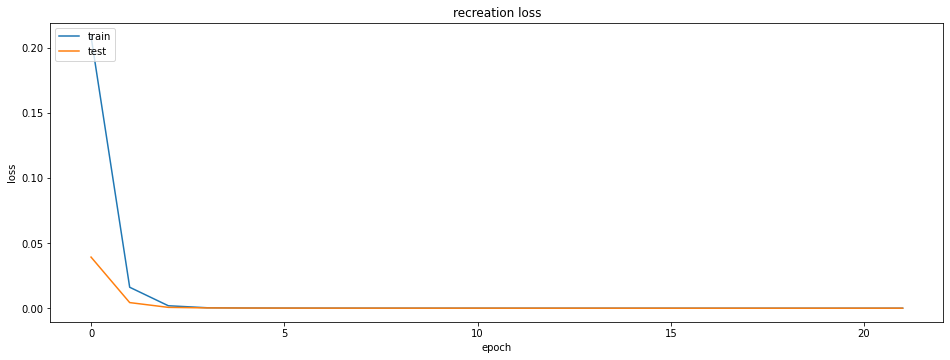

Intlier max value: 0.00013327785 Index Val: 893
outlier max value: 0.00015943703 Index Val: 9
outlier min value: 3.4522104e-06 Index Val: 21


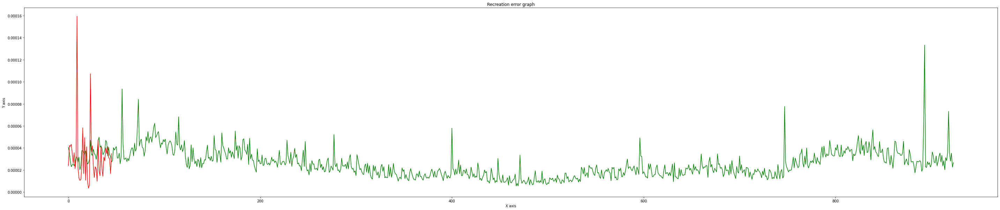

Total member in inlear: 924
Total False alarm: 924
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       924
           1       0.05      0.98      0.09        46

    accuracy                           0.05       970
   macro avg       0.02      0.49      0.04       970
weighted avg       0.00      0.05      0.00       970



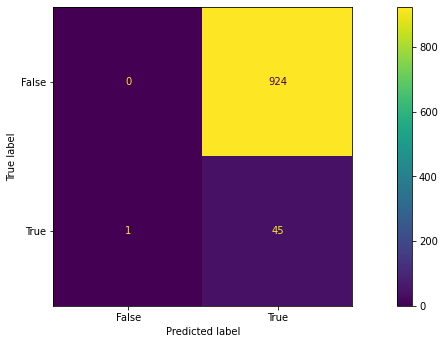

Epoch 1/200
24/24 [==============================] - 4s 144ms/step - loss: 0.1587 - val_loss: 0.0255
Epoch 2/200
24/24 [==============================] - 4s 153ms/step - loss: 0.0091 - val_loss: 0.0021
Epoch 3/200
24/24 [==============================] - 3s 137ms/step - loss: 9.0205e-04 - val_loss: 3.1224e-04
Epoch 4/200
24/24 [==============================] - 3s 136ms/step - loss: 2.0866e-04 - val_loss: 1.3253e-04
Epoch 5/200
24/24 [==============================] - 3s 136ms/step - loss: 1.1181e-04 - val_loss: 9.6807e-05
Epoch 6/200
24/24 [==============================] - 3s 134ms/step - loss: 8.4630e-05 - val_loss: 7.8925e-05
Epoch 7/200
24/24 [==============================] - 3s 135ms/step - loss: 6.7365e-05 - val_loss: 6.5838e-05
Epoch 8/200
24/24 [==============================] - 3s 134ms/step - loss: 5.5400e-05 - val_loss: 5.2142e-05
Epoch 9/200
24/24 [==============================] - 3s 136ms/step - loss: 4.5296e-05 - val_loss: 4.1818e-05
Epoch 10/200
24/24 [===============

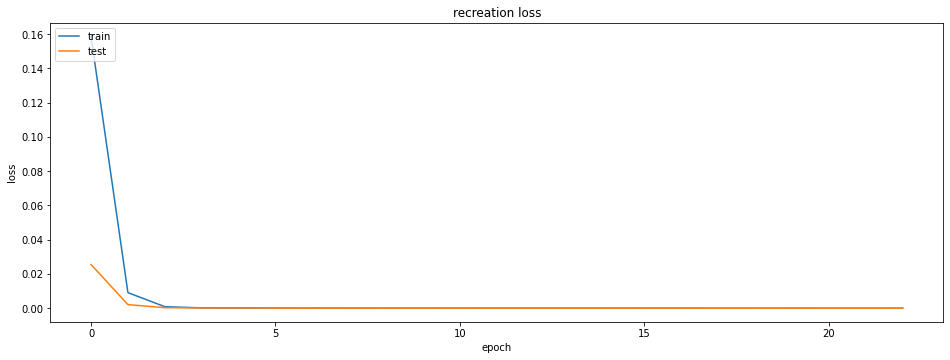

Intlier max value: 0.00010587339 Index Val: 747
outlier max value: 7.036243e-05 Index Val: 9
outlier min value: 1.9753586e-05 Index Val: 12


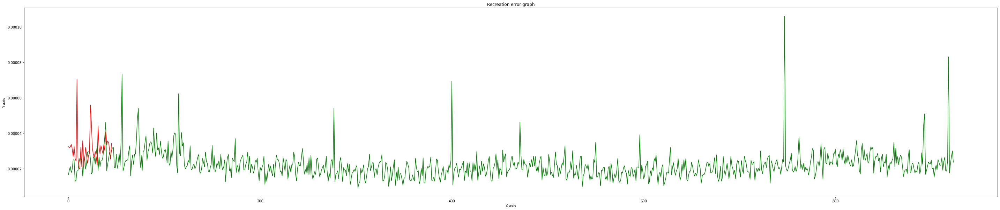

Total member in inlear: 924
Total False alarm: 533
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       1.00      0.42      0.59       924
           1       0.08      0.98      0.14        46

    accuracy                           0.45       970
   macro avg       0.54      0.70      0.37       970
weighted avg       0.95      0.45      0.57       970



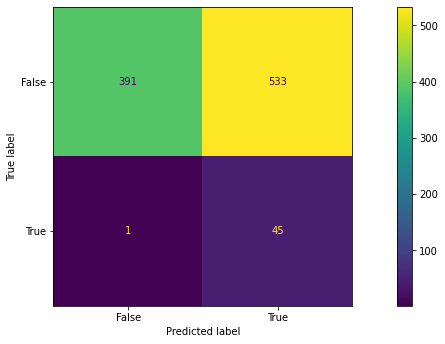

Epoch 1/200
24/24 [==============================] - 4s 144ms/step - loss: 0.1616 - val_loss: 0.0217
Epoch 2/200
24/24 [==============================] - 3s 136ms/step - loss: 0.0090 - val_loss: 0.0018
Epoch 3/200
24/24 [==============================] - 3s 138ms/step - loss: 0.0010 - val_loss: 3.4996e-04
Epoch 4/200
24/24 [==============================] - 3s 145ms/step - loss: 2.3382e-04 - val_loss: 1.3014e-04
Epoch 5/200
24/24 [==============================] - 3s 139ms/step - loss: 1.0401e-04 - val_loss: 8.1072e-05
Epoch 6/200
24/24 [==============================] - 3s 132ms/step - loss: 7.1489e-05 - val_loss: 6.3337e-05
Epoch 7/200
24/24 [==============================] - 3s 136ms/step - loss: 5.4228e-05 - val_loss: 5.7905e-05
Epoch 8/200
24/24 [==============================] - 3s 137ms/step - loss: 4.1889e-05 - val_loss: 3.7769e-05
Epoch 9/200
24/24 [==============================] - 3s 136ms/step - loss: 3.4485e-05 - val_loss: 3.4764e-05
Epoch 10/200
24/24 [===================

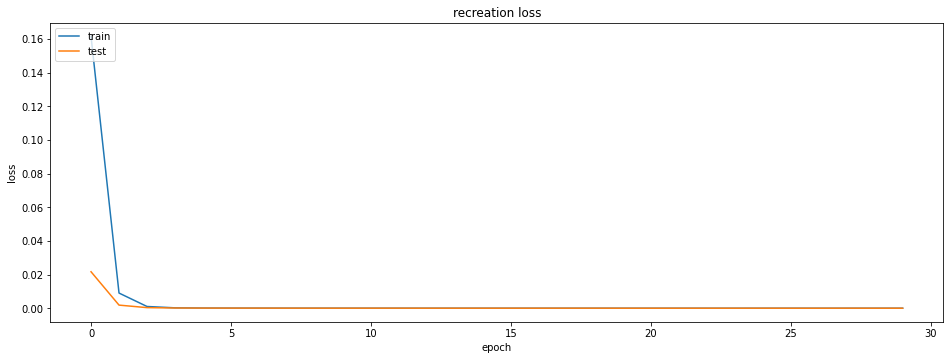

Intlier max value: 5.1716586e-05 Index Val: 747
outlier max value: 5.0670445e-05 Index Val: 23
outlier min value: 4.927298e-06 Index Val: 3


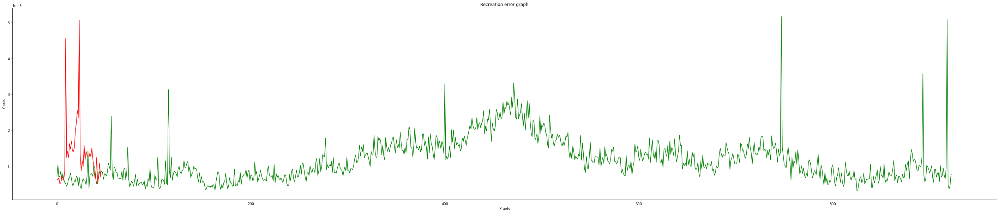

Total member in inlear: 924
Total False alarm: 861
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.98      0.07      0.13       924
           1       0.05      0.98      0.09        46

    accuracy                           0.11       970
   macro avg       0.52      0.52      0.11       970
weighted avg       0.94      0.11      0.13       970



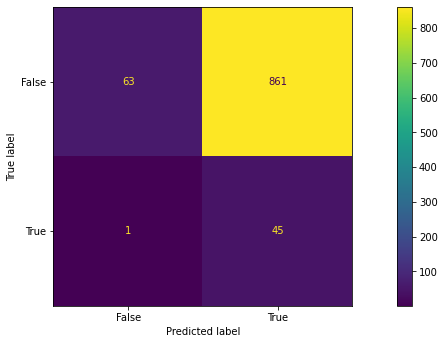

Epoch 1/200
24/24 [==============================] - 4s 144ms/step - loss: 0.1756 - val_loss: 0.0357
Epoch 2/200
24/24 [==============================] - 3s 135ms/step - loss: 0.0144 - val_loss: 0.0029
Epoch 3/200
24/24 [==============================] - 3s 134ms/step - loss: 0.0013 - val_loss: 3.9204e-04
Epoch 4/200
24/24 [==============================] - 3s 133ms/step - loss: 2.4076e-04 - val_loss: 1.7408e-04
Epoch 5/200
24/24 [==============================] - 3s 135ms/step - loss: 1.2187e-04 - val_loss: 9.2983e-05
Epoch 6/200
24/24 [==============================] - 3s 134ms/step - loss: 8.5592e-05 - val_loss: 7.9296e-05
Epoch 7/200
24/24 [==============================] - 3s 131ms/step - loss: 6.6095e-05 - val_loss: 5.6988e-05
Epoch 8/200
24/24 [==============================] - 3s 135ms/step - loss: 5.2731e-05 - val_loss: 4.7785e-05
Epoch 9/200
24/24 [==============================] - 3s 134ms/step - loss: 4.2626e-05 - val_loss: 4.5025e-05
Epoch 10/200
24/24 [===================

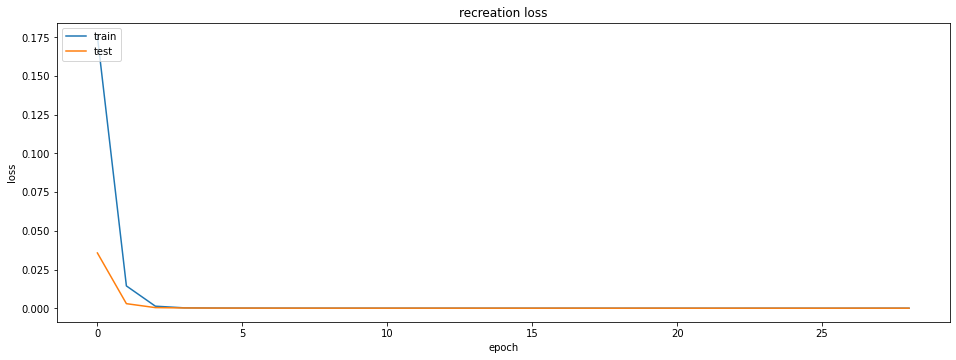

Intlier max value: 5.49958e-05 Index Val: 56
outlier max value: 5.7692825e-05 Index Val: 9
outlier min value: 2.3499022e-05 Index Val: 7


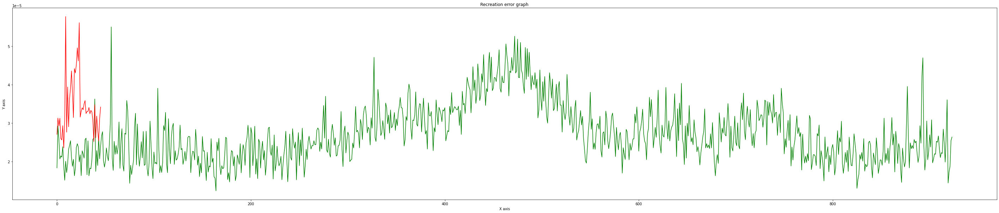

Total member in inlear: 924
Total False alarm: 586
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       1.00      0.37      0.54       924
           1       0.07      0.98      0.13        46

    accuracy                           0.39       970
   macro avg       0.53      0.67      0.33       970
weighted avg       0.95      0.39      0.52       970



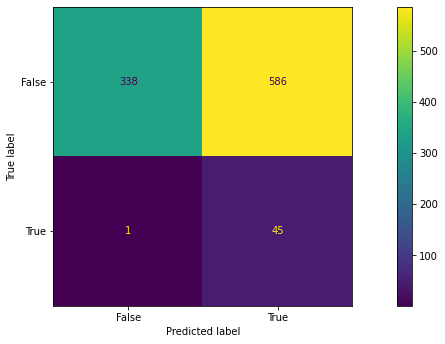

Epoch 1/200
24/24 [==============================] - 4s 147ms/step - loss: 0.1714 - val_loss: 0.0622
Epoch 2/200
24/24 [==============================] - 3s 133ms/step - loss: 0.0281 - val_loss: 0.0047
Epoch 3/200
24/24 [==============================] - 3s 134ms/step - loss: 0.0022 - val_loss: 5.2575e-04
Epoch 4/200
24/24 [==============================] - 3s 138ms/step - loss: 2.9984e-04 - val_loss: 1.8158e-04
Epoch 5/200
24/24 [==============================] - 3s 136ms/step - loss: 1.2844e-04 - val_loss: 1.0008e-04
Epoch 6/200
24/24 [==============================] - 3s 133ms/step - loss: 8.4471e-05 - val_loss: 8.5635e-05
Epoch 7/200
24/24 [==============================] - 3s 134ms/step - loss: 6.3172e-05 - val_loss: 8.3536e-05
Epoch 8/200
24/24 [==============================] - 3s 138ms/step - loss: 5.2869e-05 - val_loss: 4.5122e-05
Epoch 9/200
24/24 [==============================] - 3s 135ms/step - loss: 4.2962e-05 - val_loss: 5.0979e-05
Epoch 10/200
24/24 [===================

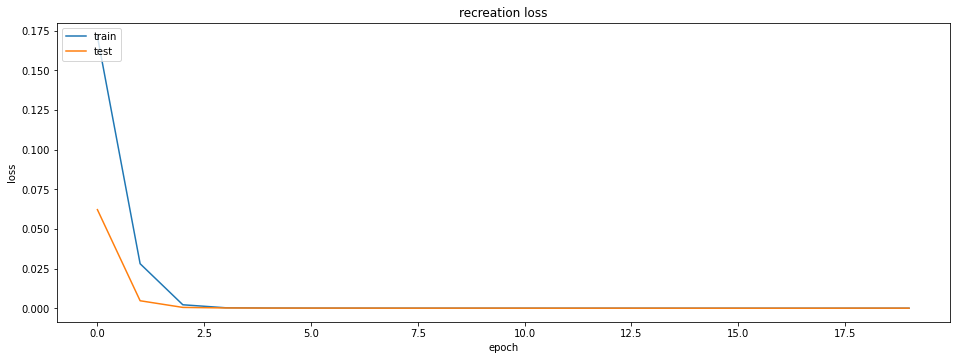

Intlier max value: 0.00010654408 Index Val: 56
outlier max value: 0.000103845705 Index Val: 9
outlier min value: 1.4915226e-05 Index Val: 22


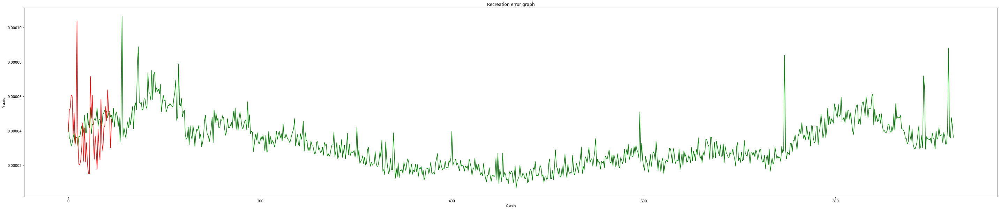

Total member in inlear: 924
Total False alarm: 853
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.99      0.08      0.14       924
           1       0.05      0.98      0.10        46

    accuracy                           0.12       970
   macro avg       0.52      0.53      0.12       970
weighted avg       0.94      0.12      0.14       970



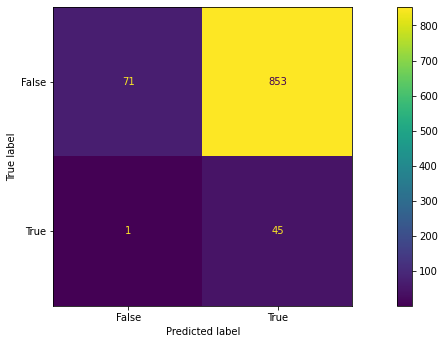

Epoch 1/200
24/24 [==============================] - 4s 147ms/step - loss: 0.1485 - val_loss: 0.0309
Epoch 2/200
24/24 [==============================] - 3s 134ms/step - loss: 0.0120 - val_loss: 0.0019
Epoch 3/200
24/24 [==============================] - 3s 135ms/step - loss: 9.3620e-04 - val_loss: 3.5720e-04
Epoch 4/200
24/24 [==============================] - 3s 137ms/step - loss: 2.1573e-04 - val_loss: 1.4451e-04
Epoch 5/200
24/24 [==============================] - 3s 133ms/step - loss: 1.1941e-04 - val_loss: 1.0333e-04
Epoch 6/200
24/24 [==============================] - 3s 140ms/step - loss: 8.4874e-05 - val_loss: 9.1636e-05
Epoch 7/200
24/24 [==============================] - 3s 137ms/step - loss: 7.2591e-05 - val_loss: 6.0278e-05
Epoch 8/200
24/24 [==============================] - 3s 139ms/step - loss: 5.6431e-05 - val_loss: 5.1559e-05
Epoch 9/200
24/24 [==============================] - 3s 134ms/step - loss: 4.8336e-05 - val_loss: 5.8127e-05
Epoch 10/200
24/24 [===============

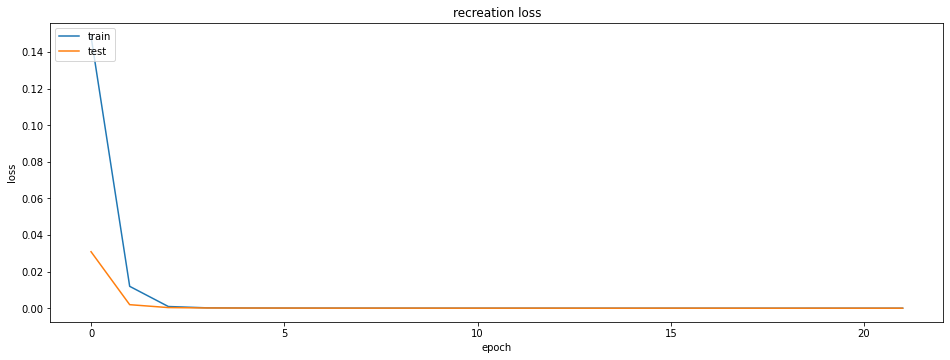

Intlier max value: 5.259448e-05 Index Val: 918
outlier max value: 5.4222422e-05 Index Val: 9
outlier min value: 1.458998e-05 Index Val: 0


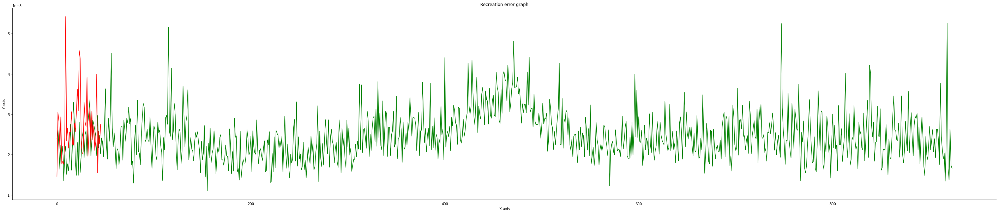

Total member in inlear: 924
Total False alarm: 907
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.94      0.02      0.04       924
           1       0.05      0.98      0.09        46

    accuracy                           0.06       970
   macro avg       0.50      0.50      0.06       970
weighted avg       0.90      0.06      0.04       970



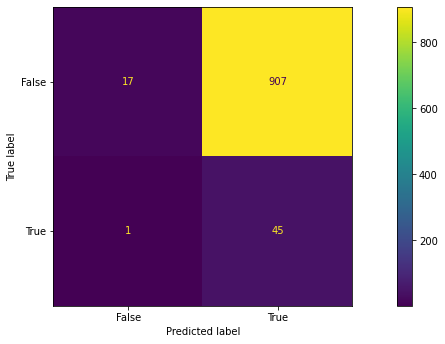

Epoch 1/200
24/24 [==============================] - 4s 145ms/step - loss: 0.1648 - val_loss: 0.0162
Epoch 2/200
24/24 [==============================] - 3s 138ms/step - loss: 0.0066 - val_loss: 0.0017
Epoch 3/200
24/24 [==============================] - 3s 135ms/step - loss: 8.2840e-04 - val_loss: 4.8578e-04
Epoch 4/200
24/24 [==============================] - 3s 132ms/step - loss: 2.6647e-04 - val_loss: 2.1451e-04
Epoch 5/200
24/24 [==============================] - 4s 148ms/step - loss: 1.4535e-04 - val_loss: 1.1945e-04
Epoch 6/200
24/24 [==============================] - 4s 153ms/step - loss: 1.0277e-04 - val_loss: 9.9594e-05
Epoch 7/200
24/24 [==============================] - 3s 140ms/step - loss: 8.7144e-05 - val_loss: 7.8163e-05
Epoch 8/200
24/24 [==============================] - 3s 139ms/step - loss: 7.2821e-05 - val_loss: 6.9131e-05
Epoch 9/200
24/24 [==============================] - 3s 137ms/step - loss: 6.5323e-05 - val_loss: 6.1676e-05
Epoch 10/200
24/24 [===============

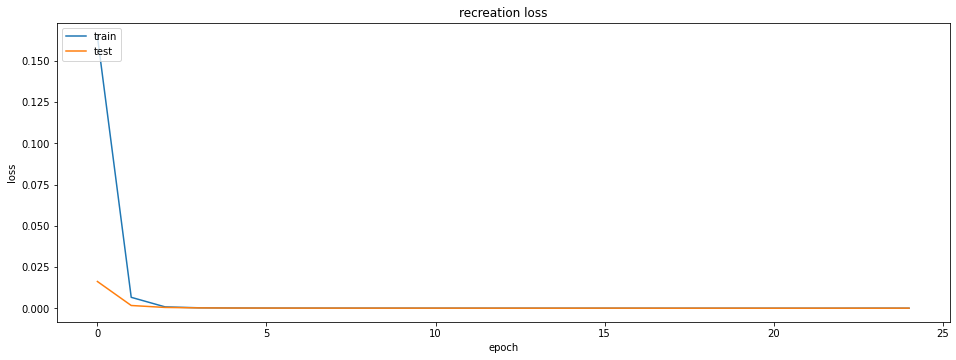

Intlier max value: 0.00013261156 Index Val: 918
outlier max value: 0.00013811537 Index Val: 9
outlier min value: 4.7378137e-05 Index Val: 5


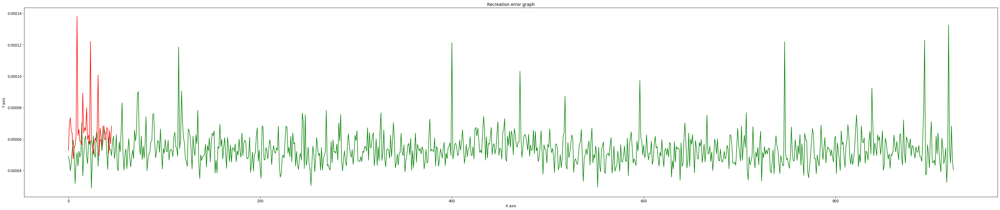

Total member in inlear: 924
Total False alarm: 657
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       1.00      0.29      0.45       924
           1       0.06      0.98      0.12        46

    accuracy                           0.32       970
   macro avg       0.53      0.63      0.28       970
weighted avg       0.95      0.32      0.43       970



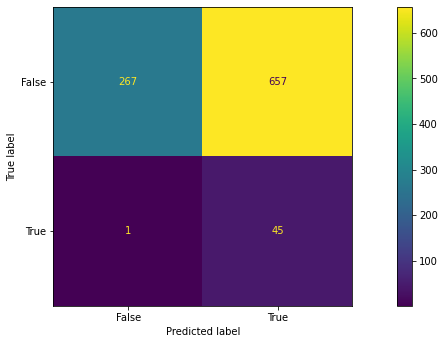

Epoch 1/200
24/24 [==============================] - 4s 143ms/step - loss: 0.1488 - val_loss: 0.0326
Epoch 2/200
24/24 [==============================] - 3s 135ms/step - loss: 0.0143 - val_loss: 0.0023
Epoch 3/200
24/24 [==============================] - 3s 134ms/step - loss: 0.0012 - val_loss: 3.3963e-04
Epoch 4/200
24/24 [==============================] - 3s 132ms/step - loss: 2.2331e-04 - val_loss: 1.3203e-04
Epoch 5/200
24/24 [==============================] - 3s 135ms/step - loss: 1.0499e-04 - val_loss: 8.3907e-05
Epoch 6/200
24/24 [==============================] - 3s 134ms/step - loss: 7.2634e-05 - val_loss: 6.6852e-05
Epoch 7/200
24/24 [==============================] - 3s 133ms/step - loss: 5.7531e-05 - val_loss: 4.8229e-05
Epoch 8/200
24/24 [==============================] - 3s 135ms/step - loss: 4.7030e-05 - val_loss: 4.2901e-05
Epoch 9/200
24/24 [==============================] - 3s 136ms/step - loss: 3.8605e-05 - val_loss: 3.7315e-05
Epoch 10/200
24/24 [===================

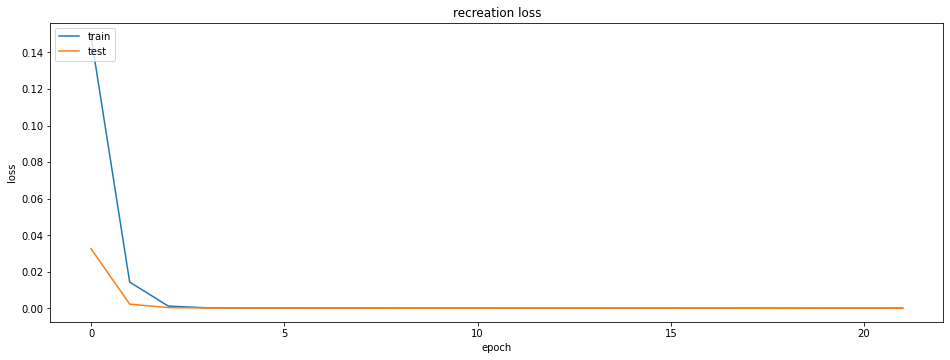

Intlier max value: 5.9239122e-05 Index Val: 747
outlier max value: 6.9375106e-05 Index Val: 9
outlier min value: 4.3007235e-06 Index Val: 0


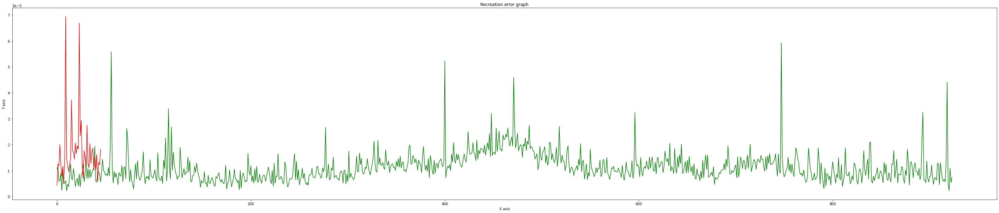

Total member in inlear: 924
Total False alarm: 903
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.95      0.02      0.04       924
           1       0.05      0.98      0.09        46

    accuracy                           0.07       970
   macro avg       0.50      0.50      0.07       970
weighted avg       0.91      0.07      0.05       970



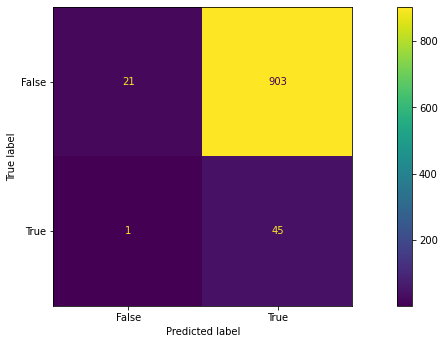

Epoch 1/200
24/24 [==============================] - 4s 143ms/step - loss: 0.1955 - val_loss: 0.0314
Epoch 2/200
24/24 [==============================] - 3s 133ms/step - loss: 0.0130 - val_loss: 0.0033
Epoch 3/200
24/24 [==============================] - 3s 134ms/step - loss: 0.0018 - val_loss: 4.6871e-04
Epoch 4/200
24/24 [==============================] - 3s 134ms/step - loss: 2.5374e-04 - val_loss: 1.3059e-04
Epoch 5/200
24/24 [==============================] - 3s 135ms/step - loss: 1.0283e-04 - val_loss: 8.0562e-05
Epoch 6/200
24/24 [==============================] - 3s 135ms/step - loss: 7.1119e-05 - val_loss: 6.1534e-05
Epoch 7/200
24/24 [==============================] - 3s 134ms/step - loss: 5.3402e-05 - val_loss: 4.9098e-05
Epoch 8/200
24/24 [==============================] - 3s 134ms/step - loss: 4.3780e-05 - val_loss: 4.1581e-05
Epoch 9/200
24/24 [==============================] - 3s 134ms/step - loss: 3.7614e-05 - val_loss: 3.6719e-05
Epoch 10/200
24/24 [===================

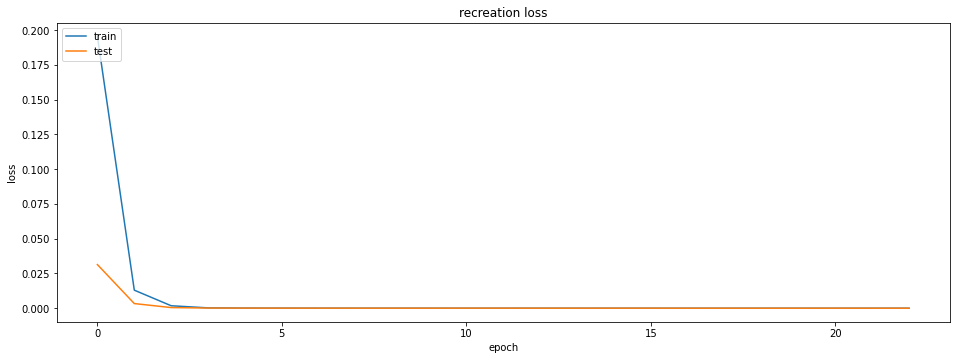

Intlier max value: 5.2532763e-05 Index Val: 918
outlier max value: 5.6550245e-05 Index Val: 24
outlier min value: 4.8399443e-06 Index Val: 27


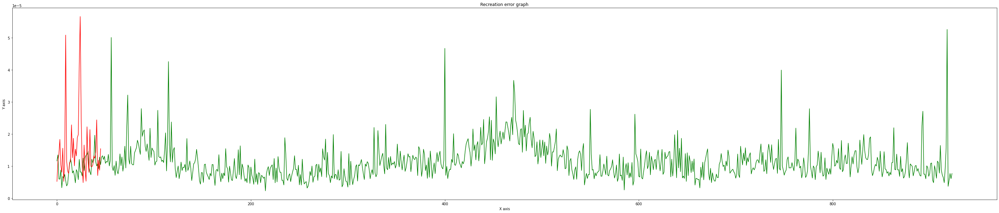

Total member in inlear: 924
Total False alarm: 889
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.97      0.04      0.07       924
           1       0.05      0.98      0.09        46

    accuracy                           0.08       970
   macro avg       0.51      0.51      0.08       970
weighted avg       0.93      0.08      0.07       970



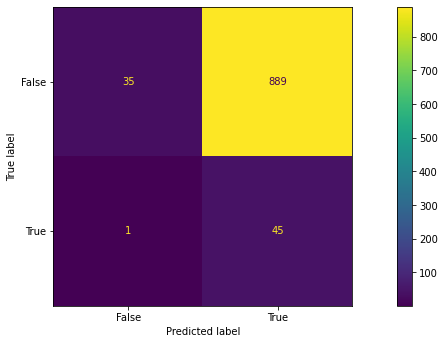

Epoch 1/200
24/24 [==============================] - 4s 143ms/step - loss: 0.1954 - val_loss: 0.0444
Epoch 2/200
24/24 [==============================] - 4s 161ms/step - loss: 0.0200 - val_loss: 0.0049
Epoch 3/200
24/24 [==============================] - 3s 136ms/step - loss: 0.0019 - val_loss: 5.0851e-04
Epoch 4/200
24/24 [==============================] - 3s 134ms/step - loss: 2.8466e-04 - val_loss: 1.5506e-04
Epoch 5/200
24/24 [==============================] - 3s 135ms/step - loss: 1.3033e-04 - val_loss: 1.1015e-04
Epoch 6/200
24/24 [==============================] - 3s 135ms/step - loss: 8.8880e-05 - val_loss: 8.6727e-05
Epoch 7/200
24/24 [==============================] - 3s 134ms/step - loss: 6.6140e-05 - val_loss: 6.5342e-05
Epoch 8/200
24/24 [==============================] - 3s 134ms/step - loss: 5.4418e-05 - val_loss: 6.6167e-05
Epoch 9/200
24/24 [==============================] - 3s 135ms/step - loss: 4.5259e-05 - val_loss: 4.4239e-05
Epoch 10/200
24/24 [===================

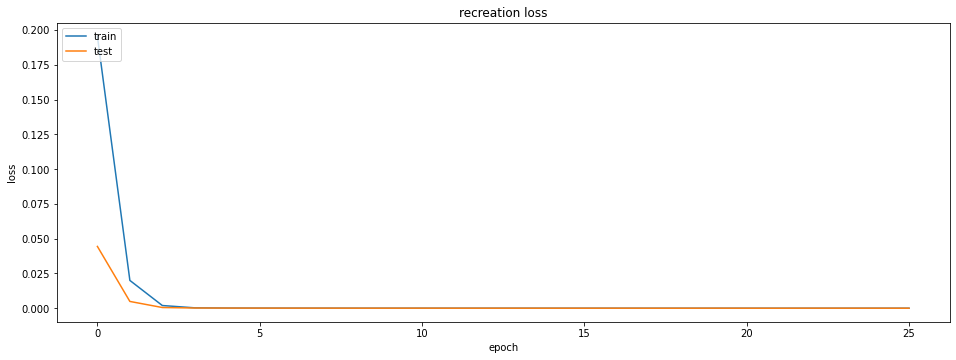

Intlier max value: 6.006672e-05 Index Val: 747
outlier max value: 7.201638e-05 Index Val: 9
outlier min value: 1.0143038e-05 Index Val: 5


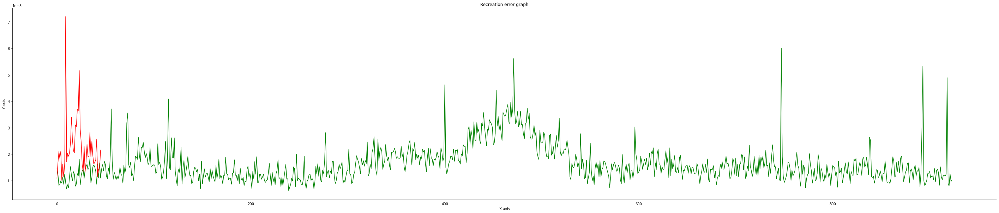

Total member in inlear: 924
Total False alarm: 817
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.99      0.12      0.21       924
           1       0.05      0.98      0.10        46

    accuracy                           0.16       970
   macro avg       0.52      0.55      0.15       970
weighted avg       0.95      0.16      0.20       970



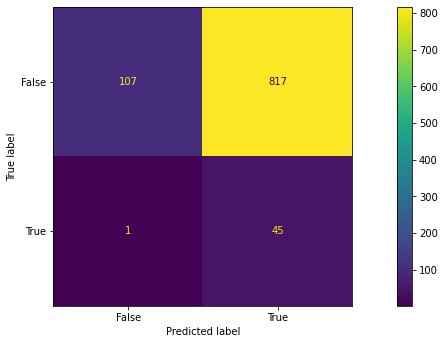

Epoch 1/200
24/24 [==============================] - 4s 148ms/step - loss: 0.1971 - val_loss: 0.0514
Epoch 2/200
24/24 [==============================] - 3s 136ms/step - loss: 0.0206 - val_loss: 0.0035
Epoch 3/200
24/24 [==============================] - 3s 138ms/step - loss: 0.0015 - val_loss: 4.2896e-04
Epoch 4/200
24/24 [==============================] - 3s 138ms/step - loss: 2.4088e-04 - val_loss: 1.4078e-04
Epoch 5/200
24/24 [==============================] - 3s 137ms/step - loss: 1.0311e-04 - val_loss: 7.7763e-05
Epoch 6/200
24/24 [==============================] - 3s 135ms/step - loss: 6.7535e-05 - val_loss: 5.4521e-05
Epoch 7/200
24/24 [==============================] - 3s 137ms/step - loss: 4.7259e-05 - val_loss: 4.3820e-05
Epoch 8/200
24/24 [==============================] - 3s 137ms/step - loss: 3.9987e-05 - val_loss: 3.2153e-05
Epoch 9/200
24/24 [==============================] - 3s 136ms/step - loss: 2.9923e-05 - val_loss: 3.1833e-05
Epoch 10/200
24/24 [===================

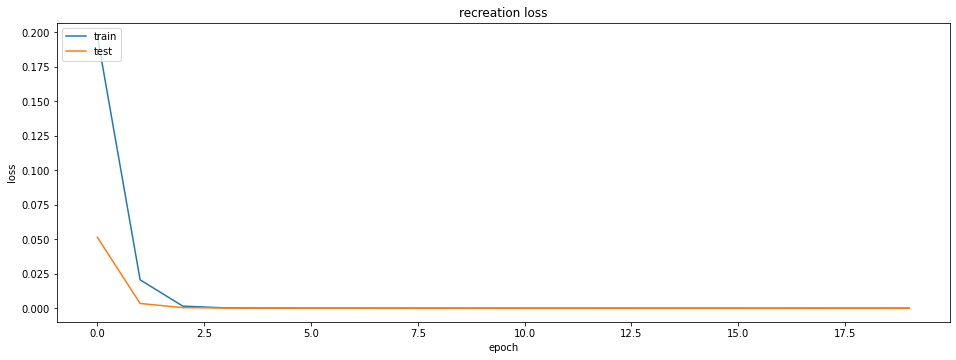

Intlier max value: 4.3355372e-05 Index Val: 918
outlier max value: 4.4526525e-05 Index Val: 9
outlier min value: 3.2376265e-06 Index Val: 30


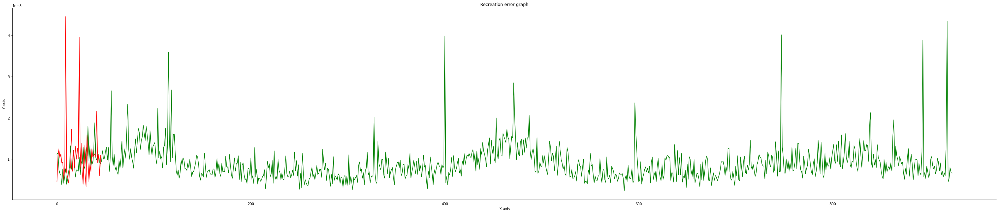

Total member in inlear: 924
Total False alarm: 915
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.90      0.01      0.02       924
           1       0.05      0.98      0.09        46

    accuracy                           0.06       970
   macro avg       0.47      0.49      0.05       970
weighted avg       0.86      0.06      0.02       970



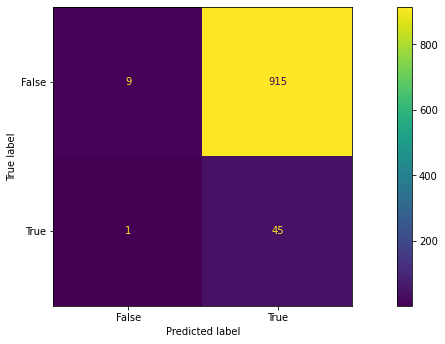

Epoch 1/200
24/24 [==============================] - 4s 147ms/step - loss: 0.1713 - val_loss: 0.0406
Epoch 2/200
24/24 [==============================] - 3s 136ms/step - loss: 0.0228 - val_loss: 0.0071
Epoch 3/200
24/24 [==============================] - 3s 140ms/step - loss: 0.0022 - val_loss: 4.3638e-04
Epoch 4/200
24/24 [==============================] - 3s 134ms/step - loss: 2.6009e-04 - val_loss: 1.6582e-04
Epoch 5/200
24/24 [==============================] - 3s 135ms/step - loss: 1.2799e-04 - val_loss: 9.8898e-05
Epoch 6/200
24/24 [==============================] - 3s 137ms/step - loss: 8.6559e-05 - val_loss: 1.0413e-04
Epoch 7/200
24/24 [==============================] - 3s 138ms/step - loss: 6.9863e-05 - val_loss: 7.3383e-05
Epoch 8/200
24/24 [==============================] - 3s 140ms/step - loss: 5.8687e-05 - val_loss: 4.6150e-05
Epoch 9/200
24/24 [==============================] - 3s 137ms/step - loss: 4.7528e-05 - val_loss: 4.5911e-05
Epoch 10/200
24/24 [===================

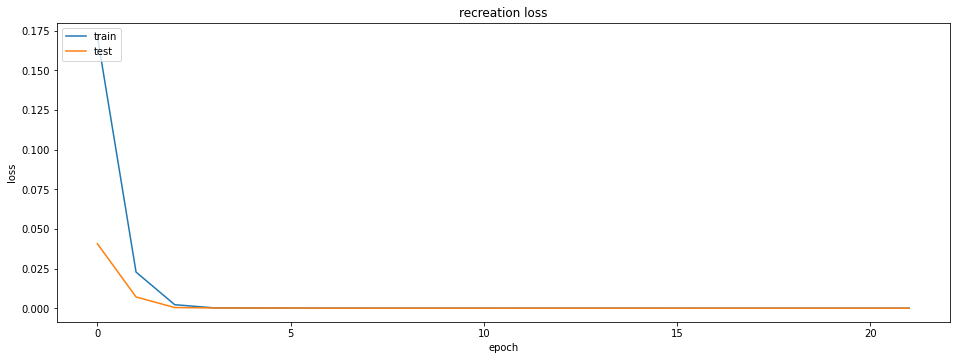

Intlier max value: 4.7965506e-05 Index Val: 56
outlier max value: 3.7270533e-05 Index Val: 9
outlier min value: 8.667607e-06 Index Val: 30


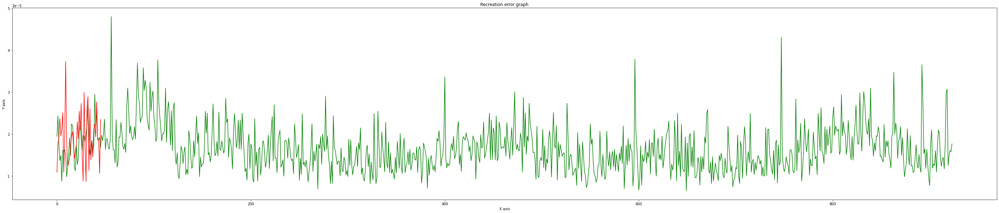

Total member in inlear: 924
Total False alarm: 899
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.96      0.03      0.05       924
           1       0.05      0.98      0.09        46

    accuracy                           0.07       970
   macro avg       0.50      0.50      0.07       970
weighted avg       0.92      0.07      0.05       970



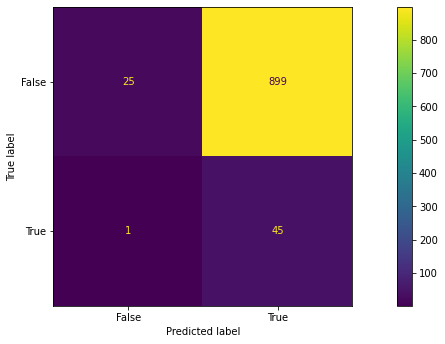

Epoch 1/200
24/24 [==============================] - 4s 148ms/step - loss: 0.1620 - val_loss: 0.0255
Epoch 2/200
24/24 [==============================] - 3s 138ms/step - loss: 0.0092 - val_loss: 0.0022
Epoch 3/200
24/24 [==============================] - 3s 137ms/step - loss: 0.0010 - val_loss: 3.8820e-04
Epoch 4/200
24/24 [==============================] - 3s 139ms/step - loss: 2.3155e-04 - val_loss: 1.5406e-04
Epoch 5/200
24/24 [==============================] - 3s 138ms/step - loss: 1.1692e-04 - val_loss: 9.6405e-05
Epoch 6/200
24/24 [==============================] - 3s 138ms/step - loss: 8.4902e-05 - val_loss: 8.2717e-05
Epoch 7/200
24/24 [==============================] - 3s 139ms/step - loss: 6.7040e-05 - val_loss: 6.7908e-05
Epoch 8/200
24/24 [==============================] - 3s 137ms/step - loss: 5.4023e-05 - val_loss: 4.6930e-05
Epoch 9/200
24/24 [==============================] - 3s 133ms/step - loss: 4.7557e-05 - val_loss: 4.1927e-05
Epoch 10/200
24/24 [===================

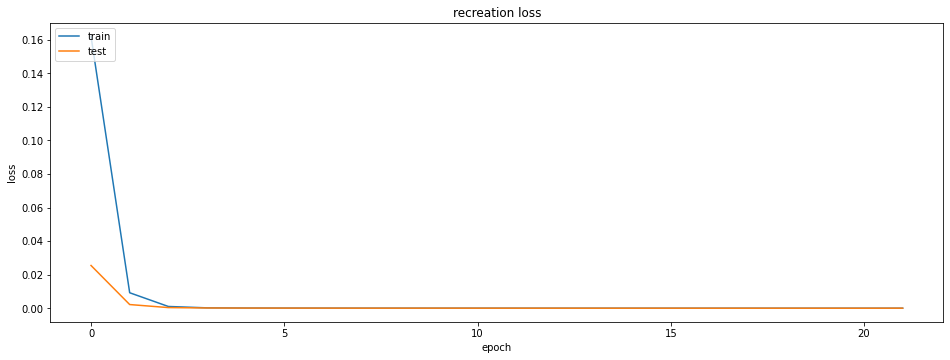

Intlier max value: 9.411158e-05 Index Val: 747
outlier max value: 9.593905e-05 Index Val: 23
outlier min value: 2.8363773e-05 Index Val: 42


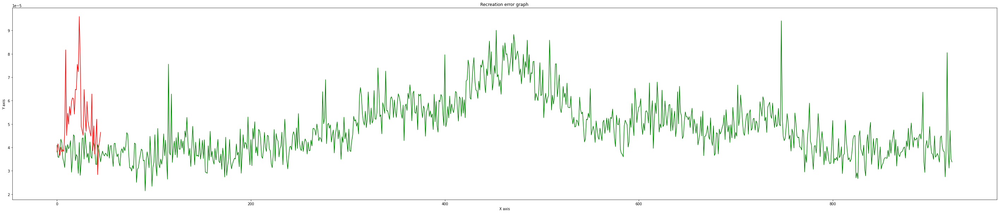

Total member in inlear: 924
Total False alarm: 912
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.92      0.01      0.03       924
           1       0.05      0.98      0.09        46

    accuracy                           0.06       970
   macro avg       0.49      0.50      0.06       970
weighted avg       0.88      0.06      0.03       970



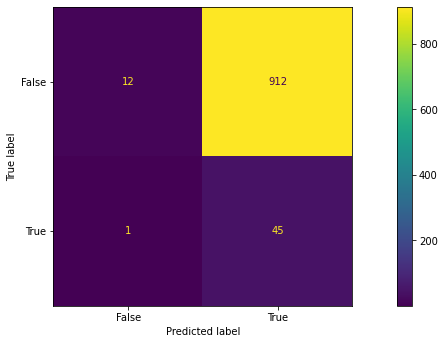

Epoch 1/200
24/24 [==============================] - 4s 149ms/step - loss: 0.1886 - val_loss: 0.0474
Epoch 2/200
24/24 [==============================] - 3s 134ms/step - loss: 0.0248 - val_loss: 0.0068
Epoch 3/200
24/24 [==============================] - 3s 137ms/step - loss: 0.0029 - val_loss: 9.5775e-04
Epoch 4/200
24/24 [==============================] - 3s 137ms/step - loss: 4.4682e-04 - val_loss: 2.2142e-04
Epoch 5/200
24/24 [==============================] - 3s 135ms/step - loss: 1.4774e-04 - val_loss: 1.0186e-04
Epoch 6/200
24/24 [==============================] - 3s 137ms/step - loss: 8.3451e-05 - val_loss: 8.8037e-05
Epoch 7/200
24/24 [==============================] - 4s 156ms/step - loss: 6.1597e-05 - val_loss: 5.1676e-05
Epoch 8/200
24/24 [==============================] - 4s 149ms/step - loss: 4.6641e-05 - val_loss: 4.2300e-05
Epoch 9/200
24/24 [==============================] - 3s 137ms/step - loss: 3.6853e-05 - val_loss: 4.9465e-05
Epoch 10/200
24/24 [===================

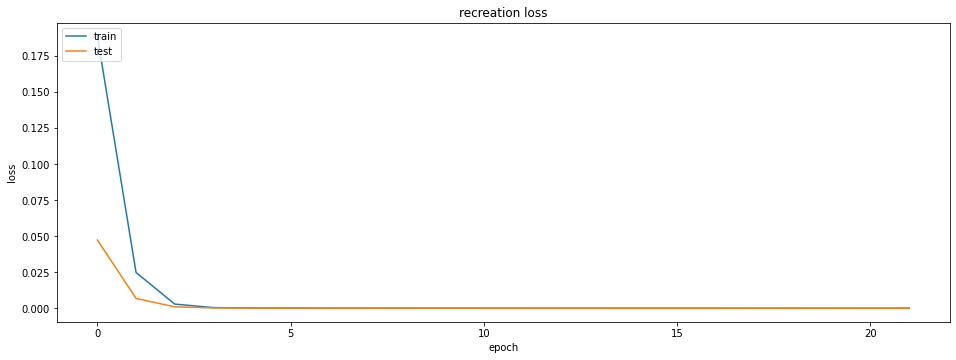

Intlier max value: 6.29735e-05 Index Val: 56
outlier max value: 0.00010557162 Index Val: 9
outlier min value: 5.1223224e-06 Index Val: 27


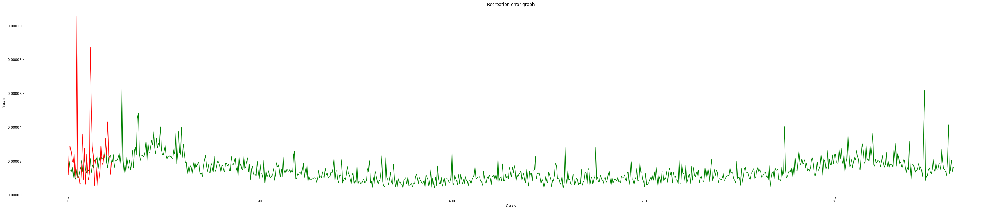

Total member in inlear: 924
Total False alarm: 904
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.95      0.02      0.04       924
           1       0.05      0.98      0.09        46

    accuracy                           0.07       970
   macro avg       0.50      0.50      0.07       970
weighted avg       0.91      0.07      0.04       970



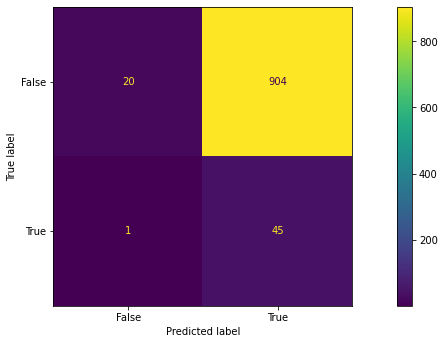

Epoch 1/200
24/24 [==============================] - 4s 149ms/step - loss: 0.2062 - val_loss: 0.0532
Epoch 2/200
24/24 [==============================] - 3s 138ms/step - loss: 0.0215 - val_loss: 0.0038
Epoch 3/200
24/24 [==============================] - 3s 136ms/step - loss: 0.0017 - val_loss: 4.8340e-04
Epoch 4/200
24/24 [==============================] - 3s 141ms/step - loss: 2.8669e-04 - val_loss: 1.6192e-04
Epoch 5/200
24/24 [==============================] - 3s 137ms/step - loss: 1.2029e-04 - val_loss: 9.2678e-05
Epoch 6/200
24/24 [==============================] - 3s 139ms/step - loss: 7.7388e-05 - val_loss: 6.5414e-05
Epoch 7/200
24/24 [==============================] - 3s 140ms/step - loss: 5.8284e-05 - val_loss: 5.5732e-05
Epoch 8/200
24/24 [==============================] - 3s 137ms/step - loss: 4.8410e-05 - val_loss: 8.4233e-05
Epoch 9/200
24/24 [==============================] - 3s 139ms/step - loss: 4.6678e-05 - val_loss: 4.1618e-05
Epoch 10/200
24/24 [===================

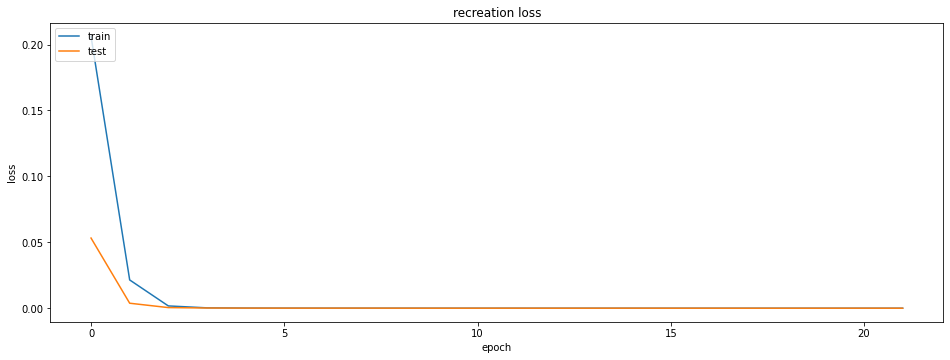

Intlier max value: 6.213612e-05 Index Val: 747
outlier max value: 4.1259853e-05 Index Val: 9
outlier min value: 9.741056e-06 Index Val: 10


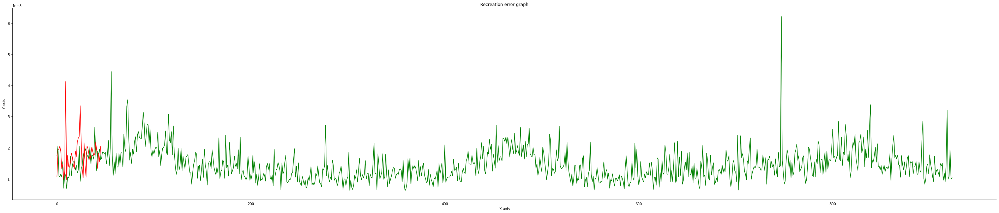

Total member in inlear: 924
Total False alarm: 780
Total member in Outlier: 46
Total missed true alarm: 2
              precision    recall  f1-score   support

           0       0.99      0.16      0.27       924
           1       0.05      0.96      0.10        46

    accuracy                           0.19       970
   macro avg       0.52      0.56      0.19       970
weighted avg       0.94      0.19      0.26       970



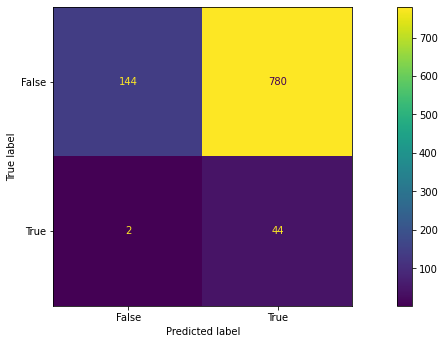

Epoch 1/200
24/24 [==============================] - 4s 148ms/step - loss: 0.1920 - val_loss: 0.0330
Epoch 2/200
24/24 [==============================] - 3s 139ms/step - loss: 0.0168 - val_loss: 0.0040
Epoch 3/200
24/24 [==============================] - 3s 136ms/step - loss: 0.0016 - val_loss: 4.7972e-04
Epoch 4/200
24/24 [==============================] - 3s 134ms/step - loss: 2.7481e-04 - val_loss: 1.3369e-04
Epoch 5/200
24/24 [==============================] - 3s 136ms/step - loss: 1.1547e-04 - val_loss: 1.0363e-04
Epoch 6/200
24/24 [==============================] - 3s 137ms/step - loss: 8.2596e-05 - val_loss: 6.8535e-05
Epoch 7/200
24/24 [==============================] - 3s 140ms/step - loss: 6.3679e-05 - val_loss: 5.9582e-05
Epoch 8/200
24/24 [==============================] - 3s 142ms/step - loss: 4.9119e-05 - val_loss: 4.8441e-05
Epoch 9/200
24/24 [==============================] - 3s 137ms/step - loss: 4.1866e-05 - val_loss: 3.9202e-05
Epoch 10/200
24/24 [===================

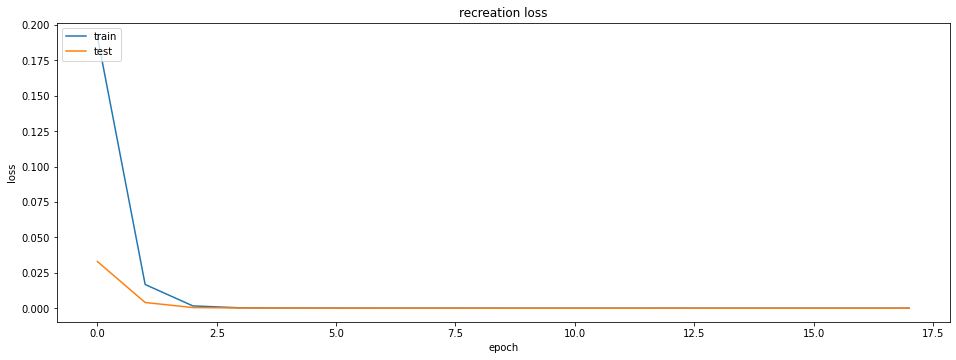

Intlier max value: 0.000112069145 Index Val: 918
outlier max value: 0.0001330738 Index Val: 9
outlier min value: 1.34194825e-05 Index Val: 22


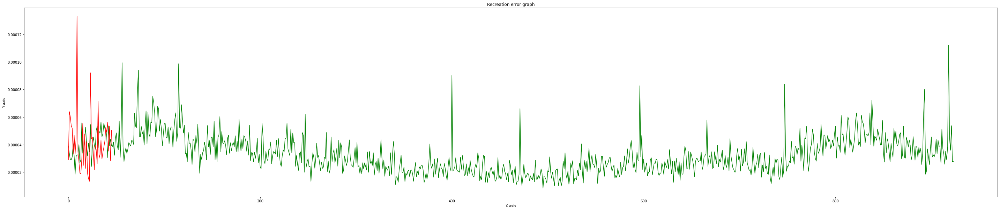

Total member in inlear: 924
Total False alarm: 897
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.96      0.03      0.06       924
           1       0.05      0.98      0.09        46

    accuracy                           0.07       970
   macro avg       0.51      0.50      0.07       970
weighted avg       0.92      0.07      0.06       970



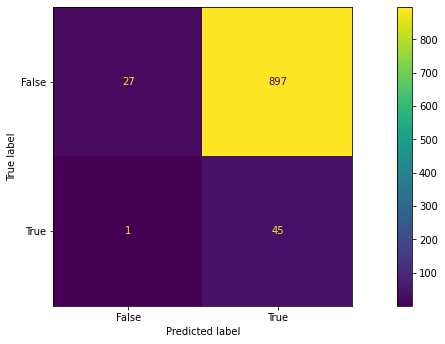

Epoch 1/200
24/24 [==============================] - 5s 164ms/step - loss: 0.1815 - val_loss: 0.0673
Epoch 2/200
24/24 [==============================] - 4s 149ms/step - loss: 0.0365 - val_loss: 0.0105
Epoch 3/200
24/24 [==============================] - 3s 140ms/step - loss: 0.0040 - val_loss: 9.2259e-04
Epoch 4/200
24/24 [==============================] - 3s 135ms/step - loss: 4.1883e-04 - val_loss: 1.9832e-04
Epoch 5/200
24/24 [==============================] - 3s 136ms/step - loss: 1.5129e-04 - val_loss: 1.0307e-04
Epoch 6/200
24/24 [==============================] - 3s 137ms/step - loss: 8.7406e-05 - val_loss: 9.5843e-05
Epoch 7/200
24/24 [==============================] - 3s 137ms/step - loss: 7.0984e-05 - val_loss: 5.8267e-05
Epoch 8/200
24/24 [==============================] - 3s 137ms/step - loss: 5.1044e-05 - val_loss: 6.4543e-05
Epoch 9/200
24/24 [==============================] - 3s 141ms/step - loss: 4.3267e-05 - val_loss: 4.3373e-05
Epoch 10/200
24/24 [===================

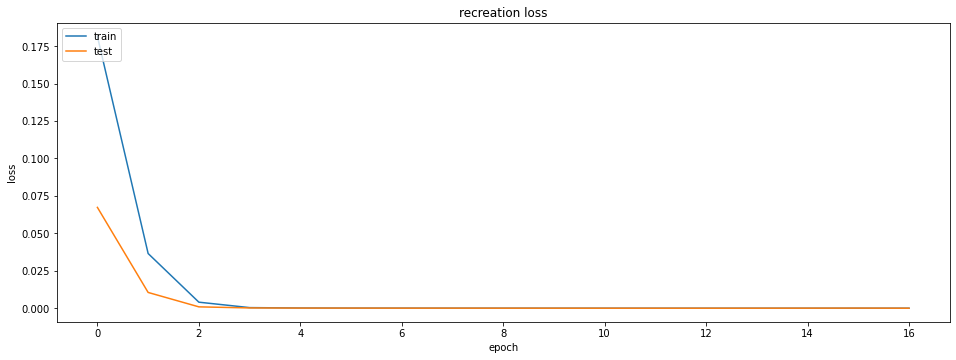

Intlier max value: 0.000109753884 Index Val: 747
outlier max value: 6.598335e-05 Index Val: 9
outlier min value: 4.369026e-06 Index Val: 30


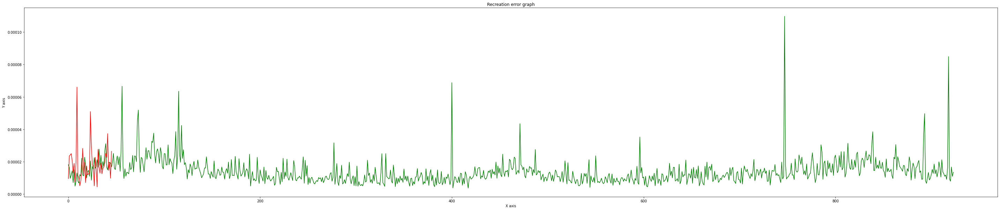

Total member in inlear: 924
Total False alarm: 920
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.80      0.00      0.01       924
           1       0.05      0.98      0.09        46

    accuracy                           0.05       970
   macro avg       0.42      0.49      0.05       970
weighted avg       0.76      0.05      0.01       970



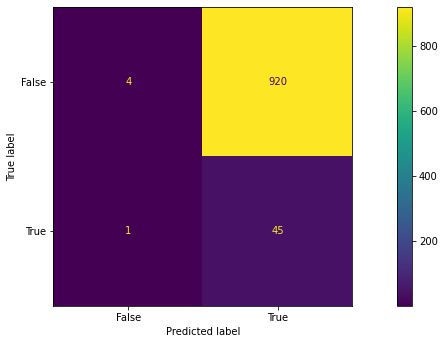

Epoch 1/200
24/24 [==============================] - 4s 144ms/step - loss: 0.1713 - val_loss: 0.0397
Epoch 2/200
24/24 [==============================] - 3s 134ms/step - loss: 0.0220 - val_loss: 0.0052
Epoch 3/200
24/24 [==============================] - 3s 139ms/step - loss: 0.0018 - val_loss: 4.1885e-04
Epoch 4/200
24/24 [==============================] - 3s 136ms/step - loss: 2.4111e-04 - val_loss: 1.4253e-04
Epoch 5/200
24/24 [==============================] - 3s 135ms/step - loss: 1.0874e-04 - val_loss: 8.9995e-05
Epoch 6/200
24/24 [==============================] - 3s 134ms/step - loss: 7.2935e-05 - val_loss: 6.4803e-05
Epoch 7/200
24/24 [==============================] - 3s 135ms/step - loss: 5.2182e-05 - val_loss: 6.1680e-05
Epoch 8/200
24/24 [==============================] - 3s 136ms/step - loss: 4.4270e-05 - val_loss: 4.2318e-05
Epoch 9/200
24/24 [==============================] - 3s 135ms/step - loss: 3.6472e-05 - val_loss: 3.3578e-05
Epoch 10/200
24/24 [===================

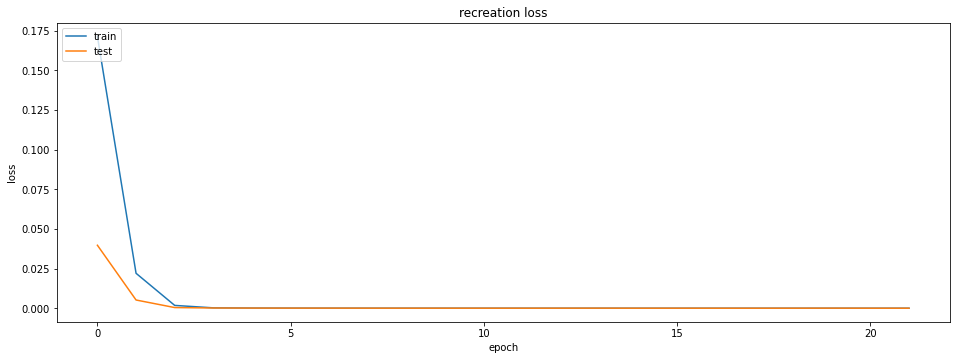

Intlier max value: 7.151652e-05 Index Val: 918
outlier max value: 4.9168535e-05 Index Val: 9
outlier min value: 5.6250724e-06 Index Val: 33


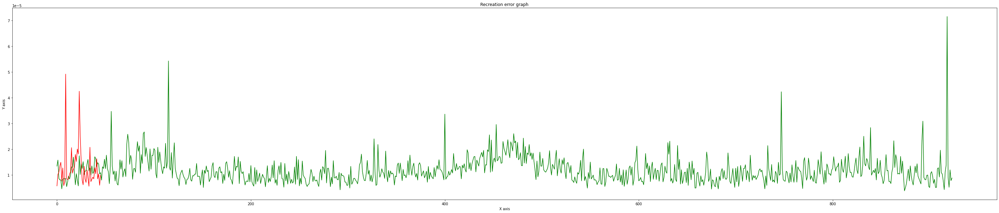

Total member in inlear: 924
Total False alarm: 892
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.97      0.03      0.07       924
           1       0.05      0.98      0.09        46

    accuracy                           0.08       970
   macro avg       0.51      0.51      0.08       970
weighted avg       0.93      0.08      0.07       970



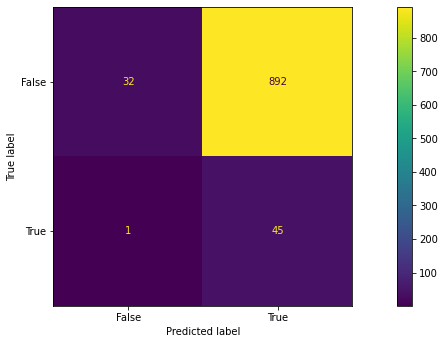

Epoch 1/200
24/24 [==============================] - 4s 149ms/step - loss: 0.1558 - val_loss: 0.0318
Epoch 2/200
24/24 [==============================] - 3s 134ms/step - loss: 0.0138 - val_loss: 0.0022
Epoch 3/200
24/24 [==============================] - 3s 135ms/step - loss: 9.1696e-04 - val_loss: 3.2961e-04
Epoch 4/200
24/24 [==============================] - 3s 141ms/step - loss: 2.5311e-04 - val_loss: 1.8502e-04
Epoch 5/200
24/24 [==============================] - 3s 135ms/step - loss: 1.1666e-04 - val_loss: 8.5905e-05
Epoch 6/200
24/24 [==============================] - 3s 136ms/step - loss: 6.9417e-05 - val_loss: 6.2654e-05
Epoch 7/200
24/24 [==============================] - 3s 138ms/step - loss: 4.8420e-05 - val_loss: 5.0285e-05
Epoch 8/200
24/24 [==============================] - 3s 141ms/step - loss: 3.6896e-05 - val_loss: 4.9446e-05
Epoch 9/200
24/24 [==============================] - 3s 136ms/step - loss: 3.3175e-05 - val_loss: 3.4935e-05
Epoch 10/200
24/24 [===============

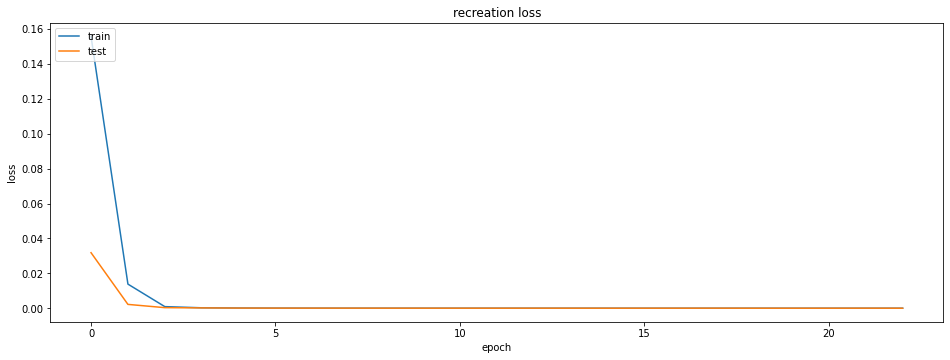

Intlier max value: 5.2725867e-05 Index Val: 56
outlier max value: 5.925407e-05 Index Val: 9
outlier min value: 5.5133887e-06 Index Val: 0


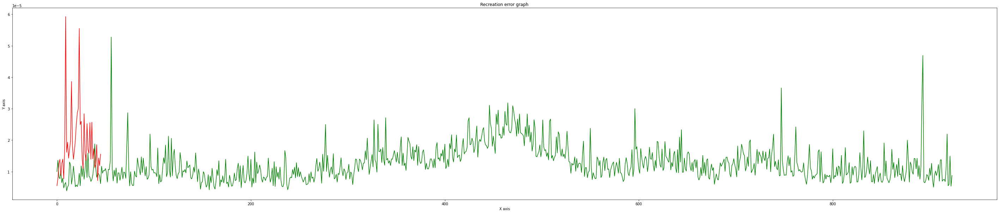

Total member in inlear: 924
Total False alarm: 896
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.97      0.03      0.06       924
           1       0.05      0.98      0.09        46

    accuracy                           0.08       970
   macro avg       0.51      0.50      0.07       970
weighted avg       0.92      0.08      0.06       970



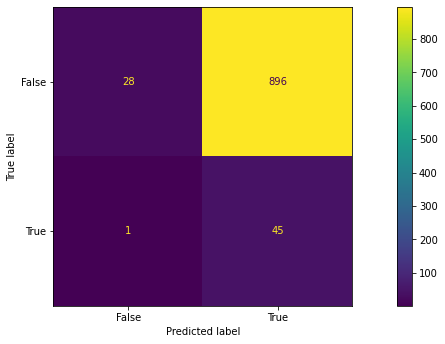

Epoch 1/200
24/24 [==============================] - 5s 152ms/step - loss: 0.1586 - val_loss: 0.0409
Epoch 2/200
24/24 [==============================] - 3s 137ms/step - loss: 0.0166 - val_loss: 0.0031
Epoch 3/200
24/24 [==============================] - 3s 137ms/step - loss: 0.0014 - val_loss: 4.3078e-04
Epoch 4/200
24/24 [==============================] - 3s 138ms/step - loss: 2.5913e-04 - val_loss: 2.0858e-04
Epoch 5/200
24/24 [==============================] - 3s 136ms/step - loss: 1.3441e-04 - val_loss: 9.9689e-05
Epoch 6/200
24/24 [==============================] - 3s 136ms/step - loss: 8.8219e-05 - val_loss: 8.1170e-05
Epoch 7/200
24/24 [==============================] - 3s 134ms/step - loss: 7.2179e-05 - val_loss: 6.1619e-05
Epoch 8/200
24/24 [==============================] - 3s 142ms/step - loss: 5.7488e-05 - val_loss: 7.5111e-05
Epoch 9/200
24/24 [==============================] - 3s 136ms/step - loss: 4.5315e-05 - val_loss: 6.5703e-05
Epoch 10/200
24/24 [===================

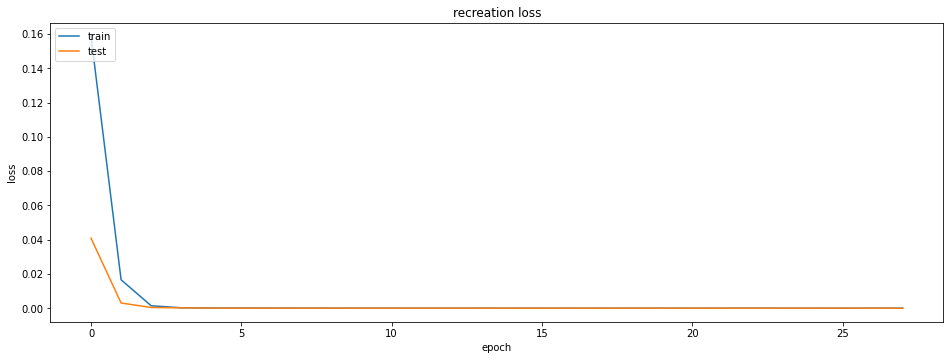

Intlier max value: 7.773225e-05 Index Val: 893
outlier max value: 0.00013858381 Index Val: 9
outlier min value: 1.7085036e-05 Index Val: 32


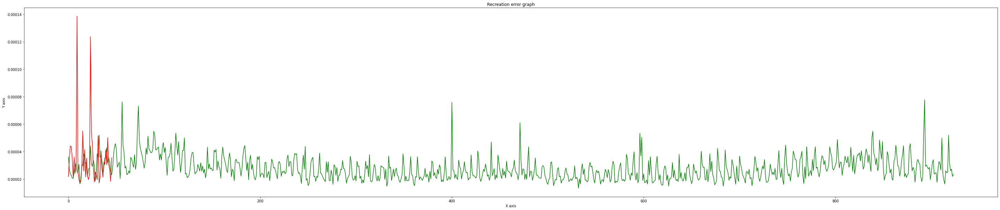

Total member in inlear: 924
Total False alarm: 886
Total member in Outlier: 46
Total missed true alarm: 2
              precision    recall  f1-score   support

           0       0.95      0.04      0.08       924
           1       0.05      0.96      0.09        46

    accuracy                           0.08       970
   macro avg       0.50      0.50      0.08       970
weighted avg       0.91      0.08      0.08       970



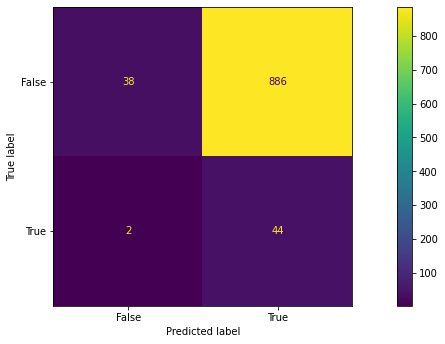

Epoch 1/200
24/24 [==============================] - 4s 148ms/step - loss: 0.1690 - val_loss: 0.0293
Epoch 2/200
24/24 [==============================] - 3s 137ms/step - loss: 0.0135 - val_loss: 0.0018
Epoch 3/200
24/24 [==============================] - 3s 136ms/step - loss: 8.9417e-04 - val_loss: 2.9983e-04
Epoch 4/200
24/24 [==============================] - 3s 137ms/step - loss: 2.1386e-04 - val_loss: 1.3366e-04
Epoch 5/200
24/24 [==============================] - 3s 140ms/step - loss: 1.1038e-04 - val_loss: 1.0130e-04
Epoch 6/200
24/24 [==============================] - 3s 136ms/step - loss: 7.5815e-05 - val_loss: 6.1793e-05
Epoch 7/200
24/24 [==============================] - 3s 136ms/step - loss: 5.0971e-05 - val_loss: 4.4705e-05
Epoch 8/200
24/24 [==============================] - 3s 135ms/step - loss: 3.9013e-05 - val_loss: 4.7918e-05
Epoch 9/200
24/24 [==============================] - 3s 135ms/step - loss: 3.3501e-05 - val_loss: 2.9022e-05
Epoch 10/200
24/24 [===============

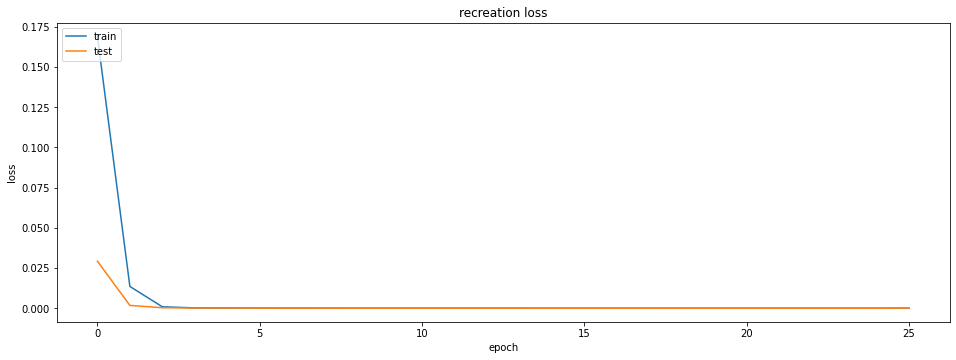

Intlier max value: 0.00013068649 Index Val: 447
outlier max value: 0.00013125784 Index Val: 22
outlier min value: 6.3910025e-05 Index Val: 42


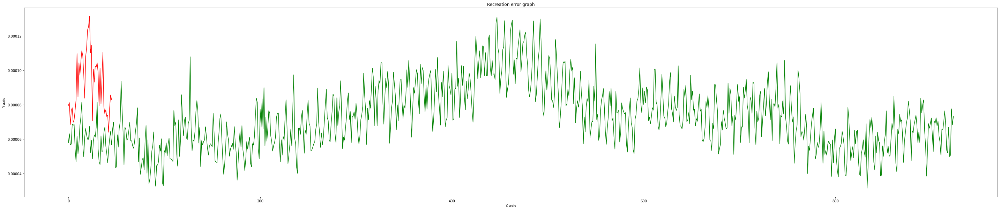

Total member in inlear: 924
Total False alarm: 592
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       1.00      0.36      0.53       924
           1       0.07      0.98      0.13        46

    accuracy                           0.39       970
   macro avg       0.53      0.67      0.33       970
weighted avg       0.95      0.39      0.51       970



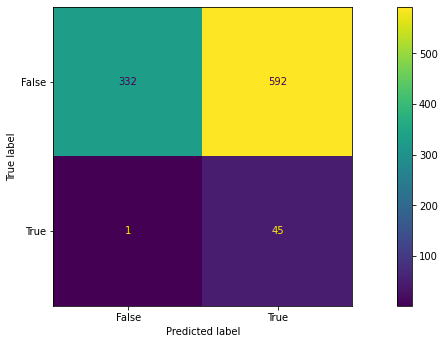

Epoch 1/200
24/24 [==============================] - 4s 151ms/step - loss: 0.1506 - val_loss: 0.0203
Epoch 2/200
24/24 [==============================] - 3s 138ms/step - loss: 0.0071 - val_loss: 0.0015
Epoch 3/200
24/24 [==============================] - 3s 139ms/step - loss: 7.3517e-04 - val_loss: 3.1587e-04
Epoch 4/200
24/24 [==============================] - 3s 143ms/step - loss: 2.1133e-04 - val_loss: 1.6717e-04
Epoch 5/200
24/24 [==============================] - 3s 137ms/step - loss: 1.2333e-04 - val_loss: 1.0087e-04
Epoch 6/200
24/24 [==============================] - 3s 139ms/step - loss: 9.2594e-05 - val_loss: 8.2151e-05
Epoch 7/200
24/24 [==============================] - 3s 140ms/step - loss: 7.3090e-05 - val_loss: 6.6473e-05
Epoch 8/200
24/24 [==============================] - 3s 141ms/step - loss: 6.2389e-05 - val_loss: 5.9884e-05
Epoch 9/200
24/24 [==============================] - 3s 143ms/step - loss: 5.4030e-05 - val_loss: 5.0567e-05
Epoch 10/200
24/24 [===============

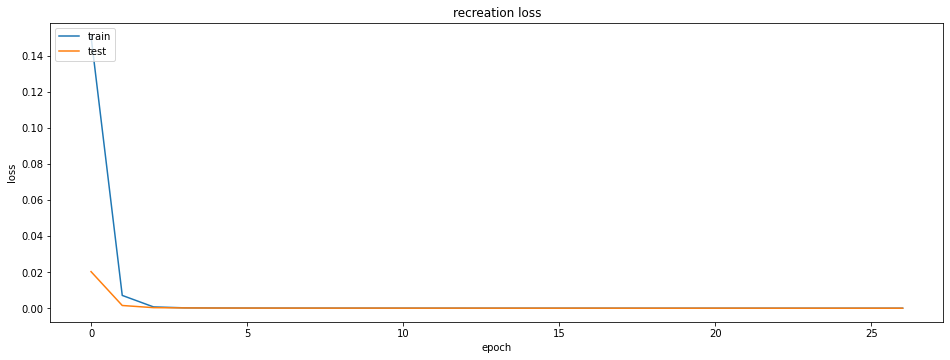

Intlier max value: 6.342546e-05 Index Val: 56
outlier max value: 4.388851e-05 Index Val: 23
outlier min value: 7.703152e-06 Index Val: 30


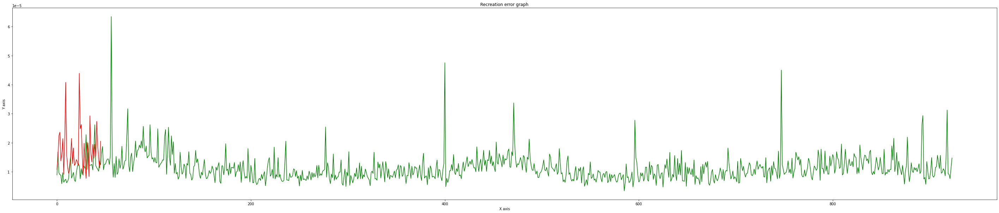

Total member in inlear: 924
Total False alarm: 758
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.99      0.18      0.30       924
           1       0.06      0.98      0.11        46

    accuracy                           0.22       970
   macro avg       0.53      0.58      0.21       970
weighted avg       0.95      0.22      0.29       970



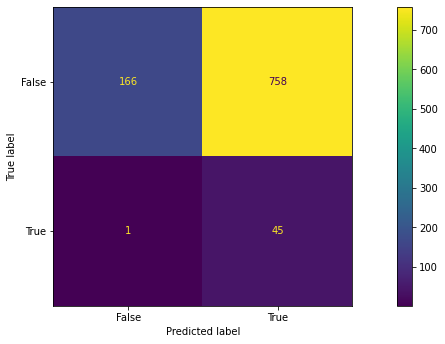

Epoch 1/200
24/24 [==============================] - 4s 146ms/step - loss: 0.2049 - val_loss: 0.0311
Epoch 2/200
24/24 [==============================] - 3s 139ms/step - loss: 0.0138 - val_loss: 0.0039
Epoch 3/200
24/24 [==============================] - 3s 137ms/step - loss: 0.0016 - val_loss: 5.4144e-04
Epoch 4/200
24/24 [==============================] - 3s 139ms/step - loss: 3.3334e-04 - val_loss: 2.3043e-04
Epoch 5/200
24/24 [==============================] - 3s 135ms/step - loss: 1.5491e-04 - val_loss: 1.1284e-04
Epoch 6/200
24/24 [==============================] - 3s 139ms/step - loss: 9.7076e-05 - val_loss: 8.1213e-05
Epoch 7/200
24/24 [==============================] - 3s 139ms/step - loss: 7.4271e-05 - val_loss: 6.5711e-05
Epoch 8/200
24/24 [==============================] - 3s 142ms/step - loss: 6.2748e-05 - val_loss: 5.8673e-05
Epoch 9/200
24/24 [==============================] - 3s 137ms/step - loss: 5.3789e-05 - val_loss: 5.1261e-05
Epoch 10/200
24/24 [===================

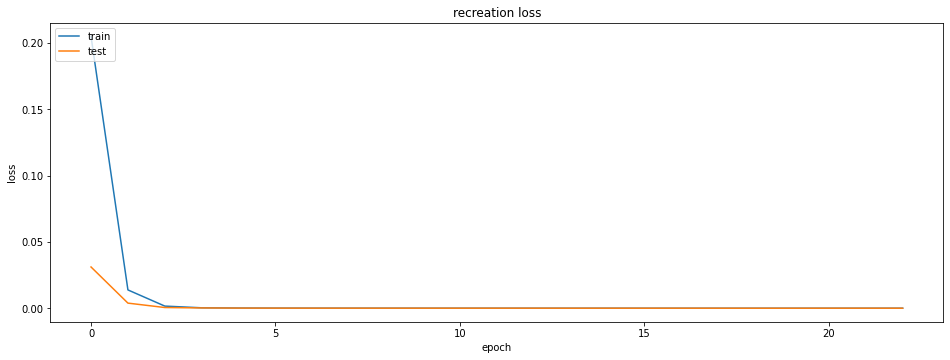

Intlier max value: 0.00011648274 Index Val: 747
outlier max value: 9.818886e-05 Index Val: 9
outlier min value: 1.4855696e-05 Index Val: 27


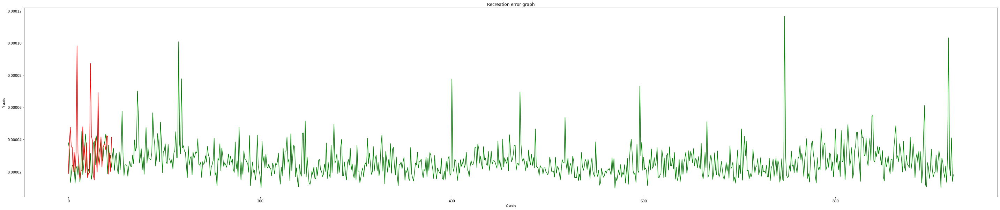

Total member in inlear: 924
Total False alarm: 871
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.98      0.06      0.11       924
           1       0.05      0.98      0.09        46

    accuracy                           0.10       970
   macro avg       0.52      0.52      0.10       970
weighted avg       0.94      0.10      0.11       970



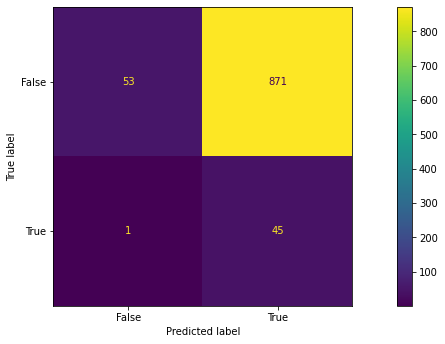

Epoch 1/200
24/24 [==============================] - 5s 151ms/step - loss: 0.1995 - val_loss: 0.0443
Epoch 2/200
24/24 [==============================] - 3s 139ms/step - loss: 0.0204 - val_loss: 0.0046
Epoch 3/200
24/24 [==============================] - 3s 136ms/step - loss: 0.0016 - val_loss: 3.5269e-04
Epoch 4/200
24/24 [==============================] - 3s 135ms/step - loss: 2.4155e-04 - val_loss: 1.4480e-04
Epoch 5/200
24/24 [==============================] - 3s 136ms/step - loss: 1.1727e-04 - val_loss: 9.3189e-05
Epoch 6/200
24/24 [==============================] - 3s 131ms/step - loss: 8.2678e-05 - val_loss: 7.3692e-05
Epoch 7/200
24/24 [==============================] - 3s 138ms/step - loss: 6.6970e-05 - val_loss: 5.8243e-05
Epoch 8/200
24/24 [==============================] - 3s 138ms/step - loss: 5.3593e-05 - val_loss: 4.9039e-05
Epoch 9/200
24/24 [==============================] - 3s 141ms/step - loss: 4.4394e-05 - val_loss: 4.5863e-05
Epoch 10/200
24/24 [===================

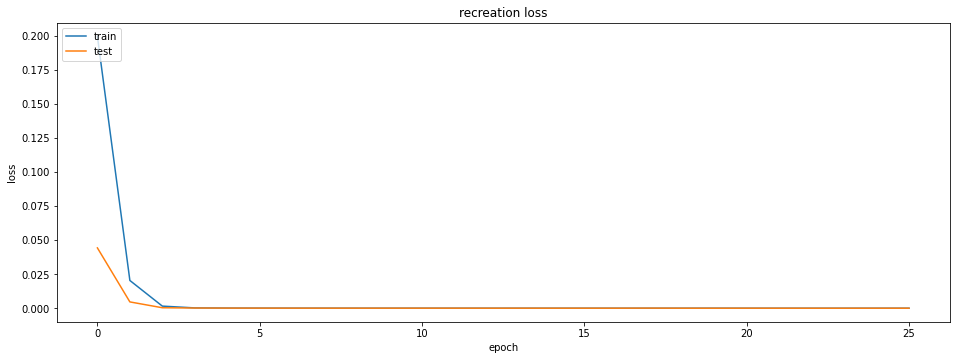

Intlier max value: 5.7792804e-05 Index Val: 471
outlier max value: 4.815387e-05 Index Val: 21
outlier min value: 9.905427e-06 Index Val: 42


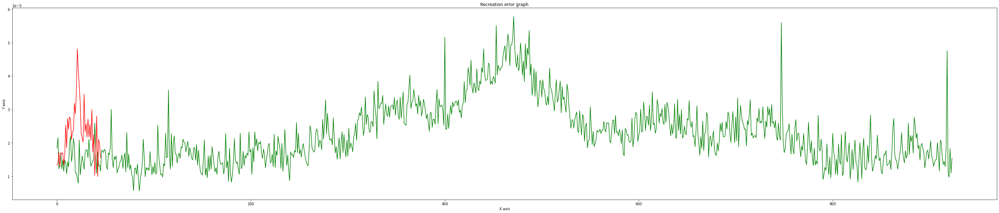

Total member in inlear: 924
Total False alarm: 905
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.95      0.02      0.04       924
           1       0.05      0.98      0.09        46

    accuracy                           0.07       970
   macro avg       0.50      0.50      0.07       970
weighted avg       0.91      0.07      0.04       970



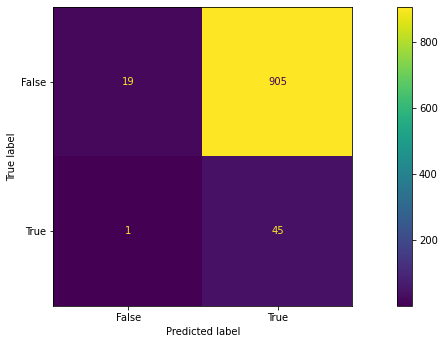

Epoch 1/200
24/24 [==============================] - 4s 143ms/step - loss: 0.1807 - val_loss: 0.0192
Epoch 2/200
24/24 [==============================] - 3s 135ms/step - loss: 0.0080 - val_loss: 0.0019
Epoch 3/200
24/24 [==============================] - 3s 137ms/step - loss: 8.0571e-04 - val_loss: 3.1377e-04
Epoch 4/200
24/24 [==============================] - 3s 132ms/step - loss: 1.7413e-04 - val_loss: 1.2962e-04
Epoch 5/200
24/24 [==============================] - 3s 134ms/step - loss: 1.1446e-04 - val_loss: 9.2419e-05
Epoch 6/200
24/24 [==============================] - 3s 131ms/step - loss: 8.8779e-05 - val_loss: 1.0369e-04
Epoch 7/200
24/24 [==============================] - 3s 132ms/step - loss: 8.4685e-05 - val_loss: 9.0186e-05
Epoch 8/200
24/24 [==============================] - 3s 136ms/step - loss: 7.7059e-05 - val_loss: 7.0856e-05
Epoch 9/200
24/24 [==============================] - 3s 137ms/step - loss: 6.6287e-05 - val_loss: 6.8221e-05
Epoch 10/200
24/24 [===============

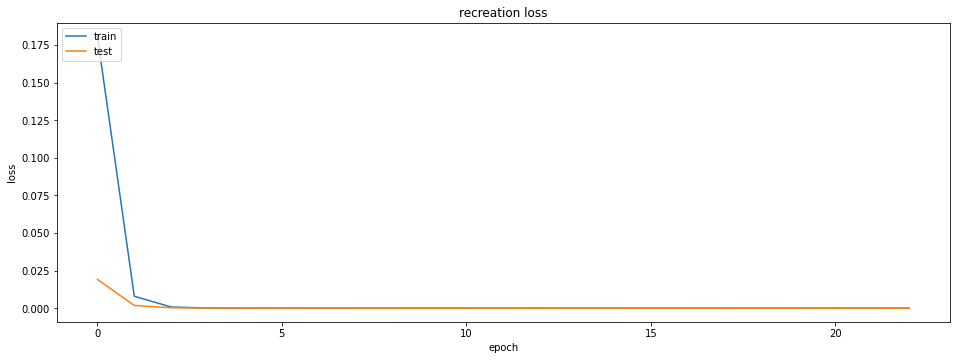

Intlier max value: 0.00012409667 Index Val: 918
outlier max value: 9.227138e-05 Index Val: 9
outlier min value: 1.704394e-05 Index Val: 27


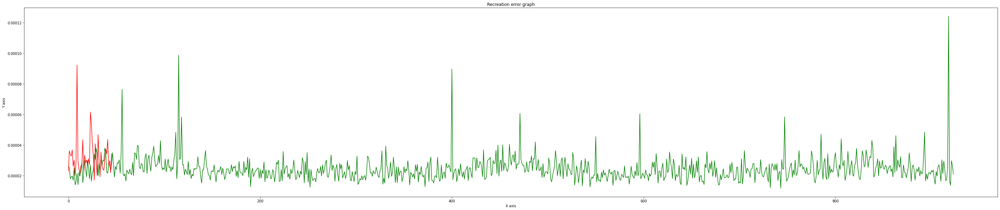

Total member in inlear: 924
Total False alarm: 829
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.99      0.10      0.19       924
           1       0.05      0.98      0.10        46

    accuracy                           0.14       970
   macro avg       0.52      0.54      0.14       970
weighted avg       0.95      0.14      0.18       970



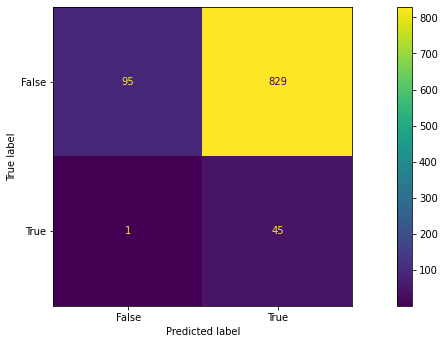

Epoch 1/200
24/24 [==============================] - 4s 147ms/step - loss: 0.1820 - val_loss: 0.0260
Epoch 2/200
24/24 [==============================] - 3s 135ms/step - loss: 0.0124 - val_loss: 0.0034
Epoch 3/200
24/24 [==============================] - 3s 136ms/step - loss: 0.0017 - val_loss: 4.2859e-04
Epoch 4/200
24/24 [==============================] - 3s 139ms/step - loss: 2.3354e-04 - val_loss: 1.5182e-04
Epoch 5/200
24/24 [==============================] - 3s 135ms/step - loss: 1.0895e-04 - val_loss: 9.0306e-05
Epoch 6/200
24/24 [==============================] - 3s 133ms/step - loss: 7.8583e-05 - val_loss: 6.9854e-05
Epoch 7/200
24/24 [==============================] - 3s 138ms/step - loss: 6.3534e-05 - val_loss: 6.4160e-05
Epoch 8/200
24/24 [==============================] - 3s 134ms/step - loss: 5.4429e-05 - val_loss: 4.7411e-05
Epoch 9/200
24/24 [==============================] - 3s 136ms/step - loss: 4.2523e-05 - val_loss: 4.3107e-05
Epoch 10/200
24/24 [===================

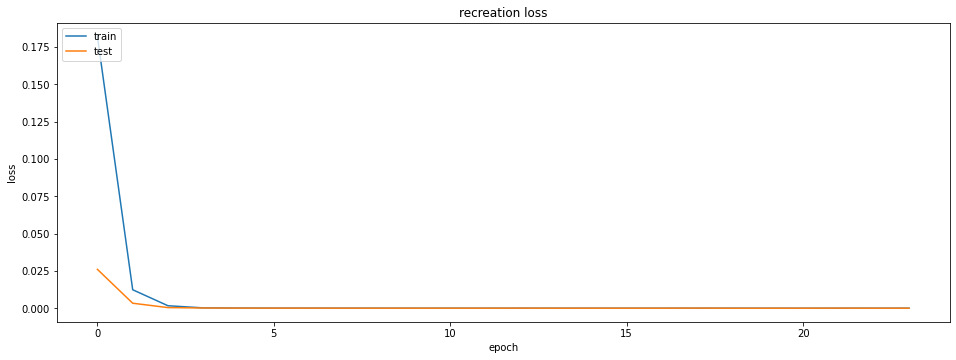

Intlier max value: 8.246122e-05 Index Val: 747
outlier max value: 6.941331e-05 Index Val: 9
outlier min value: 2.3857976e-05 Index Val: 5


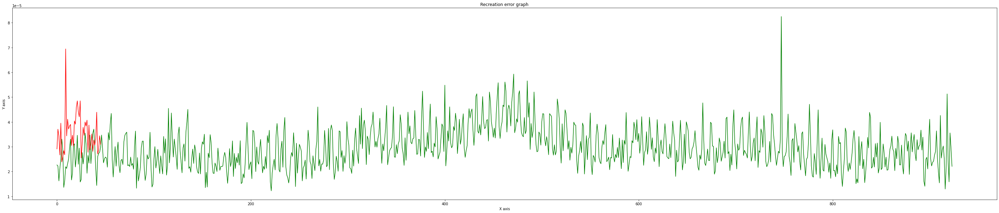

Total member in inlear: 924
Total False alarm: 669
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       1.00      0.28      0.43       924
           1       0.06      0.98      0.12        46

    accuracy                           0.31       970
   macro avg       0.53      0.63      0.28       970
weighted avg       0.95      0.31      0.42       970



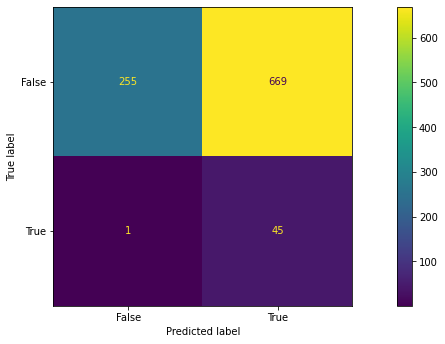

Epoch 1/200
24/24 [==============================] - 4s 149ms/step - loss: 0.1695 - val_loss: 0.0374
Epoch 2/200
24/24 [==============================] - 3s 135ms/step - loss: 0.0179 - val_loss: 0.0035
Epoch 3/200
24/24 [==============================] - 3s 135ms/step - loss: 0.0014 - val_loss: 3.6761e-04
Epoch 4/200
24/24 [==============================] - 3s 136ms/step - loss: 2.3265e-04 - val_loss: 1.3423e-04
Epoch 5/200
24/24 [==============================] - 3s 139ms/step - loss: 1.1165e-04 - val_loss: 8.8354e-05
Epoch 6/200
24/24 [==============================] - 3s 133ms/step - loss: 7.4817e-05 - val_loss: 6.6043e-05
Epoch 7/200
24/24 [==============================] - 3s 138ms/step - loss: 5.5028e-05 - val_loss: 5.2900e-05
Epoch 8/200
24/24 [==============================] - 3s 130ms/step - loss: 4.3076e-05 - val_loss: 4.4327e-05
Epoch 9/200
24/24 [==============================] - 3s 136ms/step - loss: 3.8896e-05 - val_loss: 5.1537e-05
Epoch 10/200
24/24 [===================

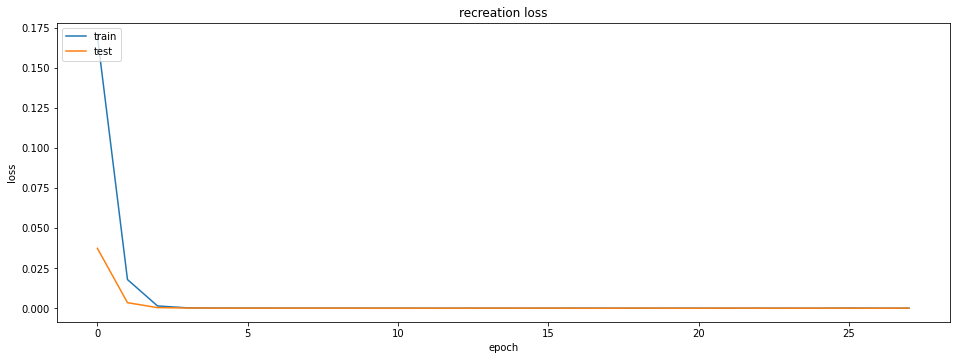

Intlier max value: 0.00012195399 Index Val: 73
outlier max value: 0.00011724878 Index Val: 9
outlier min value: 3.251417e-05 Index Val: 21


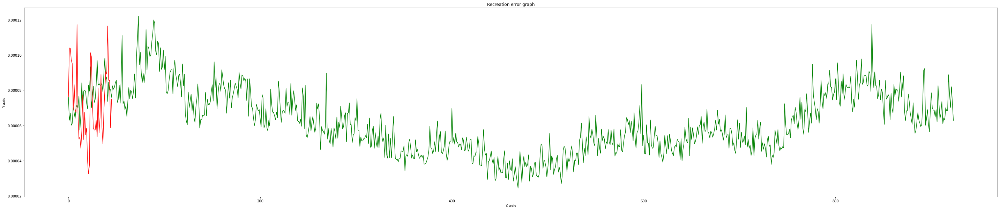

Total member in inlear: 924
Total False alarm: 901
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.96      0.02      0.05       924
           1       0.05      0.98      0.09        46

    accuracy                           0.07       970
   macro avg       0.50      0.50      0.07       970
weighted avg       0.92      0.07      0.05       970



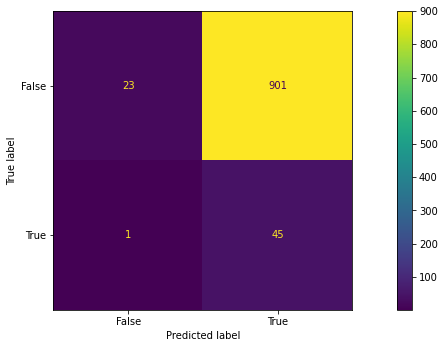

Epoch 1/200
24/24 [==============================] - 4s 149ms/step - loss: 0.1726 - val_loss: 0.0311
Epoch 2/200
24/24 [==============================] - 3s 138ms/step - loss: 0.0124 - val_loss: 0.0023
Epoch 3/200
24/24 [==============================] - 3s 135ms/step - loss: 9.6042e-04 - val_loss: 3.3964e-04
Epoch 4/200
24/24 [==============================] - 3s 129ms/step - loss: 2.0659e-04 - val_loss: 1.2954e-04
Epoch 5/200
24/24 [==============================] - 3s 137ms/step - loss: 1.0300e-04 - val_loss: 8.6372e-05
Epoch 6/200
24/24 [==============================] - 3s 137ms/step - loss: 7.0562e-05 - val_loss: 6.1673e-05
Epoch 7/200
24/24 [==============================] - 3s 133ms/step - loss: 5.8203e-05 - val_loss: 4.7420e-05
Epoch 8/200
24/24 [==============================] - 3s 136ms/step - loss: 4.7733e-05 - val_loss: 4.9582e-05
Epoch 9/200
24/24 [==============================] - 3s 138ms/step - loss: 3.9578e-05 - val_loss: 4.3725e-05
Epoch 10/200
24/24 [===============

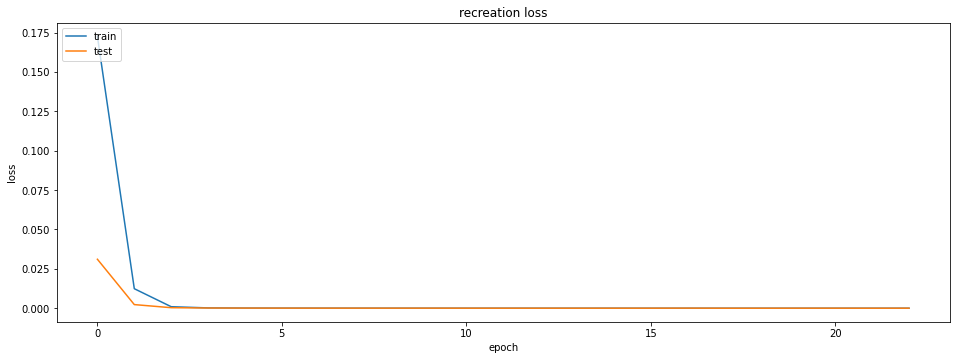

Intlier max value: 9.892774e-05 Index Val: 747
outlier max value: 8.4897314e-05 Index Val: 9
outlier min value: 1.7390583e-05 Index Val: 0


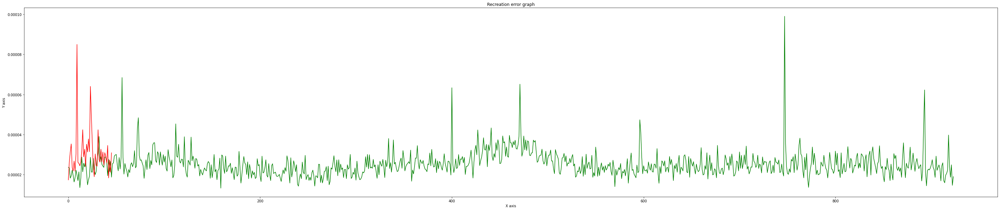

Total member in inlear: 924
Total False alarm: 883
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.98      0.04      0.08       924
           1       0.05      0.98      0.09        46

    accuracy                           0.09       970
   macro avg       0.51      0.51      0.09       970
weighted avg       0.93      0.09      0.09       970



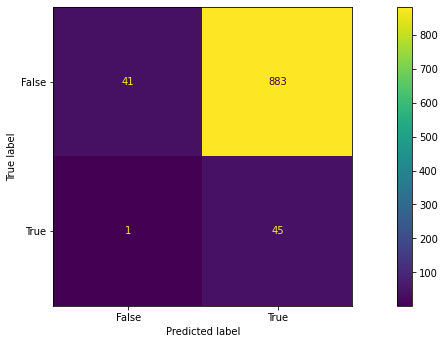

Epoch 1/200
24/24 [==============================] - 4s 143ms/step - loss: 0.1645 - val_loss: 0.0248
Epoch 2/200
24/24 [==============================] - 3s 140ms/step - loss: 0.0100 - val_loss: 0.0022
Epoch 3/200
24/24 [==============================] - 4s 153ms/step - loss: 0.0011 - val_loss: 3.9624e-04
Epoch 4/200
24/24 [==============================] - 3s 142ms/step - loss: 2.1825e-04 - val_loss: 1.2138e-04
Epoch 5/200
24/24 [==============================] - 3s 134ms/step - loss: 1.0300e-04 - val_loss: 7.8160e-05
Epoch 6/200
24/24 [==============================] - 3s 136ms/step - loss: 6.5339e-05 - val_loss: 6.3013e-05
Epoch 7/200
24/24 [==============================] - 3s 137ms/step - loss: 4.9391e-05 - val_loss: 4.7311e-05
Epoch 8/200
24/24 [==============================] - 3s 136ms/step - loss: 4.0684e-05 - val_loss: 4.5338e-05
Epoch 9/200
24/24 [==============================] - 3s 129ms/step - loss: 3.2227e-05 - val_loss: 2.8097e-05
Epoch 10/200
24/24 [===================

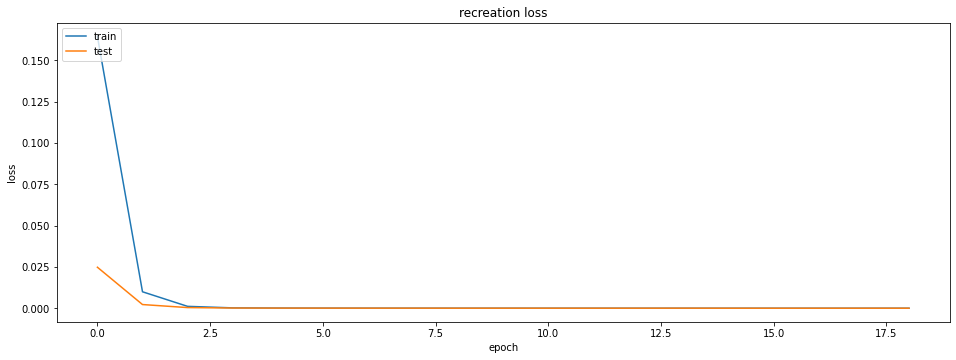

Intlier max value: 8.78297e-05 Index Val: 400
outlier max value: 4.6074485e-05 Index Val: 9
outlier min value: 3.352492e-06 Index Val: 12


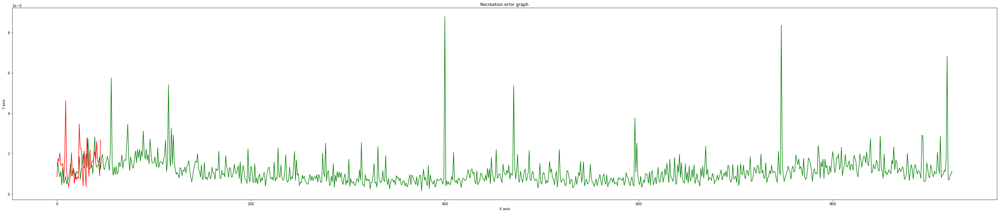

Total member in inlear: 924
Total False alarm: 911
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.93      0.01      0.03       924
           1       0.05      0.98      0.09        46

    accuracy                           0.06       970
   macro avg       0.49      0.50      0.06       970
weighted avg       0.89      0.06      0.03       970



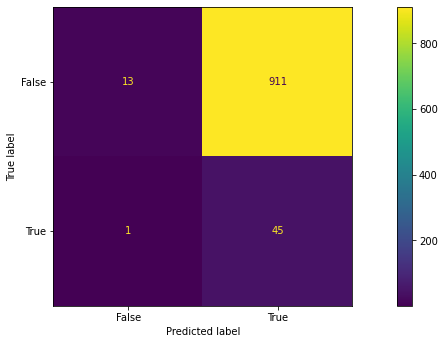

Epoch 1/200
24/24 [==============================] - 4s 144ms/step - loss: 0.1829 - val_loss: 0.0475
Epoch 2/200
24/24 [==============================] - 3s 135ms/step - loss: 0.0211 - val_loss: 0.0044
Epoch 3/200
24/24 [==============================] - 3s 133ms/step - loss: 0.0017 - val_loss: 3.4463e-04
Epoch 4/200
24/24 [==============================] - 3s 136ms/step - loss: 2.3659e-04 - val_loss: 1.4081e-04
Epoch 5/200
24/24 [==============================] - 3s 131ms/step - loss: 1.1246e-04 - val_loss: 8.6960e-05
Epoch 6/200
24/24 [==============================] - 3s 135ms/step - loss: 7.7530e-05 - val_loss: 7.5216e-05
Epoch 7/200
24/24 [==============================] - 3s 134ms/step - loss: 5.7312e-05 - val_loss: 5.1218e-05
Epoch 8/200
24/24 [==============================] - 3s 133ms/step - loss: 4.5956e-05 - val_loss: 5.7375e-05
Epoch 9/200
24/24 [==============================] - 3s 134ms/step - loss: 3.9616e-05 - val_loss: 3.9786e-05
Epoch 10/200
24/24 [===================

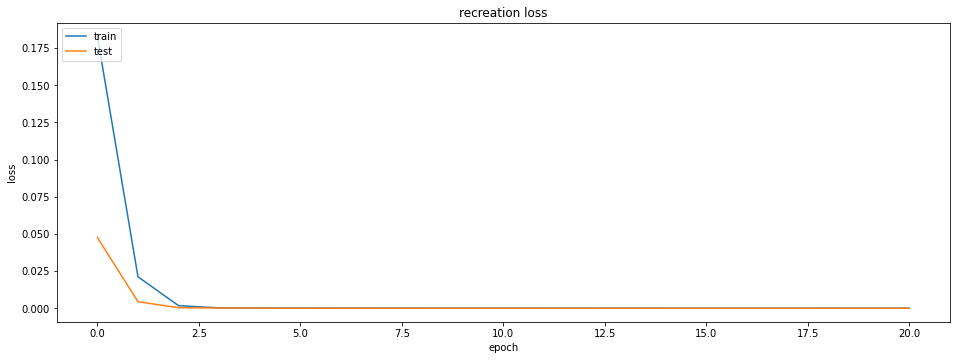

Intlier max value: 7.01328e-05 Index Val: 747
outlier max value: 5.802089e-05 Index Val: 9
outlier min value: 7.983899e-06 Index Val: 7


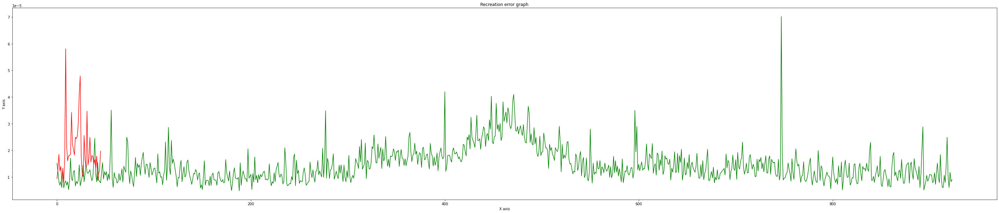

Total member in inlear: 924
Total False alarm: 845
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.99      0.09      0.16       924
           1       0.05      0.98      0.10        46

    accuracy                           0.13       970
   macro avg       0.52      0.53      0.13       970
weighted avg       0.94      0.13      0.15       970



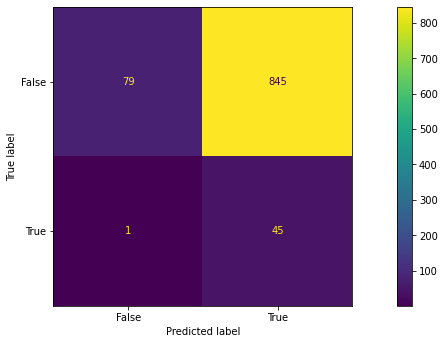

Epoch 1/200
24/24 [==============================] - 4s 145ms/step - loss: 0.1996 - val_loss: 0.0728
Epoch 2/200
24/24 [==============================] - 3s 136ms/step - loss: 0.0447 - val_loss: 0.0149
Epoch 3/200
24/24 [==============================] - 3s 138ms/step - loss: 0.0061 - val_loss: 0.0015
Epoch 4/200
24/24 [==============================] - 3s 137ms/step - loss: 6.6798e-04 - val_loss: 2.4652e-04
Epoch 5/200
24/24 [==============================] - 3s 135ms/step - loss: 1.5777e-04 - val_loss: 9.2162e-05
Epoch 6/200
24/24 [==============================] - 3s 140ms/step - loss: 7.9280e-05 - val_loss: 6.3420e-05
Epoch 7/200
24/24 [==============================] - 3s 134ms/step - loss: 5.8547e-05 - val_loss: 5.3615e-05
Epoch 8/200
24/24 [==============================] - 3s 138ms/step - loss: 4.5911e-05 - val_loss: 5.0680e-05
Epoch 9/200
24/24 [==============================] - 3s 138ms/step - loss: 3.8401e-05 - val_loss: 3.6141e-05
Epoch 10/200
24/24 [=======================

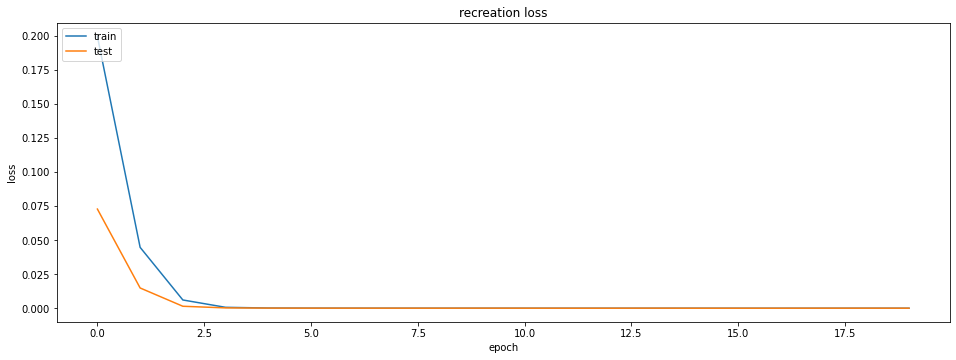

Intlier max value: 9.352725e-05 Index Val: 918
outlier max value: 8.891764e-05 Index Val: 9
outlier min value: 2.3676304e-05 Index Val: 27


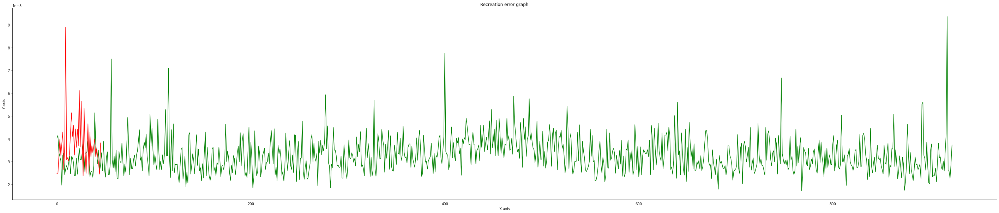

Total member in inlear: 924
Total False alarm: 846
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.99      0.08      0.16       924
           1       0.05      0.98      0.10        46

    accuracy                           0.13       970
   macro avg       0.52      0.53      0.13       970
weighted avg       0.94      0.13      0.15       970



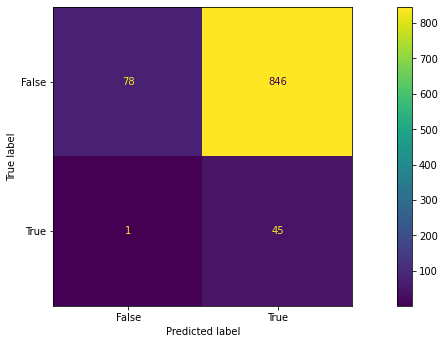

Epoch 1/200
24/24 [==============================] - 5s 148ms/step - loss: 0.2377 - val_loss: 0.0953
Epoch 2/200
24/24 [==============================] - 3s 136ms/step - loss: 0.0473 - val_loss: 0.0151
Epoch 3/200
24/24 [==============================] - 3s 137ms/step - loss: 0.0052 - val_loss: 8.7856e-04
Epoch 4/200
24/24 [==============================] - 3s 139ms/step - loss: 4.2606e-04 - val_loss: 1.9675e-04
Epoch 5/200
24/24 [==============================] - 3s 137ms/step - loss: 1.5274e-04 - val_loss: 1.1202e-04
Epoch 6/200
24/24 [==============================] - 3s 136ms/step - loss: 9.3847e-05 - val_loss: 8.4378e-05
Epoch 7/200
24/24 [==============================] - 3s 141ms/step - loss: 6.9296e-05 - val_loss: 8.9244e-05
Epoch 8/200
24/24 [==============================] - 3s 138ms/step - loss: 5.8227e-05 - val_loss: 5.1930e-05
Epoch 9/200
24/24 [==============================] - 3s 144ms/step - loss: 4.6190e-05 - val_loss: 5.3012e-05
Epoch 10/200
24/24 [===================

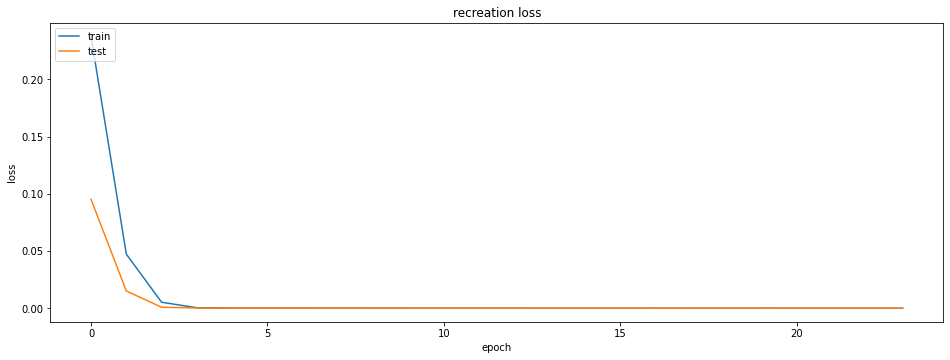

Intlier max value: 7.783406e-05 Index Val: 56
outlier max value: 8.014224e-05 Index Val: 9
outlier min value: 8.204715e-06 Index Val: 12


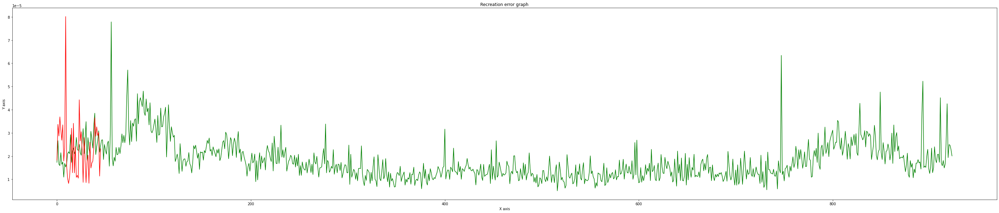

Total member in inlear: 924
Total False alarm: 885
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.97      0.04      0.08       924
           1       0.05      0.98      0.09        46

    accuracy                           0.09       970
   macro avg       0.51      0.51      0.09       970
weighted avg       0.93      0.09      0.08       970



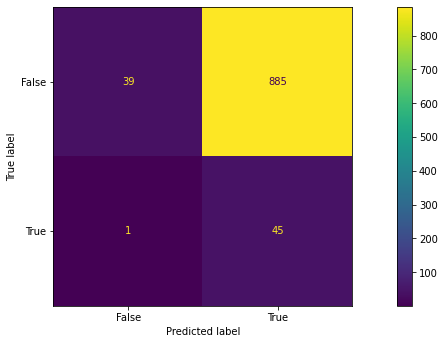

Epoch 1/200
24/24 [==============================] - 4s 148ms/step - loss: 0.1374 - val_loss: 0.0275
Epoch 2/200
24/24 [==============================] - 3s 140ms/step - loss: 0.0117 - val_loss: 0.0028
Epoch 3/200
24/24 [==============================] - 3s 131ms/step - loss: 0.0012 - val_loss: 4.1091e-04
Epoch 4/200
24/24 [==============================] - 3s 138ms/step - loss: 2.5670e-04 - val_loss: 1.6040e-04
Epoch 5/200
24/24 [==============================] - 3s 136ms/step - loss: 1.2050e-04 - val_loss: 1.0185e-04
Epoch 6/200
24/24 [==============================] - 3s 138ms/step - loss: 7.8120e-05 - val_loss: 6.7771e-05
Epoch 7/200
24/24 [==============================] - 3s 136ms/step - loss: 5.6684e-05 - val_loss: 6.4209e-05
Epoch 8/200
24/24 [==============================] - 3s 135ms/step - loss: 4.7706e-05 - val_loss: 5.7242e-05
Epoch 9/200
24/24 [==============================] - 3s 138ms/step - loss: 4.1196e-05 - val_loss: 3.8910e-05
Epoch 10/200
24/24 [===================

In [ ]:
# Hyper Parameter input:
b1 = 10 # window size
n = 8 # No. of features
e = 200
# Load Raw Data for CNN-AE
T,mf = rawDataload_TWF_win()
# Create test and training sets
XT,YT,XTs,YTs = TrainTestData(b1,T,mf)
# amplify the diffrences 
amp = 1
trn = np.power(XT, amp)
tst = np.power(XTs, amp)

# nomalize by dividing max value of train matrix
max_value = np.max(trn,axis = 0)
print(max_value)
trainN = (trn/max_value)
testN = (tst/max_value)
# Convert data into windows
Tr_w = TS_window(b1,n,trainN) # Numpy windows output of Inliear data
Ts_w = TS_window(b1,n,testN) # Numpy windows output of Outlier data
# Generate and train the model
train_2 = Tr_w.reshape(Tr_w.shape[0],Tr_w.shape[1],Tr_w.shape[2],1)
# Input for  looping:
trecall_max = 0.0
frecall_max = 0.0
count = 0
from google.colab import drive
drive.mount('/content/gdrive')
m1_path = '/content/gdrive/MyDrive/Outlier_model/cnn_m2_undercomplete'
while count < 5:
  m1,history = m2_2dcnnae_single_conv(train_2,e)
  MODEL1 = m1
  X_test_2 = Ts_w.reshape(Ts_w.shape[0],Ts_w.shape[1],Ts_w.shape[2],1)
  # Output analysis
  ## Plot the model training and validation 
  print("Loss",list(history.history['loss'])[-1],"Validation Loss:",list(history.history['val_loss'])[-1])
  plt_model_accuracy(history)
  inlier_lst,outlier_lst = model_analysis(train_2,X_test_2,MODEL1)
  #outlier cut-off point:
  oc = min(outlier_lst)
  oc = oc+oc*(1/100)
  mat1 = confusionMatrix(oc,inlier_lst,outlier_lst)
  trecall = mat1['0']['recall']
  frecall = mat1['1']['recall']
  if trecall_max <= trecall and frecall_max <= frecall:
    trecall_max = trecall
    frecall_max = frecall
    count+=1
    print("trecall_max:",trecall_max,'frecall_max:',frecall_max, 'Count:',count)
    m1.save(m1_path)
    if count == 5:
      break

## Tool Wear failure(TWF) machine failure analysis usning OvereComplete CNN-AE over snaphot of data

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4913: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


[ 304.5  313.8 2695.    70.   246.     1.     1.     1. ]
Mounted at /content/gdrive
Loss 0.002739968942478299 Validation Loss: 0.0027457447722554207
dict_keys(['loss', 'val_loss'])


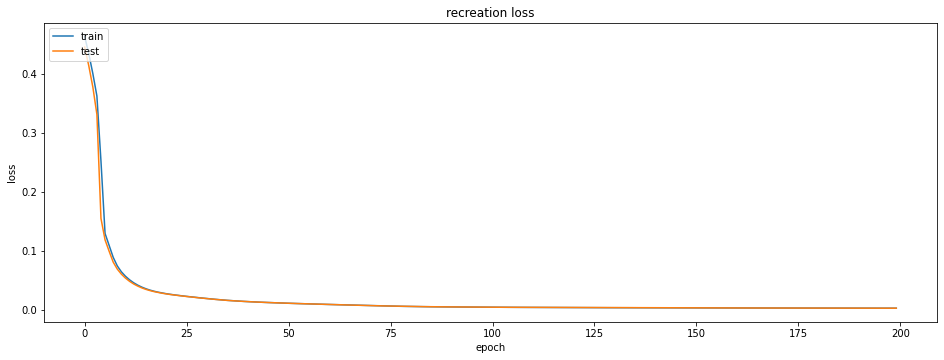

Intlier max value: 0.009821094 Index Val: 30
outlier max value: 0.010013403 Index Val: 41
outlier min value: 0.0014658826 Index Val: 31


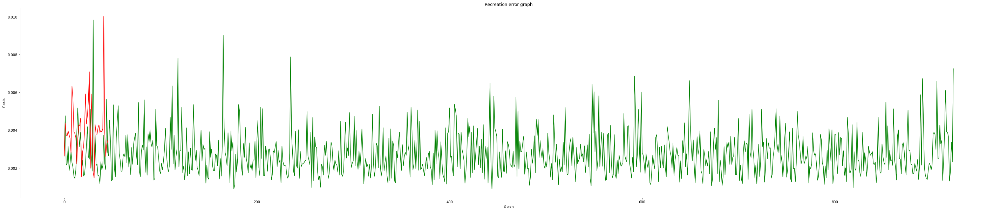

Total member in inlear: 924
Total False alarm: 840
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.99      0.09      0.17       924
           1       0.05      0.98      0.10        46

    accuracy                           0.13       970
   macro avg       0.52      0.53      0.13       970
weighted avg       0.94      0.13      0.16       970



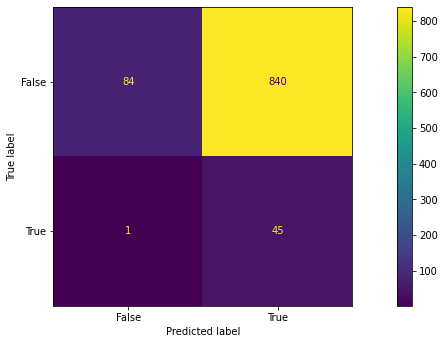

trecall_max: 0.09090909090909091 frecall_max: 0.9782608695652174 Count: 1


INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Outlier_model/cnn_m1/assets


INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Outlier_model/cnn_m1/assets


Loss 0.003513052361086011 Validation Loss: 0.0035936571657657623
dict_keys(['loss', 'val_loss'])


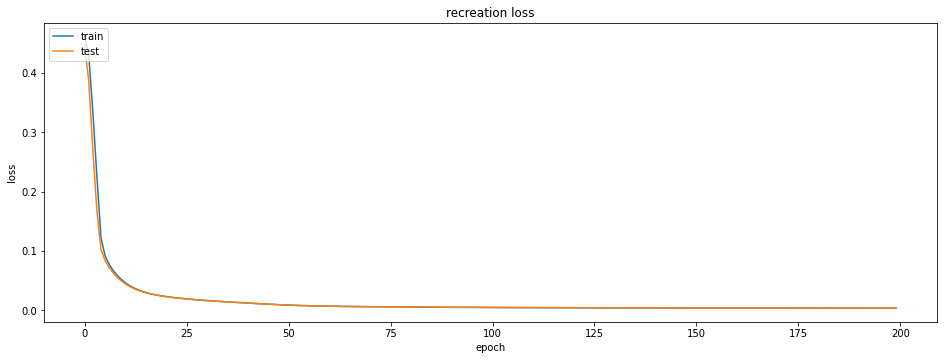

Intlier max value: 0.009594495 Index Val: 889
outlier max value: 0.007820291 Index Val: 43
outlier min value: 0.0010501696 Index Val: 7


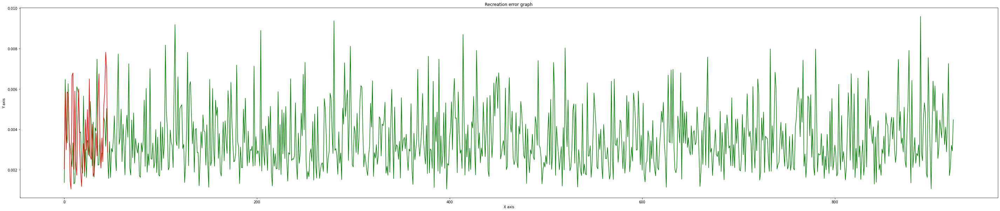

Total member in inlear: 924
Total False alarm: 923
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.50      0.00      0.00       924
           1       0.05      0.98      0.09        46

    accuracy                           0.05       970
   macro avg       0.27      0.49      0.05       970
weighted avg       0.48      0.05      0.01       970



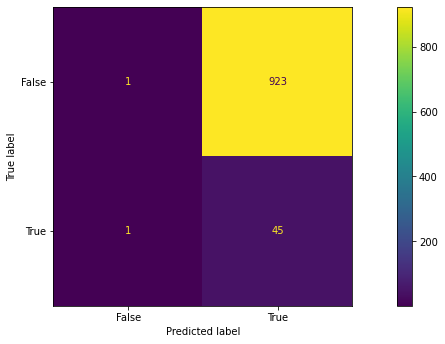

Loss 0.0031769382767379284 Validation Loss: 0.003300613956525922
dict_keys(['loss', 'val_loss'])


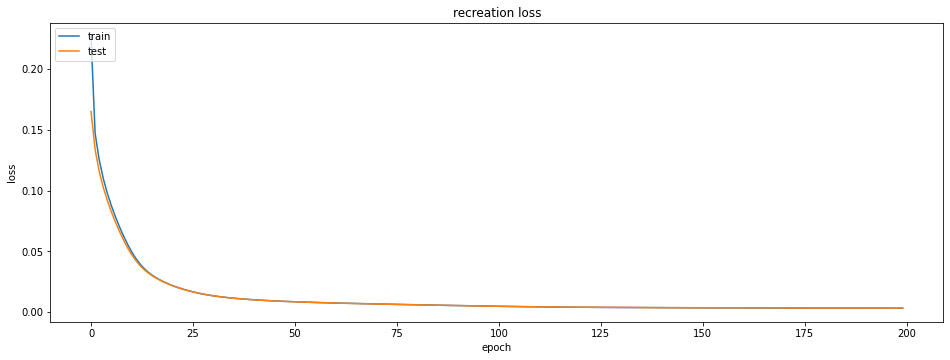

Intlier max value: 0.007595203 Index Val: 715
outlier max value: 0.0059830165 Index Val: 15
outlier min value: 0.0012132186 Index Val: 13


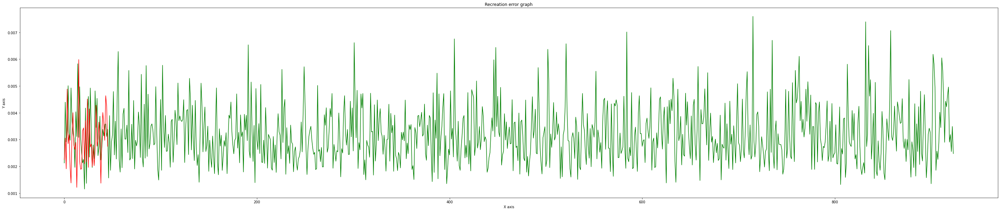

Total member in inlear: 924
Total False alarm: 923
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.50      0.00      0.00       924
           1       0.05      0.98      0.09        46

    accuracy                           0.05       970
   macro avg       0.27      0.49      0.05       970
weighted avg       0.48      0.05      0.01       970



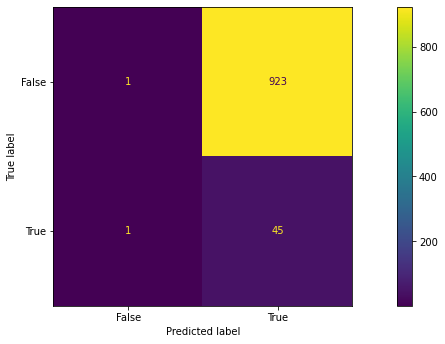

Loss 0.00011272939445916563 Validation Loss: 0.00010840217146323994
dict_keys(['loss', 'val_loss'])


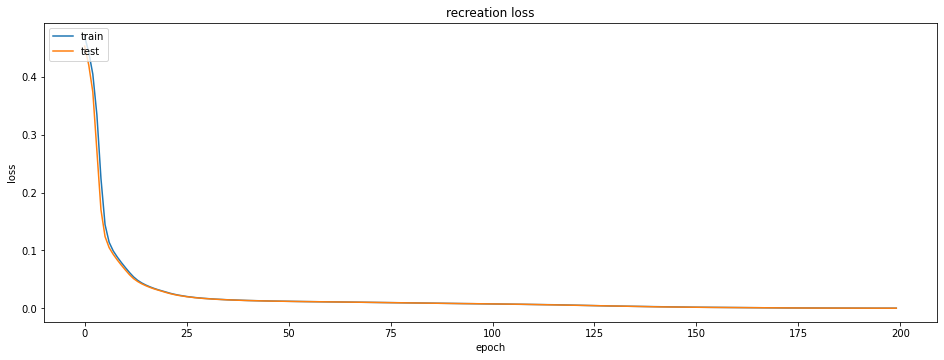

Intlier max value: 0.00022776352 Index Val: 550
outlier max value: 0.00022927304 Index Val: 28
outlier min value: 9.802296e-05 Index Val: 18


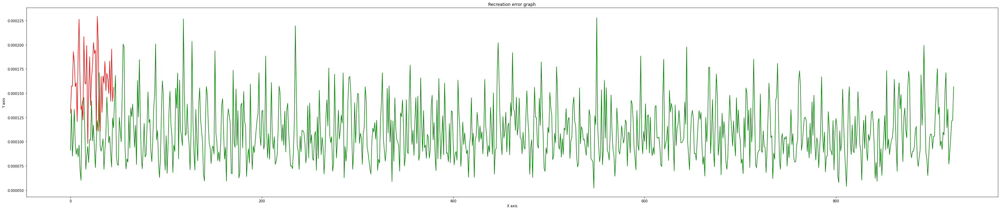

Total member in inlear: 924
Total False alarm: 538
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       1.00      0.42      0.59       924
           1       0.08      0.98      0.14        46

    accuracy                           0.44       970
   macro avg       0.54      0.70      0.37       970
weighted avg       0.95      0.44      0.57       970



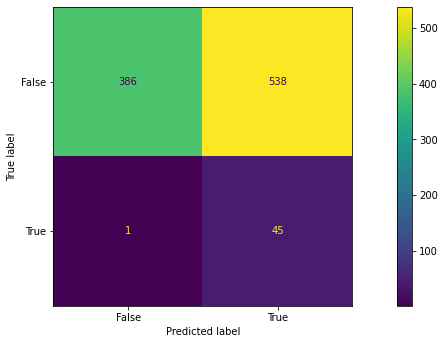

trecall_max: 0.41774891774891776 frecall_max: 0.9782608695652174 Count: 2


INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Outlier_model/cnn_m1/assets


INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Outlier_model/cnn_m1/assets


Loss 0.003876230213791132 Validation Loss: 0.004032366443425417
dict_keys(['loss', 'val_loss'])


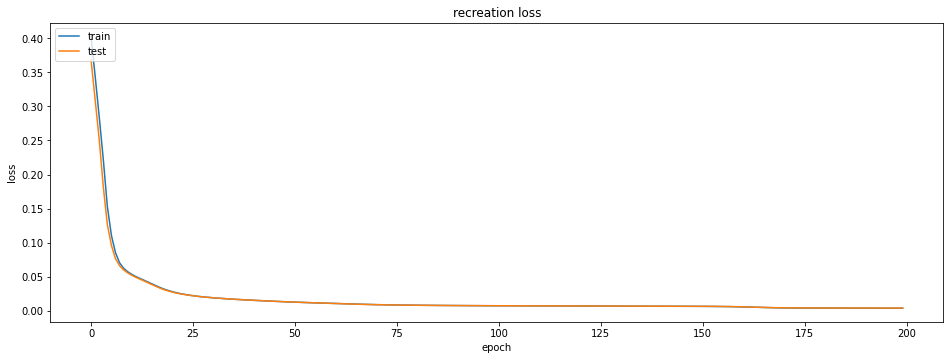

Intlier max value: 0.008928221 Index Val: 668
outlier max value: 0.006171253 Index Val: 24
outlier min value: 0.0020759646 Index Val: 18


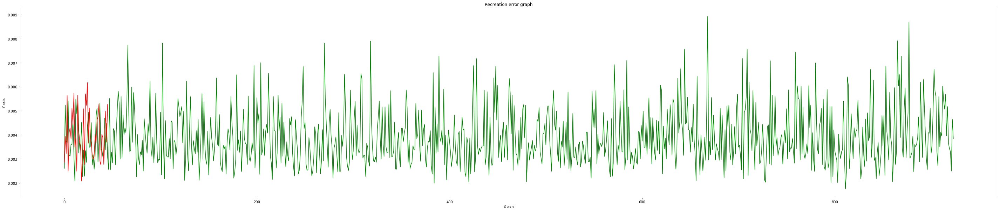

Total member in inlear: 924
Total False alarm: 915
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.90      0.01      0.02       924
           1       0.05      0.98      0.09        46

    accuracy                           0.06       970
   macro avg       0.47      0.49      0.05       970
weighted avg       0.86      0.06      0.02       970



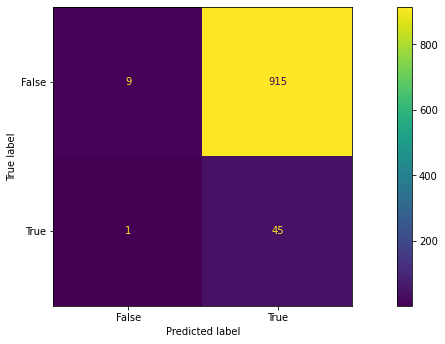

Loss 1.7867039787233807e-05 Validation Loss: 1.7760890841600485e-05
dict_keys(['loss', 'val_loss'])


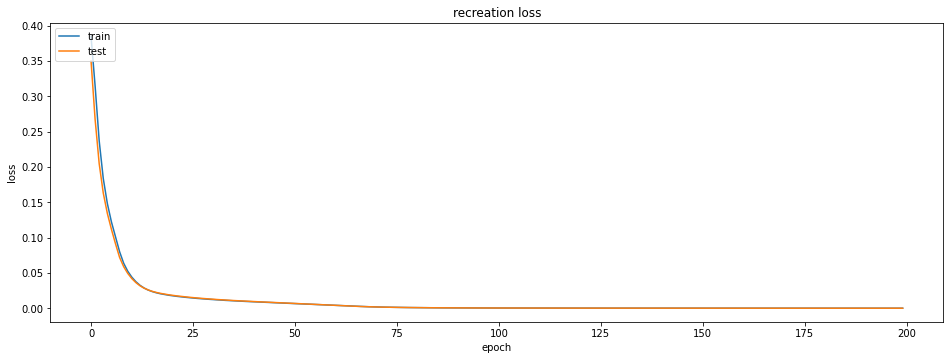

Intlier max value: 4.8936945e-05 Index Val: 118
outlier max value: 4.0603194e-05 Index Val: 28
outlier min value: 6.944323e-06 Index Val: 18


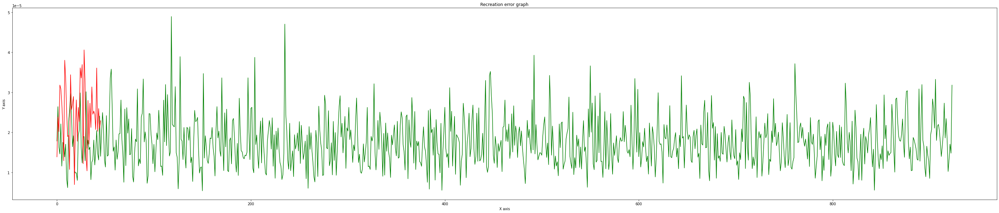

Total member in inlear: 924
Total False alarm: 915
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.90      0.01      0.02       924
           1       0.05      0.98      0.09        46

    accuracy                           0.06       970
   macro avg       0.47      0.49      0.05       970
weighted avg       0.86      0.06      0.02       970



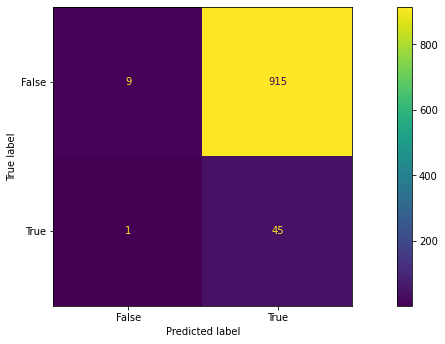

Loss 0.0018752921605482697 Validation Loss: 0.0017983607249334455
dict_keys(['loss', 'val_loss'])


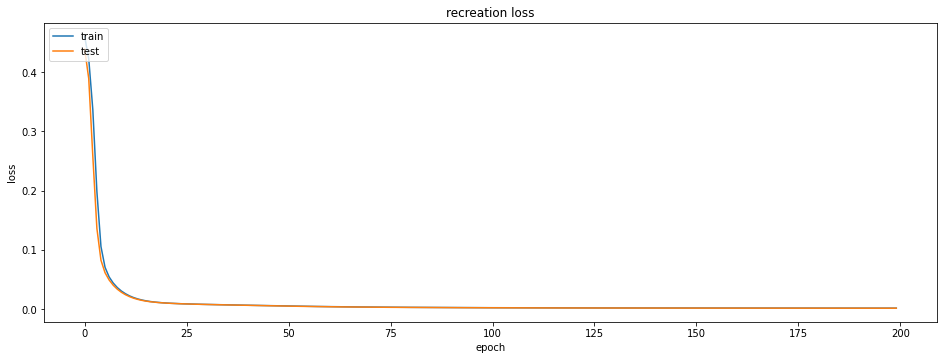

Intlier max value: 0.0053547826 Index Val: 668
outlier max value: 0.0041017556 Index Val: 4
outlier min value: 0.00087064866 Index Val: 18


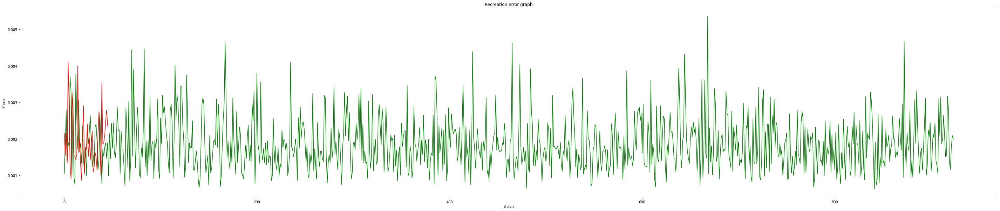

Total member in inlear: 924
Total False alarm: 890
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.97      0.04      0.07       924
           1       0.05      0.98      0.09        46

    accuracy                           0.08       970
   macro avg       0.51      0.51      0.08       970
weighted avg       0.93      0.08      0.07       970



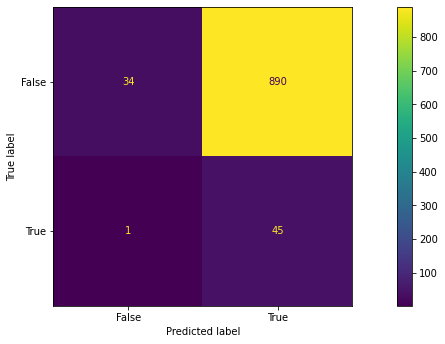

Loss 0.0012716995552182198 Validation Loss: 0.0013593476032838225
dict_keys(['loss', 'val_loss'])


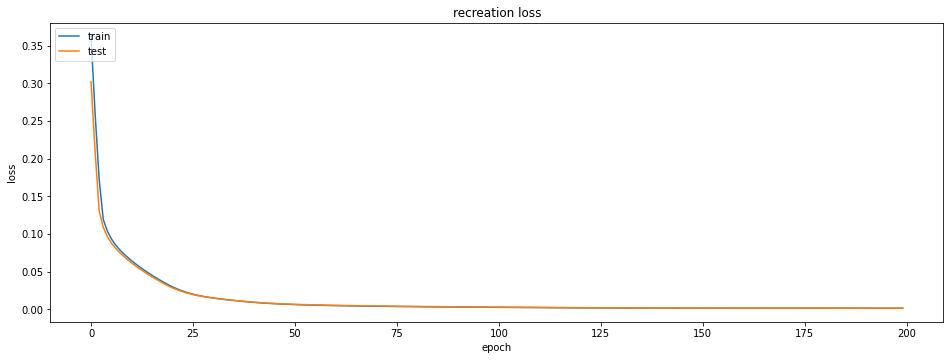

Intlier max value: 0.0039022253 Index Val: 780
outlier max value: 0.0030961982 Index Val: 8
outlier min value: 0.0004307446 Index Val: 7


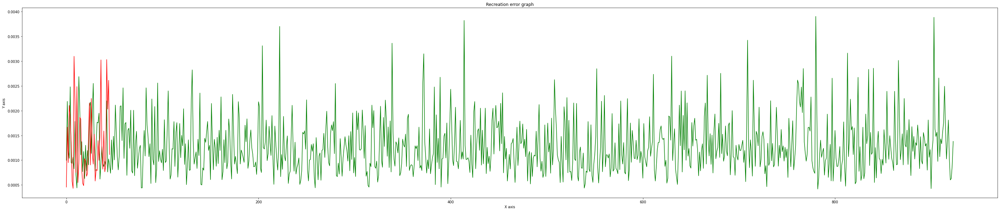

Total member in inlear: 924
Total False alarm: 922
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.67      0.00      0.00       924
           1       0.05      0.98      0.09        46

    accuracy                           0.05       970
   macro avg       0.36      0.49      0.05       970
weighted avg       0.64      0.05      0.01       970



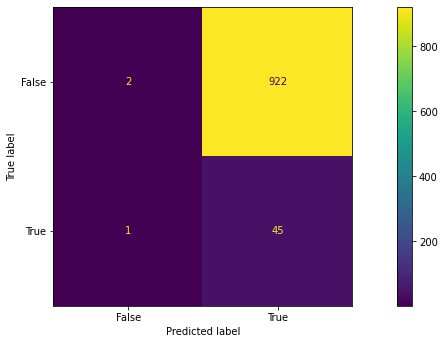

Loss 0.003682428505271673 Validation Loss: 0.003753653494641185
dict_keys(['loss', 'val_loss'])


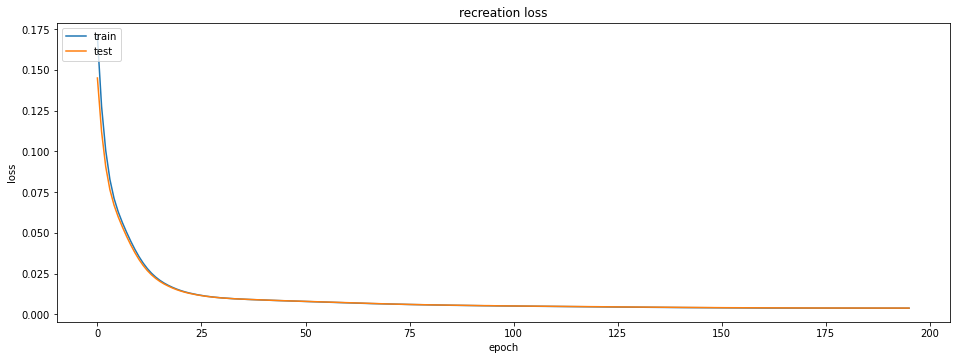

Intlier max value: 0.0072936253 Index Val: 586
outlier max value: 0.0072977245 Index Val: 8
outlier min value: 0.0018283591 Index Val: 18


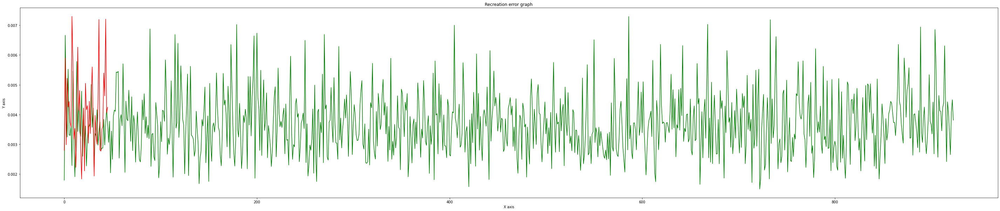

Total member in inlear: 924
Total False alarm: 910
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.93      0.02      0.03       924
           1       0.05      0.98      0.09        46

    accuracy                           0.06       970
   macro avg       0.49      0.50      0.06       970
weighted avg       0.89      0.06      0.03       970



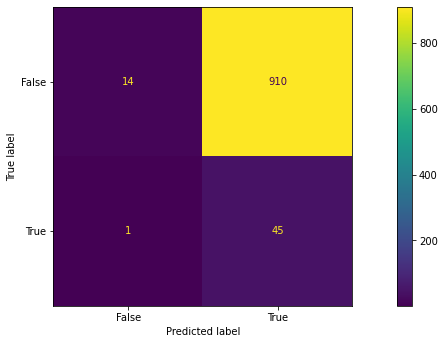

Loss 0.0011959545081481338 Validation Loss: 0.001407321193255484
dict_keys(['loss', 'val_loss'])


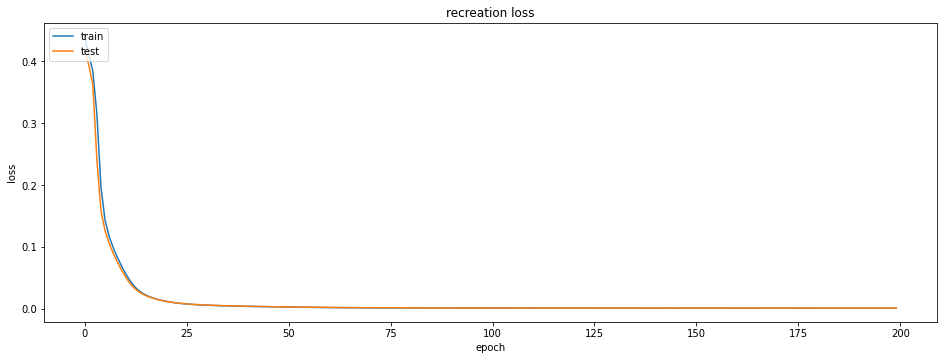

Intlier max value: 0.0065621426 Index Val: 903
outlier max value: 0.004083944 Index Val: 24
outlier min value: 0.00032272027 Index Val: 18


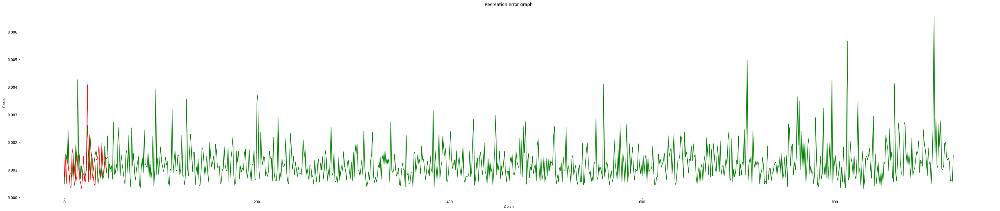

Total member in inlear: 924
Total False alarm: 923
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.50      0.00      0.00       924
           1       0.05      0.98      0.09        46

    accuracy                           0.05       970
   macro avg       0.27      0.49      0.05       970
weighted avg       0.48      0.05      0.01       970



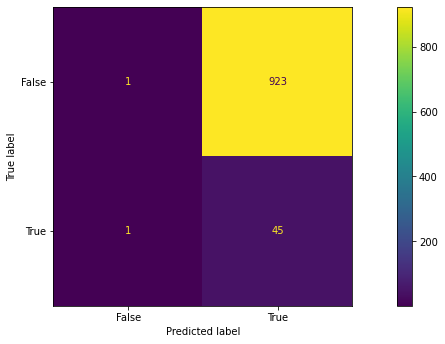

Loss 0.005354869179427624 Validation Loss: 0.005370499566197395
dict_keys(['loss', 'val_loss'])


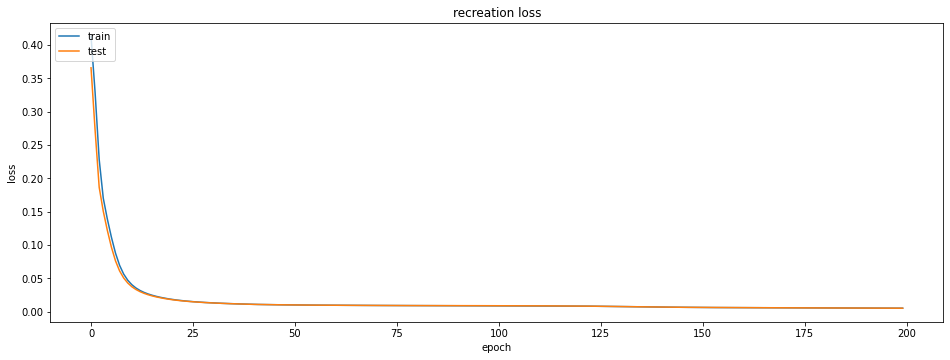

Intlier max value: 0.01170216 Index Val: 197
outlier max value: 0.008789226 Index Val: 9
outlier min value: 0.0027388553 Index Val: 18


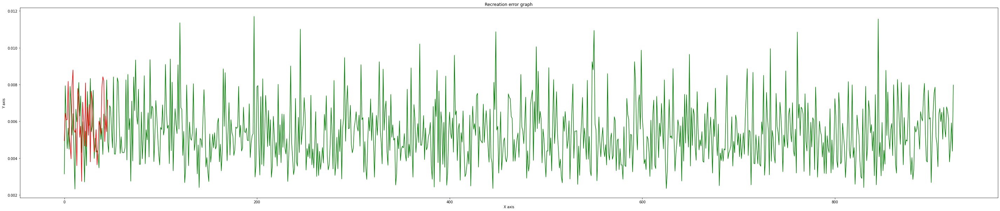

Total member in inlear: 924
Total False alarm: 901
Total member in Outlier: 46
Total missed true alarm: 1
              precision    recall  f1-score   support

           0       0.96      0.02      0.05       924
           1       0.05      0.98      0.09        46

    accuracy                           0.07       970
   macro avg       0.50      0.50      0.07       970
weighted avg       0.92      0.07      0.05       970



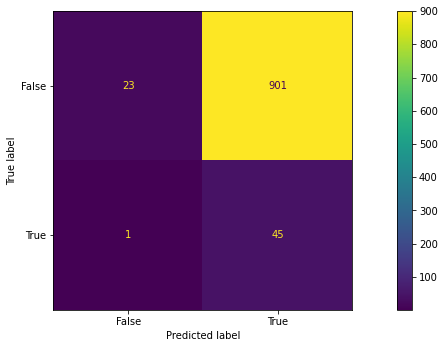

KeyboardInterrupt: ignored

In [ ]:
# Hyper Parameter input:
b1 = 10 # window size
n = 8 # No. of features
e = 200
# Load Raw Data for LSTM
T,mf = rawDataload_TWF_win()
# Create test and training sets
XT,YT,XTs,YTs = TrainTestData(b1,T,mf)
# amplify the diffrences 
amp = 1
trn = np.power(XT, amp)
tst = np.power(XTs, amp)

# nomalize by dividing max value of train matrix
max_value = np.max(trn,axis = 0)
print(max_value)
trainN = (trn/max_value)
testN = (tst/max_value)
# Convert data into windows
Tr_w = TS_window(b1,n,trainN) # Numpy windows output of Inliear data
Ts_w = TS_window(b1,n,testN) # Numpy windows output of Outlier data
# Generate and train the model
train_2 = Tr_w.reshape(Tr_w.shape[0],Tr_w.shape[1],Tr_w.shape[2],1)
# Input for  looping:
trecall_max = 0.0
frecall_max = 0.0
count = 0
from google.colab import drive
drive.mount('/content/gdrive')
m1_path = '/content/gdrive/MyDrive/Outlier_model/cnn_m1'
while count < 5:
  m1,history = m3_2dcnnae_single_conv(train_2,e)
  MODEL1 = m1
  X_test_2 = Ts_w.reshape(Ts_w.shape[0],Ts_w.shape[1],Ts_w.shape[2],1)
  # Output analysis
  ## Plot the model training and validation 
  print("Loss",list(history.history['loss'])[-1],"Validation Loss:",list(history.history['val_loss'])[-1])
  plt_model_accuracy(history)
  inlier_lst,outlier_lst = model_analysis(train_2,X_test_2,MODEL1)
  #outlier cut-off point:
  oc = min(outlier_lst)
  oc = oc+oc*(1/100)
  mat1 = confusionMatrix(oc,inlier_lst,outlier_lst)
  trecall = mat1['0']['recall']
  frecall = mat1['1']['recall']
  if trecall_max <= trecall and frecall_max <= frecall:
    trecall_max = trecall
    frecall_max = frecall
    count+=1
    print("trecall_max:",trecall_max,'frecall_max:',frecall_max, 'Count:',count)
    m1.save(m1_path)
    if count == 5:
      break


/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4913: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


[2.823e+07 3.090e+07 1.957e+10 3.430e+05 1.489e+07 1.000e+00 1.000e+00
 1.000e+00]
Mounted at /content/gdrive
Intlier max value: 0.4319643 Index Val: 892
outlier max value: 0.47705 Index Val: 23
outlier min value: 0.38128394 Index Val: 5


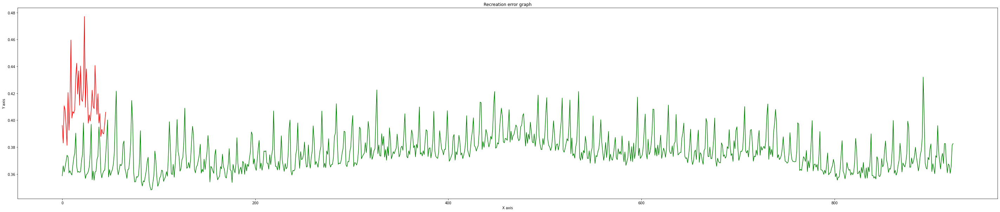

Total member in inlear: 924
Total False alarm: 185
Total member in Outlier: 46
Total missed true alarm: 2
              precision    recall  f1-score   support

           0       1.00      0.80      0.89       924
           1       0.19      0.96      0.32        46

    accuracy                           0.81       970
   macro avg       0.59      0.88      0.60       970
weighted avg       0.96      0.81      0.86       970



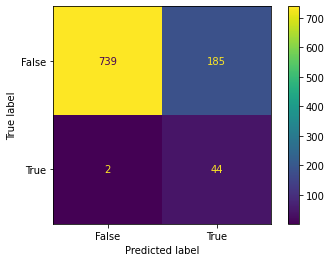

In [ ]:
# Hyper Parameter input:
b1 = 10 # window size
n = 8 # No. of features
e = 200
# Load Raw Data for LSTM
T,mf = rawDataload_TWF_win()
# Create test and training sets
XT,YT,XTs,YTs = TrainTestData(b1,T,mf)
# amplify the diffrences 
amp = 3
trn = np.power(XT, amp)
tst = np.power(XTs, amp)

# nomalize by dividing max value of train matrix
max_value = np.max(trn,axis = 0)
print(max_value)
trainN = (trn/max_value)
testN = (tst/max_value)
# Convert data into windows
Tr_w = TS_window(b1,n,trainN) # Numpy windows output of Inliear data
Ts_w = TS_window(b1,n,testN) # Numpy windows output of Outlier data
# Generate and train the model
train_2 = Tr_w.reshape(Tr_w.shape[0],Tr_w.shape[1],Tr_w.shape[2],1)
X_test_2 = Ts_w.reshape(Ts_w.shape[0],Ts_w.shape[1],Ts_w.shape[2],1)
# Input for  looping:
trecall_max = 0.0
frecall_max = 0.0
count = 0
#mat1 = confusionMatrix(oc,inlier_lst,outlier_lst)
# Load the saved model
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)
m1_path = '/content/gdrive/MyDrive/Outlier_model/cnn_m1' 
m2 = tf.keras.models.load_model(m1_path)
MODEL1 = m2
# Output analysis
## Plot the model training and validation 
#print("Loss",list(history.history['loss'])[-1],"Validation Loss:",list(history.history['val_loss'])[-1])
#plt_model_accuracy(history)
inlier_lst,outlier_lst = model_analysis(train_2,X_test_2,MODEL1)
#outlier cut-off point:
oc = min(outlier_lst)
oc = oc+oc*(1/100)
mat1 = confusionMatrix(oc,inlier_lst,outlier_lst)

In [ ]:
# Hyper Parameter input:
b1 = 10 # window size
n = 8 # No. of features
e = 200
# Load Raw Data for LSTM
T,mf = rawDataload_TWF_win()
# Create test and training sets
XT,YT,XTs,YTs = TrainTestData(b1,T,mf)
# amplify the diffrences 
amp = 1
trn = np.power(XT, amp)
tst = np.power(XTs, amp)

# nomalize by dividing max value of train matrix
max_value = np.max(trn,axis = 0)
print(max_value)
trainN = (trn/max_value)
testN = (tst/max_value)
# Convert data into windows
Tr_w = TS_window(b1,n,trainN) # Numpy windows output of Inliear data
Ts_w = TS_window(b1,n,testN) # Numpy windows output of Outlier data

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4913: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


[ 304.5  313.8 2695.    70.   246.     1.     1.     1. ]


In [ ]:
print("Shape of Outlier Data:",Ts_w.shape)
print("First Outlier record:\n",Ts_w[0])

Shape of Outlier Data: (46, 10, 8)
First Outlier record:
 [[0.981 0.984 0.544 0.63  0.748 1.    0.    0.   ]
 [0.981 0.984 0.567 0.463 0.768 0.    1.    0.   ]
 [0.982 0.985 0.714 0.323 0.785 0.    0.    1.   ]
 [0.982 0.985 0.539 0.65  0.797 0.    1.    0.   ]
 [0.982 0.985 0.508 0.634 0.805 0.    1.    0.   ]
 [0.982 0.985 0.591 0.5   0.813 0.    1.    0.   ]
 [0.982 0.985 0.594 0.461 0.821 0.    1.    0.   ]
 [0.981 0.984 0.512 0.667 0.829 0.    1.    0.   ]
 [0.981 0.984 0.542 0.684 0.837 0.    1.    0.   ]
 [0.981 0.984 0.54  0.59  0.846 0.    1.    0.   ]]
